# Week 4 handin

## Assignment

## Status
Jeg har nået at lave alle opgaverne til Exercise 1.

## Exercises

Use only numpy (not pandas) in these exercises
#### Exercise 1
1. Open the file './data/befkbhalderstatkode.csv'
2. Turn the csv file into a numpy ndarray with `np.genfromtxt(filename, delimiter=',', dtype=np.uint, skip_header=1)`
3. Using this data:
```python
neighb = {1: 'Indre By', 2: 'Østerbro', 3: 'Nørrebro', 4: 'Vesterbro/Kgs. Enghave', 
          5: 'Valby', 6: 'Vanløse', 7: 'Brønshøj-Husum', 8: 'Bispebjerg', 9: 'Amager Øst', 
          10: 'Amager Vest', 99: 'Udenfor'}
```
Find out how many people lived in each of the 11 areas in 2015
4. Make a bar plot to show the size of each city area from the smallest to the largest
5. Create a boolean mask to find out how many people above 65 years lived in Copenhagen in 2015
6. How many of those were from the other nordic countries (not dk)
7. Make a line plot showing the changes of number of people in vesterbro and østerbro from 1992 to 2015

#### Exercise 2  A bit harder (Extra only if you have the time)

1. From "Danmarks Statistik" download demographic data here:
https://api.statbank.dk/v1/data/FOLK1A/CSV?valuePresentation=Code&delimiter=Semicolon&OMR%C3%85DE=000%2C084%2C147%2C400%2C085%2C083%2C082%2C081%2C851%2C461%2C561%2C751&K%C3%98N=1%2C2&ALDER=0%2C1%2C2%2C3%2C4%2C5%2C6%2C7%2C8%2C9%2C10%2C11%2C12%2C13%2C14%2C15%2C16%2C17%2C18%2C19%2C20%2C21%2C22%2C23%2C24%2C25%2C26%2C27%2C28%2C29%2C30%2C31%2C32%2C33%2C34%2C35%2C36%2C37%2C3%2C39%2C40%2C41%2C42%2C43%2C44%2C45%2C46%2C47%2C48%2C49%2C50%2C51%2C52%2C53%2C54%2C55%2C56%2C57%2C58%2C59%2C60%2C61%2C62%2C63%2C64%2C65%2C66%2C67%2C68%2C69%2C70%2C71%2C72%2C73%2C74%2C75%2C76%2C77%2C78%2C79%2C80%2C81%2C82%2C83%2C84%2C85%2C86%2C87%2C88%2C89%2C90%2C91%2C92%2C93%2C94%2C95%2C96%2C97%2C98%2C99%2C100&Tid=2008K1%2C2009K1%2C2010K1%2C2011K1%2C2012K1%2C2013K1%2C2014K1%2C2015K1%2C2016K1%2C2017K1%2C2018K1%2C2019K1%2C2020K1


2. clean up the data so it only contains numbers. (If you find this hard to do then Pandas can help (we will cover it next week)
```python
import pandas as pd 
url = 'url from above here'
df = pd.read_csv(url,sep=';')
df['TID'] = df['TID'].map(lambda x:x[:-2]) #cut the last 2 characters
df.to_csv('demografic_cleaned.csv',header=False, index=False)
```
Now you have csv data with columns: OMRÅDE;KØN;ALDER;TID;INDHOLD
3. Now load your demographic data with numpy. (Hint: use np.loadtxt() with dtype and delimiter).
4. Use file: BY_KODER_demographics.csv to get cities from the city codes
5. Now find out which city in 2020 has the highest percentage of men (gender code 1),(Hint: create a function to return summed up data by city code ala: def summed_by_city(city_code): returning pct_male 
6. Create a line chart with 5 lines showing population changes in the 5 largest cities from 2008 to 2020


## Exercise 1

In [36]:
# Ex 1.1 Open the file './data/befkbhalderstatkode.csv'
import csv 

filename = '../data/befkbhalderstatkode.csv'

def print_file_content(filename):
    with open(filename) as f:
        reader = csv.reader(f)
        for row in reader:
            print(row)
            
print_file_content(filename)

['AAR', 'BYDEL', 'ALDER', 'STATKODE', 'PERSONER']
['2015', '1', '0', '5100', '614']
['2015', '1', '0', '5104', '2']
['2015', '1', '0', '5106', '1']
['2015', '1', '0', '5110', '1']
['2015', '1', '0', '5120', '4']
['2015', '1', '0', '5126', '1']
['2015', '1', '0', '5130', '5']
['2015', '1', '0', '5140', '3']
['2015', '1', '0', '5150', '5']
['2015', '1', '0', '5154', '1']
['2015', '1', '0', '5164', '3']
['2015', '1', '0', '5170', '3']
['2015', '1', '0', '5180', '3']
['2015', '1', '0', '5228', '1']
['2015', '1', '0', '5306', '2']
['2015', '1', '0', '5390', '1']
['2015', '1', '0', '5448', '1']
['2015', '1', '0', '5464', '1']
['2015', '1', '0', '5472', '1']
['2015', '1', '0', '5502', '1']
['2015', '1', '0', '5704', '1']
['2015', '1', '0', '5752', '1']
['2015', '1', '1', '5100', '540']
['2015', '1', '1', '5104', '3']
['2015', '1', '1', '5106', '2']
['2015', '1', '1', '5110', '3']
['2015', '1', '1', '5120', '4']
['2015', '1', '1', '5130', '3']
['2015', '1', '1', '5140', '1']
['2015', '1', '1',

['2015', '2', '1', '5164', '5']
['2015', '2', '1', '5170', '11']
['2015', '2', '1', '5172', '1']
['2015', '2', '1', '5180', '5']
['2015', '2', '1', '5228', '1']
['2015', '2', '1', '5246', '1']
['2015', '2', '1', '5262', '1']
['2015', '2', '1', '5282', '1']
['2015', '2', '1', '5289', '2']
['2015', '2', '1', '5293', '1']
['2015', '2', '1', '5302', '1']
['2015', '2', '1', '5390', '4']
['2015', '2', '1', '5410', '1']
['2015', '2', '1', '5432', '12']
['2015', '2', '1', '5438', '1']
['2015', '2', '1', '5444', '1']
['2015', '2', '1', '5448', '2']
['2015', '2', '1', '5464', '1']
['2015', '2', '1', '5472', '4']
['2015', '2', '1', '5484', '1']
['2015', '2', '1', '5492', '1']
['2015', '2', '1', '5700', '1']
['2015', '2', '1', '5754', '1']
['2015', '2', '1', '5778', '1']
['2015', '2', '2', '5100', '844']
['2015', '2', '2', '5106', '2']
['2015', '2', '2', '5110', '3']
['2015', '2', '2', '5120', '6']
['2015', '2', '2', '5140', '4']
['2015', '2', '2', '5142', '1']
['2015', '2', '2', '5150', '3']
['20

['2015', '2', '45', '5246', '1']
['2015', '2', '45', '5289', '3']
['2015', '2', '45', '5302', '1']
['2015', '2', '45', '5305', '1']
['2015', '2', '45', '5306', '2']
['2015', '2', '45', '5314', '1']
['2015', '2', '45', '5324', '2']
['2015', '2', '45', '5354', '1']
['2015', '2', '45', '5366', '1']
['2015', '2', '45', '5390', '14']
['2015', '2', '45', '5404', '1']
['2015', '2', '45', '5432', '1']
['2015', '2', '45', '5436', '1']
['2015', '2', '45', '5442', '2']
['2015', '2', '45', '5448', '4']
['2015', '2', '45', '5456', '1']
['2015', '2', '45', '5472', '2']
['2015', '2', '45', '5474', '2']
['2015', '2', '45', '5492', '4']
['2015', '2', '45', '5514', '1']
['2015', '2', '45', '5607', '1']
['2015', '2', '45', '5700', '2']
['2015', '2', '45', '5704', '2']
['2015', '2', '45', '5754', '2']
['2015', '2', '45', '5756', '2']
['2015', '2', '45', '5757', '3']
['2015', '2', '46', '5100', '866']
['2015', '2', '46', '5104', '3']
['2015', '2', '46', '5106', '1']
['2015', '2', '46', '5110', '6']
['2015'

['2015', '3', '39', '5704', '1']
['2015', '3', '39', '5754', '2']
['2015', '3', '39', '5756', '6']
['2015', '3', '39', '5758', '1']
['2015', '3', '39', '5761', '1']
['2015', '3', '40', '5100', '871']
['2015', '3', '40', '5103', '8']
['2015', '3', '40', '5106', '2']
['2015', '3', '40', '5110', '5']
['2015', '3', '40', '5120', '14']
['2015', '3', '40', '5128', '2']
['2015', '3', '40', '5130', '3']
['2015', '3', '40', '5134', '1']
['2015', '3', '40', '5142', '2']
['2015', '3', '40', '5150', '4']
['2015', '3', '40', '5152', '3']
['2015', '3', '40', '5154', '10']
['2015', '3', '40', '5156', '2']
['2015', '3', '40', '5158', '6']
['2015', '3', '40', '5164', '8']
['2015', '3', '40', '5170', '9']
['2015', '3', '40', '5172', '16']
['2015', '3', '40', '5174', '3']
['2015', '3', '40', '5180', '6']
['2015', '3', '40', '5182', '2']
['2015', '3', '40', '5228', '4']
['2015', '3', '40', '5231', '1']
['2015', '3', '40', '5244', '6']
['2015', '3', '40', '5246', '1']
['2015', '3', '40', '5272', '1']
['201

['2015', '4', '34', '5170', '16']
['2015', '4', '34', '5172', '5']
['2015', '4', '34', '5174', '4']
['2015', '4', '34', '5180', '8']
['2015', '4', '34', '5182', '1']
['2015', '4', '34', '5202', '1']
['2015', '4', '34', '5214', '1']
['2015', '4', '34', '5228', '4']
['2015', '4', '34', '5232', '1']
['2015', '4', '34', '5234', '1']
['2015', '4', '34', '5244', '2']
['2015', '4', '34', '5262', '2']
['2015', '4', '34', '5268', '1']
['2015', '4', '34', '5272', '1']
['2015', '4', '34', '5289', '1']
['2015', '4', '34', '5293', '1']
['2015', '4', '34', '5302', '2']
['2015', '4', '34', '5305', '1']
['2015', '4', '34', '5306', '3']
['2015', '4', '34', '5314', '2']
['2015', '4', '34', '5316', '1']
['2015', '4', '34', '5324', '1']
['2015', '4', '34', '5354', '2']
['2015', '4', '34', '5366', '1']
['2015', '4', '34', '5390', '7']
['2015', '4', '34', '5424', '1']
['2015', '4', '34', '5432', '12']
['2015', '4', '34', '5438', '2']
['2015', '4', '34', '5444', '1']
['2015', '4', '34', '5446', '1']
['2015',

['2015', '5', '27', '5156', '3']
['2015', '5', '27', '5158', '10']
['2015', '5', '27', '5160', '1']
['2015', '5', '27', '5164', '5']
['2015', '5', '27', '5170', '7']
['2015', '5', '27', '5172', '5']
['2015', '5', '27', '5174', '2']
['2015', '5', '27', '5180', '10']
['2015', '5', '27', '5222', '1']
['2015', '5', '27', '5228', '1']
['2015', '5', '27', '5232', '1']
['2015', '5', '27', '5245', '1']
['2015', '5', '27', '5258', '1']
['2015', '5', '27', '5269', '1']
['2015', '5', '27', '5289', '2']
['2015', '5', '27', '5296', '1']
['2015', '5', '27', '5302', '1']
['2015', '5', '27', '5306', '2']
['2015', '5', '27', '5314', '1']
['2015', '5', '27', '5354', '2']
['2015', '5', '27', '5390', '3']
['2015', '5', '27', '5404', '1']
['2015', '5', '27', '5432', '9']
['2015', '5', '27', '5436', '2']
['2015', '5', '27', '5438', '3']
['2015', '5', '27', '5448', '10']
['2015', '5', '27', '5464', '10']
['2015', '5', '27', '5472', '7']
['2015', '5', '27', '5474', '4']
['2015', '5', '27', '5484', '1']
['2015

['2015', '6', '37', '5152', '1']
['2015', '6', '37', '5154', '3']
['2015', '6', '37', '5156', '1']
['2015', '6', '37', '5158', '3']
['2015', '6', '37', '5164', '4']
['2015', '6', '37', '5170', '6']
['2015', '6', '37', '5172', '4']
['2015', '6', '37', '5174', '1']
['2015', '6', '37', '5180', '4']
['2015', '6', '37', '5214', '1']
['2015', '6', '37', '5222', '1']
['2015', '6', '37', '5234', '1']
['2015', '6', '37', '5244', '3']
['2015', '6', '37', '5272', '1']
['2015', '6', '37', '5289', '1']
['2015', '6', '37', '5293', '1']
['2015', '6', '37', '5304', '1']
['2015', '6', '37', '5306', '2']
['2015', '6', '37', '5324', '1']
['2015', '6', '37', '5390', '2']
['2015', '6', '37', '5392', '1']
['2015', '6', '37', '5410', '2']
['2015', '6', '37', '5432', '4']
['2015', '6', '37', '5438', '1']
['2015', '6', '37', '5448', '3']
['2015', '6', '37', '5464', '1']
['2015', '6', '37', '5472', '3']
['2015', '6', '37', '5474', '1']
['2015', '6', '37', '5492', '4']
['2015', '6', '37', '5609', '1']
['2015', '

['2015', '7', '50', '5448', '2']
['2015', '7', '50', '5456', '2']
['2015', '7', '50', '5464', '1']
['2015', '7', '50', '5472', '7']
['2015', '7', '50', '5474', '3']
['2015', '7', '50', '5486', '1']
['2015', '7', '50', '5492', '1']
['2015', '7', '50', '5611', '1']
['2015', '7', '50', '5700', '2']
['2015', '7', '50', '5724', '1']
['2015', '7', '50', '5756', '7']
['2015', '7', '51', '5100', '486']
['2015', '7', '51', '5106', '3']
['2015', '7', '51', '5110', '1']
['2015', '7', '51', '5120', '3']
['2015', '7', '51', '5128', '3']
['2015', '7', '51', '5130', '1']
['2015', '7', '51', '5134', '1']
['2015', '7', '51', '5142', '1']
['2015', '7', '51', '5150', '1']
['2015', '7', '51', '5152', '14']
['2015', '7', '51', '5154', '3']
['2015', '7', '51', '5158', '1']
['2015', '7', '51', '5164', '1']
['2015', '7', '51', '5170', '6']
['2015', '7', '51', '5172', '3']
['2015', '7', '51', '5180', '3']
['2015', '7', '51', '5214', '1']
['2015', '7', '51', '5222', '2']
['2015', '7', '51', '5228', '1']
['2015'

['2015', '8', '45', '5214', '1']
['2015', '8', '45', '5222', '2']
['2015', '8', '45', '5244', '9']
['2015', '8', '45', '5268', '1']
['2015', '8', '45', '5282', '2']
['2015', '8', '45', '5289', '17']
['2015', '8', '45', '5306', '1']
['2015', '8', '45', '5316', '1']
['2015', '8', '45', '5324', '2']
['2015', '8', '45', '5366', '1']
['2015', '8', '45', '5390', '6']
['2015', '8', '45', '5392', '1']
['2015', '8', '45', '5404', '1']
['2015', '8', '45', '5410', '1']
['2015', '8', '45', '5432', '1']
['2015', '8', '45', '5436', '5']
['2015', '8', '45', '5438', '2']
['2015', '8', '45', '5442', '1']
['2015', '8', '45', '5446', '1']
['2015', '8', '45', '5448', '2']
['2015', '8', '45', '5456', '1']
['2015', '8', '45', '5472', '5']
['2015', '8', '45', '5474', '1']
['2015', '8', '45', '5492', '4']
['2015', '8', '45', '5607', '1']
['2015', '8', '45', '5611', '2']
['2015', '8', '45', '5700', '1']
['2015', '8', '45', '5750', '1']
['2015', '8', '45', '5754', '3']
['2015', '8', '45', '5756', '3']
['2015', 

['2015', '9', '64', '5756', '1']
['2015', '9', '65', '5100', '368']
['2015', '9', '65', '5104', '1']
['2015', '9', '65', '5110', '1']
['2015', '9', '65', '5120', '1']
['2015', '9', '65', '5128', '1']
['2015', '9', '65', '5130', '1']
['2015', '9', '65', '5170', '5']
['2015', '9', '65', '5172', '3']
['2015', '9', '65', '5180', '1']
['2015', '9', '65', '5182', '1']
['2015', '9', '65', '5289', '2']
['2015', '9', '65', '5390', '1']
['2015', '9', '65', '5444', '1']
['2015', '9', '65', '5474', '1']
['2015', '9', '65', '5776', '1']
['2015', '9', '66', '5100', '351']
['2015', '9', '66', '5104', '1']
['2015', '9', '66', '5106', '1']
['2015', '9', '66', '5110', '1']
['2015', '9', '66', '5120', '1']
['2015', '9', '66', '5134', '1']
['2015', '9', '66', '5154', '1']
['2015', '9', '66', '5164', '1']
['2015', '9', '66', '5170', '3']
['2015', '9', '66', '5172', '3']
['2015', '9', '66', '5180', '1']
['2015', '9', '66', '5376', '1']
['2015', '9', '66', '5390', '1']
['2015', '9', '66', '5472', '2']
['2015

['2015', '99', '23', '5464', '1']
['2015', '99', '23', '5484', '1']
['2015', '99', '23', '5607', '1']
['2015', '99', '23', '5609', '1']
['2015', '99', '23', '5611', '3']
['2015', '99', '23', '5776', '1']
['2015', '99', '23', '5778', '1']
['2015', '99', '24', '5100', '98']
['2015', '99', '24', '5103', '1']
['2015', '99', '24', '5104', '1']
['2015', '99', '24', '5110', '12']
['2015', '99', '24', '5120', '5']
['2015', '99', '24', '5128', '1']
['2015', '99', '24', '5130', '2']
['2015', '99', '24', '5134', '1']
['2015', '99', '24', '5140', '2']
['2015', '99', '24', '5150', '5']
['2015', '99', '24', '5152', '1']
['2015', '99', '24', '5154', '1']
['2015', '99', '24', '5156', '1']
['2015', '99', '24', '5164', '3']
['2015', '99', '24', '5170', '1']
['2015', '99', '24', '5172', '1']
['2015', '99', '24', '5180', '2']
['2015', '99', '24', '5182', '1']
['2015', '99', '24', '5235', '1']
['2015', '99', '24', '5269', '1']
['2015', '99', '24', '5289', '2']
['2015', '99', '24', '5314', '1']
['2015', '99

['2014', '1', '90', '5170', '1']
['2014', '1', '91', '5100', '31']
['2014', '1', '91', '5438', '2']
['2014', '1', '92', '5100', '43']
['2014', '1', '92', '5448', '1']
['2014', '1', '93', '5100', '25']
['2014', '1', '94', '5100', '22']
['2014', '1', '95', '5100', '20']
['2014', '1', '96', '5100', '12']
['2014', '1', '97', '5100', '7']
['2014', '1', '98', '5100', '4']
['2014', '1', '99', '5100', '5']
['2014', '1', '99', '5120', '1']
['2014', '1', '101', '5100', '3']
['2014', '1', '102', '5100', '1']
['2014', '1', '105', '5100', '1']
['2014', '2', '0', '5100', '1038']
['2014', '2', '0', '5104', '2']
['2014', '2', '0', '5106', '2']
['2014', '2', '0', '5110', '1']
['2014', '2', '0', '5120', '7']
['2014', '2', '0', '5130', '4']
['2014', '2', '0', '5140', '2']
['2014', '2', '0', '5142', '1']
['2014', '2', '0', '5150', '6']
['2014', '2', '0', '5152', '1']
['2014', '2', '0', '5154', '1']
['2014', '2', '0', '5156', '2']
['2014', '2', '0', '5158', '2']
['2014', '2', '0', '5164', '1']
['2014', '2'

['2014', '2', '79', '5100', '223']
['2014', '2', '79', '5110', '1']
['2014', '2', '79', '5120', '2']
['2014', '2', '79', '5150', '1']
['2014', '2', '79', '5180', '1']
['2014', '2', '79', '5390', '1']
['2014', '2', '79', '5436', '1']
['2014', '2', '79', '5438', '1']
['2014', '2', '79', '5502', '1']
['2014', '2', '80', '5100', '197']
['2014', '2', '80', '5104', '1']
['2014', '2', '80', '5106', '1']
['2014', '2', '80', '5110', '2']
['2014', '2', '80', '5120', '1']
['2014', '2', '80', '5154', '2']
['2014', '2', '80', '5180', '1']
['2014', '2', '80', '5390', '1']
['2014', '2', '80', '5444', '1']
['2014', '2', '81', '5100', '195']
['2014', '2', '81', '5110', '1']
['2014', '2', '81', '5152', '1']
['2014', '2', '81', '5170', '1']
['2014', '2', '81', '5272', '1']
['2014', '2', '81', '5390', '1']
['2014', '2', '81', '5448', '1']
['2014', '2', '81', '5754', '1']
['2014', '2', '82', '5100', '177']
['2014', '2', '82', '5110', '1']
['2014', '2', '82', '5120', '1']
['2014', '2', '82', '5170', '2']
['

['2014', '4', '0', '5104', '3']
['2014', '4', '0', '5106', '10']
['2014', '4', '0', '5110', '5']
['2014', '4', '0', '5120', '4']
['2014', '4', '0', '5128', '2']
['2014', '4', '0', '5130', '1']
['2014', '4', '0', '5140', '2']
['2014', '4', '0', '5150', '2']
['2014', '4', '0', '5152', '1']
['2014', '4', '0', '5154', '5']
['2014', '4', '0', '5158', '4']
['2014', '4', '0', '5164', '1']
['2014', '4', '0', '5170', '6']
['2014', '4', '0', '5172', '1']
['2014', '4', '0', '5174', '1']
['2014', '4', '0', '5180', '5']
['2014', '4', '0', '5214', '1']
['2014', '4', '0', '5244', '1']
['2014', '4', '0', '5289', '1']
['2014', '4', '0', '5314', '1']
['2014', '4', '0', '5390', '2']
['2014', '4', '0', '5432', '2']
['2014', '4', '0', '5442', '1']
['2014', '4', '0', '5448', '3']
['2014', '4', '0', '5464', '2']
['2014', '4', '0', '5472', '16']
['2014', '4', '0', '5488', '1']
['2014', '4', '0', '5492', '1']
['2014', '4', '0', '5611', '1']
['2014', '4', '0', '5700', '2']
['2014', '4', '0', '5706', '1']
['2014

['2014', '5', '13', '5474', '1']
['2014', '5', '13', '5492', '2']
['2014', '5', '13', '5704', '1']
['2014', '5', '13', '5724', '1']
['2014', '5', '13', '5754', '1']
['2014', '5', '13', '5756', '2']
['2014', '5', '14', '5100', '399']
['2014', '5', '14', '5150', '3']
['2014', '5', '14', '5152', '3']
['2014', '5', '14', '5170', '3']
['2014', '5', '14', '5172', '8']
['2014', '5', '14', '5180', '2']
['2014', '5', '14', '5244', '3']
['2014', '5', '14', '5255', '1']
['2014', '5', '14', '5289', '3']
['2014', '5', '14', '5416', '1']
['2014', '5', '14', '5432', '2']
['2014', '5', '14', '5436', '2']
['2014', '5', '14', '5472', '4']
['2014', '5', '14', '5474', '1']
['2014', '5', '14', '5492', '2']
['2014', '5', '14', '5754', '1']
['2014', '5', '14', '5756', '3']
['2014', '5', '14', '5759', '1']
['2014', '5', '15', '5100', '366']
['2014', '5', '15', '5120', '2']
['2014', '5', '15', '5152', '2']
['2014', '5', '15', '5158', '1']
['2014', '5', '15', '5170', '4']
['2014', '5', '15', '5172', '8']
['2014

['2014', '6', '35', '5432', '6']
['2014', '6', '35', '5434', '1']
['2014', '6', '35', '5438', '2']
['2014', '6', '35', '5448', '4']
['2014', '6', '35', '5464', '2']
['2014', '6', '35', '5472', '4']
['2014', '6', '35', '5474', '1']
['2014', '6', '35', '5492', '6']
['2014', '6', '35', '5514', '1']
['2014', '6', '35', '5611', '1']
['2014', '6', '35', '5776', '2']
['2014', '6', '35', '5778', '2']
['2014', '6', '36', '5100', '531']
['2014', '6', '36', '5104', '1']
['2014', '6', '36', '5106', '1']
['2014', '6', '36', '5110', '3']
['2014', '6', '36', '5120', '5']
['2014', '6', '36', '5128', '1']
['2014', '6', '36', '5130', '4']
['2014', '6', '36', '5134', '1']
['2014', '6', '36', '5150', '6']
['2014', '6', '36', '5152', '1']
['2014', '6', '36', '5154', '2']
['2014', '6', '36', '5156', '1']
['2014', '6', '36', '5158', '1']
['2014', '6', '36', '5164', '1']
['2014', '6', '36', '5170', '5']
['2014', '6', '36', '5172', '4']
['2014', '6', '36', '5174', '1']
['2014', '6', '36', '5180', '4']
['2014',

['2014', '7', '55', '5244', '2']
['2014', '7', '55', '5278', '1']
['2014', '7', '55', '5289', '2']
['2014', '7', '55', '5314', '2']
['2014', '7', '55', '5390', '2']
['2014', '7', '55', '5404', '1']
['2014', '7', '55', '5432', '1']
['2014', '7', '55', '5436', '5']
['2014', '7', '55', '5438', '3']
['2014', '7', '55', '5446', '1']
['2014', '7', '55', '5448', '1']
['2014', '7', '55', '5472', '3']
['2014', '7', '55', '5474', '1']
['2014', '7', '55', '5488', '1']
['2014', '7', '55', '5492', '1']
['2014', '7', '55', '5700', '1']
['2014', '7', '55', '5750', '1']
['2014', '7', '55', '5756', '1']
['2014', '7', '55', '5761', '1']
['2014', '7', '56', '5100', '399']
['2014', '7', '56', '5103', '1']
['2014', '7', '56', '5110', '4']
['2014', '7', '56', '5120', '2']
['2014', '7', '56', '5130', '1']
['2014', '7', '56', '5140', '1']
['2014', '7', '56', '5142', '1']
['2014', '7', '56', '5150', '4']
['2014', '7', '56', '5152', '3']
['2014', '7', '56', '5154', '3']
['2014', '7', '56', '5156', '2']
['2014',

['2014', '8', '59', '5154', '3']
['2014', '8', '59', '5170', '4']
['2014', '8', '59', '5172', '2']
['2014', '8', '59', '5180', '2']
['2014', '8', '59', '5215', '1']
['2014', '8', '59', '5222', '1']
['2014', '8', '59', '5234', '1']
['2014', '8', '59', '5244', '1']
['2014', '8', '59', '5289', '2']
['2014', '8', '59', '5299', '1']
['2014', '8', '59', '5316', '1']
['2014', '8', '59', '5366', '1']
['2014', '8', '59', '5404', '1']
['2014', '8', '59', '5432', '1']
['2014', '8', '59', '5436', '4']
['2014', '8', '59', '5448', '1']
['2014', '8', '59', '5456', '1']
['2014', '8', '59', '5472', '3']
['2014', '8', '59', '5492', '1']
['2014', '8', '59', '5607', '1']
['2014', '8', '59', '5611', '1']
['2014', '8', '59', '5700', '1']
['2014', '8', '59', '5754', '1']
['2014', '8', '59', '5756', '1']
['2014', '8', '59', '5759', '1']
['2014', '8', '60', '5100', '386']
['2014', '8', '60', '5104', '1']
['2014', '8', '60', '5110', '2']
['2014', '8', '60', '5120', '2']
['2014', '8', '60', '5140', '1']
['2014',

['2014', '9', '82', '5100', '126']
['2014', '9', '82', '5152', '1']
['2014', '9', '83', '5100', '118']
['2014', '9', '83', '5103', '1']
['2014', '9', '83', '5170', '1']
['2014', '9', '83', '5172', '1']
['2014', '9', '83', '5314', '1']
['2014', '9', '84', '5100', '102']
['2014', '9', '84', '5474', '1']
['2014', '9', '84', '5492', '1']
['2014', '9', '84', '5754', '1']
['2014', '9', '85', '5100', '91']
['2014', '9', '85', '5404', '1']
['2014', '9', '85', '5438', '1']
['2014', '9', '85', '5700', '1']
['2014', '9', '86', '5100', '71']
['2014', '9', '86', '5106', '1']
['2014', '9', '87', '5100', '71']
['2014', '9', '88', '5100', '53']
['2014', '9', '88', '5170', '1']
['2014', '9', '88', '5438', '1']
['2014', '9', '89', '5100', '63']
['2014', '9', '89', '5170', '1']
['2014', '9', '90', '5100', '56']
['2014', '9', '90', '5154', '1']
['2014', '9', '91', '5100', '37']
['2014', '9', '92', '5100', '36']
['2014', '9', '93', '5100', '27']
['2014', '9', '94', '5100', '15']
['2014', '9', '95', '5100',

['2014', '10', '81', '5172', '2']
['2014', '10', '81', '5436', '1']
['2014', '10', '81', '5448', '1']
['2014', '10', '81', '5700', '1']
['2014', '10', '81', '5754', '1']
['2014', '10', '82', '5100', '120']
['2014', '10', '82', '5754', '1']
['2014', '10', '83', '5100', '109']
['2014', '10', '83', '5120', '1']
['2014', '10', '83', '5390', '1']
['2014', '10', '83', '5404', '1']
['2014', '10', '83', '5436', '1']
['2014', '10', '83', '5438', '1']
['2014', '10', '84', '5100', '106']
['2014', '10', '84', '5126', '1']
['2014', '10', '84', '5170', '1']
['2014', '10', '84', '5436', '1']
['2014', '10', '84', '5474', '1']
['2014', '10', '85', '5100', '111']
['2014', '10', '85', '5104', '1']
['2014', '10', '85', '5120', '1']
['2014', '10', '85', '5170', '1']
['2014', '10', '85', '5438', '1']
['2014', '10', '85', '5456', '1']
['2014', '10', '85', '5472', '1']
['2014', '10', '85', '5482', '1']
['2014', '10', '85', '5754', '1']
['2014', '10', '86', '5100', '96']
['2014', '10', '86', '5103', '1']
['201

['2013', '1', '68', '5100', '526']
['2013', '1', '68', '5106', '2']
['2013', '1', '68', '5110', '4']
['2013', '1', '68', '5115', '1']
['2013', '1', '68', '5120', '6']
['2013', '1', '68', '5126', '2']
['2013', '1', '68', '5130', '1']
['2013', '1', '68', '5152', '2']
['2013', '1', '68', '5154', '1']
['2013', '1', '68', '5170', '2']
['2013', '1', '68', '5180', '5']
['2013', '1', '68', '5272', '1']
['2013', '1', '68', '5390', '2']
['2013', '1', '69', '5100', '514']
['2013', '1', '69', '5104', '1']
['2013', '1', '69', '5110', '1']
['2013', '1', '69', '5120', '9']
['2013', '1', '69', '5130', '3']
['2013', '1', '69', '5140', '1']
['2013', '1', '69', '5150', '1']
['2013', '1', '69', '5160', '2']
['2013', '1', '69', '5164', '1']
['2013', '1', '69', '5170', '2']
['2013', '1', '69', '5180', '2']
['2013', '1', '69', '5182', '1']
['2013', '1', '69', '5390', '1']
['2013', '1', '69', '5432', '1']
['2013', '1', '69', '5472', '1']
['2013', '1', '69', '5502', '1']
['2013', '1', '70', '5100', '476']
['20

['2013', '2', '71', '5366', '1']
['2013', '2', '71', '5390', '1']
['2013', '2', '71', '5432', '1']
['2013', '2', '71', '5472', '1']
['2013', '2', '71', '5492', '1']
['2013', '2', '72', '5100', '388']
['2013', '2', '72', '5110', '2']
['2013', '2', '72', '5120', '3']
['2013', '2', '72', '5130', '2']
['2013', '2', '72', '5150', '1']
['2013', '2', '72', '5152', '2']
['2013', '2', '72', '5164', '1']
['2013', '2', '72', '5170', '2']
['2013', '2', '72', '5180', '1']
['2013', '2', '72', '5289', '1']
['2013', '2', '72', '5390', '2']
['2013', '2', '72', '5442', '1']
['2013', '2', '72', '5611', '1']
['2013', '2', '72', '5710', '1']
['2013', '2', '72', '5756', '1']
['2013', '2', '73', '5100', '348']
['2013', '2', '73', '5104', '1']
['2013', '2', '73', '5110', '2']
['2013', '2', '73', '5120', '3']
['2013', '2', '73', '5130', '1']
['2013', '2', '73', '5134', '1']
['2013', '2', '73', '5150', '1']
['2013', '2', '73', '5152', '2']
['2013', '2', '73', '5154', '1']
['2013', '2', '73', '5160', '1']
['2013

['2013', '4', '10', '5244', '1']
['2013', '4', '10', '5404', '1']
['2013', '4', '10', '5436', '5']
['2013', '4', '10', '5448', '2']
['2013', '4', '10', '5472', '6']
['2013', '4', '10', '5488', '1']
['2013', '4', '10', '5754', '1']
['2013', '4', '10', '5756', '4']
['2013', '4', '11', '5100', '387']
['2013', '4', '11', '5106', '2']
['2013', '4', '11', '5130', '2']
['2013', '4', '11', '5152', '1']
['2013', '4', '11', '5154', '5']
['2013', '4', '11', '5156', '1']
['2013', '4', '11', '5170', '5']
['2013', '4', '11', '5172', '5']
['2013', '4', '11', '5180', '1']
['2013', '4', '11', '5244', '2']
['2013', '4', '11', '5262', '1']
['2013', '4', '11', '5318', '1']
['2013', '4', '11', '5436', '1']
['2013', '4', '11', '5438', '1']
['2013', '4', '11', '5472', '5']
['2013', '4', '11', '5492', '2']
['2013', '4', '11', '5700', '1']
['2013', '4', '11', '5724', '1']
['2013', '4', '11', '5750', '1']
['2013', '4', '11', '5756', '1']
['2013', '4', '11', '5761', '1']
['2013', '4', '12', '5100', '341']
['2013

['2013', '5', '30', '5306', '4']
['2013', '5', '30', '5314', '3']
['2013', '5', '30', '5318', '1']
['2013', '5', '30', '5390', '1']
['2013', '5', '30', '5404', '3']
['2013', '5', '30', '5414', '1']
['2013', '5', '30', '5432', '11']
['2013', '5', '30', '5436', '2']
['2013', '5', '30', '5438', '3']
['2013', '5', '30', '5444', '1']
['2013', '5', '30', '5448', '7']
['2013', '5', '30', '5458', '1']
['2013', '5', '30', '5464', '2']
['2013', '5', '30', '5472', '17']
['2013', '5', '30', '5474', '3']
['2013', '5', '30', '5488', '1']
['2013', '5', '30', '5492', '4']
['2013', '5', '30', '5502', '2']
['2013', '5', '30', '5607', '4']
['2013', '5', '30', '5609', '5']
['2013', '5', '30', '5611', '6']
['2013', '5', '30', '5700', '2']
['2013', '5', '30', '5704', '2']
['2013', '5', '30', '5724', '1']
['2013', '5', '30', '5750', '1']
['2013', '5', '30', '5754', '2']
['2013', '5', '30', '5756', '1']
['2013', '5', '30', '5759', '1']
['2013', '5', '30', '5778', '3']
['2013', '5', '31', '5100', '812']
['2013

['2013', '7', '3', '5458', '1']
['2013', '7', '3', '5464', '2']
['2013', '7', '3', '5472', '23']
['2013', '7', '3', '5474', '1']
['2013', '7', '3', '5492', '1']
['2013', '7', '3', '5609', '1']
['2013', '7', '3', '5611', '2']
['2013', '7', '3', '5704', '1']
['2013', '7', '3', '5754', '1']
['2013', '7', '3', '5756', '4']
['2013', '7', '3', '5759', '1']
['2013', '7', '4', '5100', '502']
['2013', '7', '4', '5103', '2']
['2013', '7', '4', '5106', '2']
['2013', '7', '4', '5110', '2']
['2013', '7', '4', '5128', '1']
['2013', '7', '4', '5140', '1']
['2013', '7', '4', '5152', '4']
['2013', '7', '4', '5154', '6']
['2013', '7', '4', '5156', '1']
['2013', '7', '4', '5158', '1']
['2013', '7', '4', '5160', '1']
['2013', '7', '4', '5170', '2']
['2013', '7', '4', '5172', '7']
['2013', '7', '4', '5180', '1']
['2013', '7', '4', '5228', '1']
['2013', '7', '4', '5246', '2']
['2013', '7', '4', '5268', '1']
['2013', '7', '4', '5269', '2']
['2013', '7', '4', '5272', '1']
['2013', '7', '4', '5282', '1']
['201

['2013', '8', '23', '5464', '12']
['2013', '8', '23', '5472', '6']
['2013', '8', '23', '5474', '2']
['2013', '8', '23', '5482', '3']
['2013', '8', '23', '5484', '1']
['2013', '8', '23', '5492', '3']
['2013', '8', '23', '5502', '4']
['2013', '8', '23', '5607', '5']
['2013', '8', '23', '5609', '1']
['2013', '8', '23', '5611', '11']
['2013', '8', '23', '5700', '2']
['2013', '8', '23', '5708', '1']
['2013', '8', '23', '5712', '1']
['2013', '8', '23', '5754', '1']
['2013', '8', '23', '5756', '4']
['2013', '8', '23', '5776', '2']
['2013', '8', '24', '5100', '1395']
['2013', '8', '24', '5103', '2']
['2013', '8', '24', '5104', '4']
['2013', '8', '24', '5106', '5']
['2013', '8', '24', '5110', '17']
['2013', '8', '24', '5120', '19']
['2013', '8', '24', '5128', '2']
['2013', '8', '24', '5130', '8']
['2013', '8', '24', '5134', '3']
['2013', '8', '24', '5140', '1']
['2013', '8', '24', '5142', '2']
['2013', '8', '24', '5150', '11']
['2013', '8', '24', '5152', '5']
['2013', '8', '24', '5154', '17']
[

['2013', '9', '33', '5436', '1']
['2013', '9', '33', '5438', '2']
['2013', '9', '33', '5444', '4']
['2013', '9', '33', '5448', '6']
['2013', '9', '33', '5464', '2']
['2013', '9', '33', '5472', '6']
['2013', '9', '33', '5474', '10']
['2013', '9', '33', '5486', '1']
['2013', '9', '33', '5492', '4']
['2013', '9', '33', '5611', '2']
['2013', '9', '33', '5704', '2']
['2013', '9', '33', '5752', '1']
['2013', '9', '33', '5756', '3']
['2013', '9', '33', '5778', '2']
['2013', '9', '34', '5100', '922']
['2013', '9', '34', '5103', '1']
['2013', '9', '34', '5104', '2']
['2013', '9', '34', '5106', '6']
['2013', '9', '34', '5110', '7']
['2013', '9', '34', '5120', '9']
['2013', '9', '34', '5126', '1']
['2013', '9', '34', '5128', '3']
['2013', '9', '34', '5130', '6']
['2013', '9', '34', '5134', '2']
['2013', '9', '34', '5140', '2']
['2013', '9', '34', '5142', '1']
['2013', '9', '34', '5150', '3']
['2013', '9', '34', '5154', '12']
['2013', '9', '34', '5158', '6']
['2013', '9', '34', '5160', '2']
['2013

['2013', '10', '49', '5434', '1']
['2013', '10', '49', '5436', '8']
['2013', '10', '49', '5438', '2']
['2013', '10', '49', '5446', '1']
['2013', '10', '49', '5448', '3']
['2013', '10', '49', '5458', '2']
['2013', '10', '49', '5472', '2']
['2013', '10', '49', '5474', '4']
['2013', '10', '49', '5484', '1']
['2013', '10', '49', '5486', '2']
['2013', '10', '49', '5488', '2']
['2013', '10', '49', '5492', '4']
['2013', '10', '49', '5706', '1']
['2013', '10', '49', '5754', '1']
['2013', '10', '50', '5100', '566']
['2013', '10', '50', '5103', '2']
['2013', '10', '50', '5106', '3']
['2013', '10', '50', '5110', '5']
['2013', '10', '50', '5120', '4']
['2013', '10', '50', '5134', '1']
['2013', '10', '50', '5140', '3']
['2013', '10', '50', '5142', '1']
['2013', '10', '50', '5150', '2']
['2013', '10', '50', '5152', '1']
['2013', '10', '50', '5154', '6']
['2013', '10', '50', '5170', '7']
['2013', '10', '50', '5172', '4']
['2013', '10', '50', '5174', '1']
['2013', '10', '50', '5180', '1']
['2013', '10

['2012', '2', '0', '5100', '1009']
['2012', '2', '0', '5104', '5']
['2012', '2', '0', '5110', '3']
['2012', '2', '0', '5120', '3']
['2012', '2', '0', '5130', '3']
['2012', '2', '0', '5140', '3']
['2012', '2', '0', '5142', '1']
['2012', '2', '0', '5150', '2']
['2012', '2', '0', '5152', '3']
['2012', '2', '0', '5154', '6']
['2012', '2', '0', '5156', '2']
['2012', '2', '0', '5170', '4']
['2012', '2', '0', '5174', '1']
['2012', '2', '0', '5180', '5']
['2012', '2', '0', '5222', '1']
['2012', '2', '0', '5246', '1']
['2012', '2', '0', '5268', '1']
['2012', '2', '0', '5289', '3']
['2012', '2', '0', '5314', '1']
['2012', '2', '0', '5316', '1']
['2012', '2', '0', '5390', '2']
['2012', '2', '0', '5404', '1']
['2012', '2', '0', '5432', '11']
['2012', '2', '0', '5436', '1']
['2012', '2', '0', '5444', '2']
['2012', '2', '0', '5448', '3']
['2012', '2', '0', '5458', '1']
['2012', '2', '0', '5472', '2']
['2012', '2', '0', '5492', '1']
['2012', '2', '0', '5609', '1']
['2012', '2', '0', '5611', '2']
['20

['2012', '3', '16', '5100', '499']
['2012', '3', '16', '5103', '1']
['2012', '3', '16', '5120', '1']
['2012', '3', '16', '5130', '2']
['2012', '3', '16', '5152', '7']
['2012', '3', '16', '5154', '1']
['2012', '3', '16', '5160', '1']
['2012', '3', '16', '5170', '4']
['2012', '3', '16', '5172', '10']
['2012', '3', '16', '5180', '1']
['2012', '3', '16', '5214', '1']
['2012', '3', '16', '5234', '1']
['2012', '3', '16', '5244', '1']
['2012', '3', '16', '5258', '1']
['2012', '3', '16', '5289', '4']
['2012', '3', '16', '5316', '1']
['2012', '3', '16', '5436', '5']
['2012', '3', '16', '5446', '2']
['2012', '3', '16', '5472', '9']
['2012', '3', '16', '5488', '1']
['2012', '3', '16', '5492', '3']
['2012', '3', '16', '5611', '3']
['2012', '3', '16', '5754', '1']
['2012', '3', '16', '5756', '4']
['2012', '3', '17', '5100', '472']
['2012', '3', '17', '5103', '2']
['2012', '3', '17', '5110', '2']
['2012', '3', '17', '5120', '2']
['2012', '3', '17', '5130', '1']
['2012', '3', '17', '5140', '1']
['201

['2012', '4', '25', '5216', '2']
['2012', '4', '25', '5244', '3']
['2012', '4', '25', '5269', '1']
['2012', '4', '25', '5272', '1']
['2012', '4', '25', '5289', '3']
['2012', '4', '25', '5314', '4']
['2012', '4', '25', '5316', '1']
['2012', '4', '25', '5324', '1']
['2012', '4', '25', '5390', '5']
['2012', '4', '25', '5404', '1']
['2012', '4', '25', '5432', '4']
['2012', '4', '25', '5436', '1']
['2012', '4', '25', '5442', '1']
['2012', '4', '25', '5448', '9']
['2012', '4', '25', '5464', '7']
['2012', '4', '25', '5472', '11']
['2012', '4', '25', '5474', '4']
['2012', '4', '25', '5482', '1']
['2012', '4', '25', '5488', '2']
['2012', '4', '25', '5492', '1']
['2012', '4', '25', '5502', '4']
['2012', '4', '25', '5607', '1']
['2012', '4', '25', '5609', '2']
['2012', '4', '25', '5611', '7']
['2012', '4', '25', '5704', '1']
['2012', '4', '25', '5720', '1']
['2012', '4', '25', '5756', '2']
['2012', '4', '25', '5778', '1']
['2012', '4', '26', '5100', '1348']
['2012', '4', '26', '5103', '1']
['2012

['2012', '5', '35', '5246', '2']
['2012', '5', '35', '5262', '1']
['2012', '5', '35', '5266', '2']
['2012', '5', '35', '5268', '1']
['2012', '5', '35', '5269', '1']
['2012', '5', '35', '5289', '2']
['2012', '5', '35', '5306', '2']
['2012', '5', '35', '5308', '1']
['2012', '5', '35', '5328', '1']
['2012', '5', '35', '5338', '1']
['2012', '5', '35', '5354', '1']
['2012', '5', '35', '5390', '1']
['2012', '5', '35', '5392', '1']
['2012', '5', '35', '5404', '4']
['2012', '5', '35', '5408', '1']
['2012', '5', '35', '5418', '1']
['2012', '5', '35', '5432', '2']
['2012', '5', '35', '5436', '2']
['2012', '5', '35', '5446', '1']
['2012', '5', '35', '5448', '1']
['2012', '5', '35', '5456', '1']
['2012', '5', '35', '5472', '11']
['2012', '5', '35', '5474', '3']
['2012', '5', '35', '5486', '1']
['2012', '5', '35', '5492', '7']
['2012', '5', '35', '5502', '1']
['2012', '5', '35', '5607', '1']
['2012', '5', '35', '5609', '1']
['2012', '5', '35', '5611', '3']
['2012', '5', '35', '5700', '1']
['2012', 

['2012', '7', '11', '5222', '1']
['2012', '7', '11', '5244', '1']
['2012', '7', '11', '5269', '2']
['2012', '7', '11', '5272', '2']
['2012', '7', '11', '5289', '10']
['2012', '7', '11', '5296', '1']
['2012', '7', '11', '5404', '2']
['2012', '7', '11', '5432', '1']
['2012', '7', '11', '5436', '11']
['2012', '7', '11', '5438', '1']
['2012', '7', '11', '5446', '1']
['2012', '7', '11', '5448', '2']
['2012', '7', '11', '5466', '1']
['2012', '7', '11', '5472', '9']
['2012', '7', '11', '5474', '1']
['2012', '7', '11', '5609', '1']
['2012', '7', '11', '5700', '1']
['2012', '7', '11', '5750', '1']
['2012', '7', '11', '5754', '1']
['2012', '7', '11', '5756', '6']
['2012', '7', '11', '5761', '1']
['2012', '7', '12', '5100', '422']
['2012', '7', '12', '5110', '4']
['2012', '7', '12', '5120', '4']
['2012', '7', '12', '5128', '1']
['2012', '7', '12', '5152', '5']
['2012', '7', '12', '5154', '3']
['2012', '7', '12', '5156', '1']
['2012', '7', '12', '5170', '1']
['2012', '7', '12', '5172', '9']
['2012

['2012', '8', '29', '5268', '2']
['2012', '8', '29', '5277', '1']
['2012', '8', '29', '5282', '2']
['2012', '8', '29', '5289', '6']
['2012', '8', '29', '5294', '1']
['2012', '8', '29', '5296', '1']
['2012', '8', '29', '5306', '2']
['2012', '8', '29', '5316', '2']
['2012', '8', '29', '5318', '2']
['2012', '8', '29', '5324', '1']
['2012', '8', '29', '5366', '1']
['2012', '8', '29', '5390', '5']
['2012', '8', '29', '5404', '4']
['2012', '8', '29', '5410', '8']
['2012', '8', '29', '5432', '12']
['2012', '8', '29', '5434', '1']
['2012', '8', '29', '5436', '4']
['2012', '8', '29', '5438', '1']
['2012', '8', '29', '5446', '4']
['2012', '8', '29', '5448', '12']
['2012', '8', '29', '5458', '1']
['2012', '8', '29', '5464', '17']
['2012', '8', '29', '5472', '33']
['2012', '8', '29', '5474', '6']
['2012', '8', '29', '5482', '1']
['2012', '8', '29', '5492', '4']
['2012', '8', '29', '5502', '1']
['2012', '8', '29', '5607', '1']
['2012', '8', '29', '5609', '1']
['2012', '8', '29', '5611', '4']
['2012

['2012', '9', '41', '5438', '2']
['2012', '9', '41', '5448', '2']
['2012', '9', '41', '5456', '1']
['2012', '9', '41', '5466', '1']
['2012', '9', '41', '5472', '2']
['2012', '9', '41', '5474', '6']
['2012', '9', '41', '5492', '6']
['2012', '9', '41', '5609', '1']
['2012', '9', '41', '5611', '2']
['2012', '9', '41', '5700', '1']
['2012', '9', '41', '5756', '1']
['2012', '9', '42', '5100', '586']
['2012', '9', '42', '5103', '3']
['2012', '9', '42', '5106', '4']
['2012', '9', '42', '5110', '4']
['2012', '9', '42', '5120', '2']
['2012', '9', '42', '5128', '4']
['2012', '9', '42', '5130', '1']
['2012', '9', '42', '5140', '1']
['2012', '9', '42', '5150', '1']
['2012', '9', '42', '5152', '4']
['2012', '9', '42', '5154', '4']
['2012', '9', '42', '5158', '2']
['2012', '9', '42', '5164', '2']
['2012', '9', '42', '5170', '2']
['2012', '9', '42', '5172', '3']
['2012', '9', '42', '5180', '6']
['2012', '9', '42', '5214', '1']
['2012', '9', '42', '5244', '2']
['2012', '9', '42', '5262', '1']
['2012',

['2012', '99', '25', '5110', '1']
['2012', '99', '25', '5120', '3']
['2012', '99', '25', '5128', '1']
['2012', '99', '25', '5130', '1']
['2012', '99', '25', '5150', '1']
['2012', '99', '25', '5152', '1']
['2012', '99', '25', '5154', '4']
['2012', '99', '25', '5164', '1']
['2012', '99', '25', '5170', '2']
['2012', '99', '25', '5180', '1']
['2012', '99', '25', '5240', '1']
['2012', '99', '25', '5289', '5']
['2012', '99', '25', '5306', '1']
['2012', '99', '25', '5314', '1']
['2012', '99', '25', '5390', '6']
['2012', '99', '25', '5410', '1']
['2012', '99', '25', '5432', '5']
['2012', '99', '25', '5436', '3']
['2012', '99', '25', '5438', '1']
['2012', '99', '25', '5448', '3']
['2012', '99', '25', '5464', '3']
['2012', '99', '25', '5472', '2']
['2012', '99', '25', '5482', '2']
['2012', '99', '25', '5486', '1']
['2012', '99', '25', '5492', '1']
['2012', '99', '25', '5502', '1']
['2012', '99', '25', '5514', '1']
['2012', '99', '25', '5607', '1']
['2012', '99', '25', '5609', '1']
['2012', '99',

['2011', '2', '23', '5756', '1']
['2011', '2', '24', '5100', '1433']
['2011', '2', '24', '5103', '2']
['2011', '2', '24', '5104', '2']
['2011', '2', '24', '5106', '11']
['2011', '2', '24', '5110', '21']
['2011', '2', '24', '5120', '26']
['2011', '2', '24', '5122', '1']
['2011', '2', '24', '5126', '2']
['2011', '2', '24', '5128', '3']
['2011', '2', '24', '5130', '10']
['2011', '2', '24', '5134', '1']
['2011', '2', '24', '5140', '6']
['2011', '2', '24', '5150', '8']
['2011', '2', '24', '5152', '2']
['2011', '2', '24', '5154', '4']
['2011', '2', '24', '5156', '2']
['2011', '2', '24', '5158', '3']
['2011', '2', '24', '5160', '3']
['2011', '2', '24', '5164', '9']
['2011', '2', '24', '5170', '7']
['2011', '2', '24', '5172', '5']
['2011', '2', '24', '5174', '2']
['2011', '2', '24', '5180', '15']
['2011', '2', '24', '5182', '2']
['2011', '2', '24', '5214', '2']
['2011', '2', '24', '5216', '1']
['2011', '2', '24', '5244', '1']
['2011', '2', '24', '5246', '2']
['2011', '2', '24', '5262', '1']
['

['2011', '3', '24', '5444', '1']
['2011', '3', '24', '5446', '1']
['2011', '3', '24', '5448', '5']
['2011', '3', '24', '5456', '2']
['2011', '3', '24', '5464', '6']
['2011', '3', '24', '5472', '9']
['2011', '3', '24', '5474', '1']
['2011', '3', '24', '5488', '1']
['2011', '3', '24', '5492', '2']
['2011', '3', '24', '5502', '6']
['2011', '3', '24', '5514', '2']
['2011', '3', '24', '5607', '2']
['2011', '3', '24', '5609', '2']
['2011', '3', '24', '5611', '11']
['2011', '3', '24', '5700', '2']
['2011', '3', '24', '5704', '1']
['2011', '3', '24', '5754', '3']
['2011', '3', '24', '5756', '6']
['2011', '3', '24', '5776', '1']
['2011', '3', '24', '5778', '2']
['2011', '3', '25', '5100', '2252']
['2011', '3', '25', '5103', '2']
['2011', '3', '25', '5104', '2']
['2011', '3', '25', '5106', '10']
['2011', '3', '25', '5110', '56']
['2011', '3', '25', '5120', '57']
['2011', '3', '25', '5126', '4']
['2011', '3', '25', '5128', '3']
['2011', '3', '25', '5130', '18']
['2011', '3', '25', '5140', '4']
['

['2011', '4', '30', '5228', '2']
['2011', '4', '30', '5232', '1']
['2011', '4', '30', '5234', '3']
['2011', '4', '30', '5244', '2']
['2011', '4', '30', '5262', '1']
['2011', '4', '30', '5272', '1']
['2011', '4', '30', '5289', '5']
['2011', '4', '30', '5293', '1']
['2011', '4', '30', '5302', '3']
['2011', '4', '30', '5305', '1']
['2011', '4', '30', '5306', '2']
['2011', '4', '30', '5314', '7']
['2011', '4', '30', '5316', '2']
['2011', '4', '30', '5318', '1']
['2011', '4', '30', '5324', '2']
['2011', '4', '30', '5354', '2']
['2011', '4', '30', '5366', '1']
['2011', '4', '30', '5390', '6']
['2011', '4', '30', '5414', '1']
['2011', '4', '30', '5424', '1']
['2011', '4', '30', '5432', '10']
['2011', '4', '30', '5436', '3']
['2011', '4', '30', '5438', '1']
['2011', '4', '30', '5442', '2']
['2011', '4', '30', '5444', '1']
['2011', '4', '30', '5448', '6']
['2011', '4', '30', '5464', '2']
['2011', '4', '30', '5472', '20']
['2011', '4', '30', '5474', '4']
['2011', '4', '30', '5482', '1']
['2011',

['2011', '5', '47', '5170', '2']
['2011', '5', '47', '5172', '8']
['2011', '5', '47', '5180', '3']
['2011', '5', '47', '5202', '1']
['2011', '5', '47', '5244', '1']
['2011', '5', '47', '5289', '2']
['2011', '5', '47', '5318', '1']
['2011', '5', '47', '5436', '4']
['2011', '5', '47', '5438', '2']
['2011', '5', '47', '5448', '3']
['2011', '5', '47', '5472', '2']
['2011', '5', '47', '5474', '3']
['2011', '5', '47', '5492', '3']
['2011', '5', '47', '5700', '2']
['2011', '5', '47', '5761', '1']
['2011', '5', '48', '5100', '496']
['2011', '5', '48', '5103', '2']
['2011', '5', '48', '5104', '1']
['2011', '5', '48', '5106', '1']
['2011', '5', '48', '5110', '2']
['2011', '5', '48', '5120', '4']
['2011', '5', '48', '5130', '2']
['2011', '5', '48', '5140', '1']
['2011', '5', '48', '5150', '1']
['2011', '5', '48', '5152', '5']
['2011', '5', '48', '5154', '4']
['2011', '5', '48', '5164', '1']
['2011', '5', '48', '5170', '7']
['2011', '5', '48', '5172', '7']
['2011', '5', '48', '5180', '1']
['2011',

['2011', '7', '34', '5262', '1']
['2011', '7', '34', '5268', '2']
['2011', '7', '34', '5269', '1']
['2011', '7', '34', '5272', '2']
['2011', '7', '34', '5277', '3']
['2011', '7', '34', '5289', '11']
['2011', '7', '34', '5306', '2']
['2011', '7', '34', '5316', '1']
['2011', '7', '34', '5318', '1']
['2011', '7', '34', '5366', '1']
['2011', '7', '34', '5390', '4']
['2011', '7', '34', '5404', '1']
['2011', '7', '34', '5410', '1']
['2011', '7', '34', '5432', '1']
['2011', '7', '34', '5436', '9']
['2011', '7', '34', '5438', '1']
['2011', '7', '34', '5446', '1']
['2011', '7', '34', '5448', '1']
['2011', '7', '34', '5459', '1']
['2011', '7', '34', '5464', '2']
['2011', '7', '34', '5472', '14']
['2011', '7', '34', '5474', '1']
['2011', '7', '34', '5492', '4']
['2011', '7', '34', '5502', '1']
['2011', '7', '34', '5607', '1']
['2011', '7', '34', '5611', '1']
['2011', '7', '34', '5700', '1']
['2011', '7', '34', '5704', '1']
['2011', '7', '34', '5756', '7']
['2011', '7', '34', '5758', '1']
['2011',

['2011', '8', '41', '5180', '7']
['2011', '8', '41', '5182', '1']
['2011', '8', '41', '5202', '1']
['2011', '8', '41', '5214', '1']
['2011', '8', '41', '5222', '2']
['2011', '8', '41', '5228', '2']
['2011', '8', '41', '5244', '8']
['2011', '8', '41', '5246', '1']
['2011', '8', '41', '5258', '1']
['2011', '8', '41', '5268', '1']
['2011', '8', '41', '5269', '2']
['2011', '8', '41', '5282', '1']
['2011', '8', '41', '5289', '16']
['2011', '8', '41', '5299', '1']
['2011', '8', '41', '5316', '1']
['2011', '8', '41', '5324', '1']
['2011', '8', '41', '5366', '1']
['2011', '8', '41', '5390', '3']
['2011', '8', '41', '5392', '1']
['2011', '8', '41', '5404', '1']
['2011', '8', '41', '5410', '1']
['2011', '8', '41', '5414', '1']
['2011', '8', '41', '5418', '1']
['2011', '8', '41', '5432', '2']
['2011', '8', '41', '5436', '11']
['2011', '8', '41', '5438', '2']
['2011', '8', '41', '5442', '1']
['2011', '8', '41', '5446', '2']
['2011', '8', '41', '5448', '3']
['2011', '8', '41', '5464', '3']
['2011',

['2011', '10', '7', '5492', '1']
['2011', '10', '7', '5700', '1']
['2011', '10', '8', '5100', '478']
['2011', '10', '8', '5106', '5']
['2011', '10', '8', '5110', '1']
['2011', '10', '8', '5120', '3']
['2011', '10', '8', '5150', '2']
['2011', '10', '8', '5152', '1']
['2011', '10', '8', '5154', '4']
['2011', '10', '8', '5158', '1']
['2011', '10', '8', '5170', '1']
['2011', '10', '8', '5172', '2']
['2011', '10', '8', '5180', '1']
['2011', '10', '8', '5244', '4']
['2011', '10', '8', '5268', '2']
['2011', '10', '8', '5289', '4']
['2011', '10', '8', '5404', '1']
['2011', '10', '8', '5410', '1']
['2011', '10', '8', '5432', '1']
['2011', '10', '8', '5434', '1']
['2011', '10', '8', '5436', '7']
['2011', '10', '8', '5448', '1']
['2011', '10', '8', '5456', '1']
['2011', '10', '8', '5472', '6']
['2011', '10', '8', '5474', '5']
['2011', '10', '8', '5492', '1']
['2011', '10', '8', '5502', '1']
['2011', '10', '8', '5756', '1']
['2011', '10', '8', '5761', '1']
['2011', '10', '9', '5100', '429']
['2011

['2011', '99', '38', '5150', '2']
['2011', '99', '38', '5154', '6']
['2011', '99', '38', '5170', '5']
['2011', '99', '38', '5172', '1']
['2011', '99', '38', '5174', '1']
['2011', '99', '38', '5180', '1']
['2011', '99', '38', '5182', '1']
['2011', '99', '38', '5222', '1']
['2011', '99', '38', '5244', '2']
['2011', '99', '38', '5266', '1']
['2011', '99', '38', '5272', '1']
['2011', '99', '38', '5287', '1']
['2011', '99', '38', '5289', '3']
['2011', '99', '38', '5306', '2']
['2011', '99', '38', '5324', '2']
['2011', '99', '38', '5358', '1']
['2011', '99', '38', '5390', '2']
['2011', '99', '38', '5432', '3']
['2011', '99', '38', '5436', '2']
['2011', '99', '38', '5438', '1']
['2011', '99', '38', '5446', '1']
['2011', '99', '38', '5448', '1']
['2011', '99', '38', '5464', '1']
['2011', '99', '38', '5472', '3']
['2011', '99', '38', '5484', '1']
['2011', '99', '38', '5502', '1']
['2011', '99', '38', '5611', '1']
['2011', '99', '38', '5700', '1']
['2011', '99', '38', '5754', '1']
['2011', '99',

['2010', '2', '28', '5244', '1']
['2010', '2', '28', '5262', '1']
['2010', '2', '28', '5266', '1']
['2010', '2', '28', '5297', '1']
['2010', '2', '28', '5306', '4']
['2010', '2', '28', '5314', '3']
['2010', '2', '28', '5316', '1']
['2010', '2', '28', '5318', '1']
['2010', '2', '28', '5324', '1']
['2010', '2', '28', '5338', '1']
['2010', '2', '28', '5348', '1']
['2010', '2', '28', '5354', '2']
['2010', '2', '28', '5356', '1']
['2010', '2', '28', '5390', '9']
['2010', '2', '28', '5410', '2']
['2010', '2', '28', '5432', '30']
['2010', '2', '28', '5436', '2']
['2010', '2', '28', '5438', '3']
['2010', '2', '28', '5444', '2']
['2010', '2', '28', '5448', '9']
['2010', '2', '28', '5457', '1']
['2010', '2', '28', '5458', '1']
['2010', '2', '28', '5464', '3']
['2010', '2', '28', '5472', '3']
['2010', '2', '28', '5474', '10']
['2010', '2', '28', '5482', '2']
['2010', '2', '28', '5492', '2']
['2010', '2', '28', '5502', '3']
['2010', '2', '28', '5514', '2']
['2010', '2', '28', '5607', '2']
['2010',

['2010', '3', '40', '5314', '2']
['2010', '3', '40', '5316', '2']
['2010', '3', '40', '5318', '1']
['2010', '3', '40', '5324', '2']
['2010', '3', '40', '5328', '1']
['2010', '3', '40', '5352', '1']
['2010', '3', '40', '5354', '2']
['2010', '3', '40', '5366', '1']
['2010', '3', '40', '5390', '6']
['2010', '3', '40', '5392', '1']
['2010', '3', '40', '5404', '2']
['2010', '3', '40', '5418', '2']
['2010', '3', '40', '5434', '2']
['2010', '3', '40', '5436', '13']
['2010', '3', '40', '5438', '1']
['2010', '3', '40', '5446', '3']
['2010', '3', '40', '5448', '3']
['2010', '3', '40', '5456', '4']
['2010', '3', '40', '5464', '1']
['2010', '3', '40', '5472', '14']
['2010', '3', '40', '5484', '1']
['2010', '3', '40', '5492', '7']
['2010', '3', '40', '5607', '1']
['2010', '3', '40', '5700', '4']
['2010', '3', '40', '5712', '1']
['2010', '3', '40', '5724', '1']
['2010', '3', '40', '5754', '3']
['2010', '3', '40', '5756', '8']
['2010', '3', '40', '5778', '1']
['2010', '3', '41', '5100', '744']
['2010

['2010', '4', '62', '5172', '6']
['2010', '4', '62', '5180', '1']
['2010', '4', '62', '5244', '1']
['2010', '4', '62', '5262', '1']
['2010', '4', '62', '5289', '1']
['2010', '4', '62', '5314', '1']
['2010', '4', '62', '5316', '1']
['2010', '4', '62', '5390', '1']
['2010', '4', '62', '5472', '6']
['2010', '4', '62', '5492', '1']
['2010', '4', '62', '5502', '1']
['2010', '4', '62', '5750', '1']
['2010', '4', '62', '5754', '1']
['2010', '4', '63', '5100', '359']
['2010', '4', '63', '5104', '2']
['2010', '4', '63', '5110', '1']
['2010', '4', '63', '5120', '2']
['2010', '4', '63', '5140', '2']
['2010', '4', '63', '5150', '3']
['2010', '4', '63', '5152', '3']
['2010', '4', '63', '5162', '1']
['2010', '4', '63', '5170', '3']
['2010', '4', '63', '5172', '10']
['2010', '4', '63', '5182', '1']
['2010', '4', '63', '5244', '3']
['2010', '4', '63', '5258', '1']
['2010', '4', '63', '5272', '1']
['2010', '4', '63', '5392', '1']
['2010', '4', '63', '5444', '1']
['2010', '4', '63', '5472', '4']
['2010'

['2010', '6', '42', '5164', '1']
['2010', '6', '42', '5170', '3']
['2010', '6', '42', '5172', '2']
['2010', '6', '42', '5180', '2']
['2010', '6', '42', '5202', '1']
['2010', '6', '42', '5244', '1']
['2010', '6', '42', '5268', '1']
['2010', '6', '42', '5282', '1']
['2010', '6', '42', '5289', '1']
['2010', '6', '42', '5314', '1']
['2010', '6', '42', '5436', '2']
['2010', '6', '42', '5448', '3']
['2010', '6', '42', '5472', '1']
['2010', '6', '42', '5474', '2']
['2010', '6', '42', '5482', '1']
['2010', '6', '42', '5484', '1']
['2010', '6', '42', '5486', '1']
['2010', '6', '42', '5492', '3']
['2010', '6', '42', '5502', '1']
['2010', '6', '42', '5607', '1']
['2010', '6', '42', '5700', '1']
['2010', '6', '43', '5100', '505']
['2010', '6', '43', '5106', '1']
['2010', '6', '43', '5120', '5']
['2010', '6', '43', '5128', '1']
['2010', '6', '43', '5130', '1']
['2010', '6', '43', '5142', '1']
['2010', '6', '43', '5152', '4']
['2010', '6', '43', '5154', '1']
['2010', '6', '43', '5170', '4']
['2010',

['2010', '8', '18', '5244', '2']
['2010', '8', '18', '5258', '1']
['2010', '8', '18', '5289', '2']
['2010', '8', '18', '5366', '1']
['2010', '8', '18', '5404', '1']
['2010', '8', '18', '5418', '1']
['2010', '8', '18', '5432', '1']
['2010', '8', '18', '5436', '1']
['2010', '8', '18', '5438', '1']
['2010', '8', '18', '5448', '2']
['2010', '8', '18', '5456', '1']
['2010', '8', '18', '5472', '2']
['2010', '8', '18', '5474', '2']
['2010', '8', '18', '5492', '1']
['2010', '8', '18', '5700', '1']
['2010', '8', '18', '5714', '1']
['2010', '8', '18', '5754', '2']
['2010', '8', '18', '5756', '2']
['2010', '8', '19', '5100', '418']
['2010', '8', '19', '5106', '1']
['2010', '8', '19', '5110', '4']
['2010', '8', '19', '5120', '4']
['2010', '8', '19', '5142', '1']
['2010', '8', '19', '5150', '1']
['2010', '8', '19', '5152', '8']
['2010', '8', '19', '5154', '3']
['2010', '8', '19', '5170', '5']
['2010', '8', '19', '5172', '6']
['2010', '8', '19', '5180', '2']
['2010', '8', '19', '5213', '1']
['2010',

['2010', '9', '36', '5436', '4']
['2010', '9', '36', '5438', '1']
['2010', '9', '36', '5446', '1']
['2010', '9', '36', '5448', '4']
['2010', '9', '36', '5456', '3']
['2010', '9', '36', '5464', '1']
['2010', '9', '36', '5472', '4']
['2010', '9', '36', '5474', '2']
['2010', '9', '36', '5484', '1']
['2010', '9', '36', '5492', '2']
['2010', '9', '36', '5607', '2']
['2010', '9', '36', '5611', '2']
['2010', '9', '36', '5700', '1']
['2010', '9', '36', '5708', '1']
['2010', '9', '36', '5712', '1']
['2010', '9', '36', '5754', '1']
['2010', '9', '36', '5761', '1']
['2010', '9', '36', '5776', '1']
['2010', '9', '37', '5100', '779']
['2010', '9', '37', '5103', '1']
['2010', '9', '37', '5106', '6']
['2010', '9', '37', '5110', '7']
['2010', '9', '37', '5120', '6']
['2010', '9', '37', '5122', '1']
['2010', '9', '37', '5128', '5']
['2010', '9', '37', '5130', '4']
['2010', '9', '37', '5142', '1']
['2010', '9', '37', '5150', '7']
['2010', '9', '37', '5151', '1']
['2010', '9', '37', '5152', '2']
['2010',

['2010', '10', '61', '5170', '1']
['2010', '10', '61', '5172', '2']
['2010', '10', '61', '5180', '3']
['2010', '10', '61', '5213', '1']
['2010', '10', '61', '5244', '2']
['2010', '10', '61', '5306', '1']
['2010', '10', '61', '5390', '1']
['2010', '10', '61', '5436', '1']
['2010', '10', '61', '5472', '2']
['2010', '10', '61', '5492', '1']
['2010', '10', '61', '5754', '1']
['2010', '10', '62', '5100', '491']
['2010', '10', '62', '5103', '1']
['2010', '10', '62', '5110', '3']
['2010', '10', '62', '5120', '4']
['2010', '10', '62', '5140', '1']
['2010', '10', '62', '5150', '3']
['2010', '10', '62', '5152', '1']
['2010', '10', '62', '5164', '1']
['2010', '10', '62', '5170', '1']
['2010', '10', '62', '5172', '9']
['2010', '10', '62', '5180', '1']
['2010', '10', '62', '5266', '1']
['2010', '10', '62', '5390', '2']
['2010', '10', '62', '5448', '1']
['2010', '10', '62', '5456', '1']
['2010', '10', '62', '5472', '3']
['2010', '10', '62', '5474', '1']
['2010', '10', '62', '5514', '1']
['2010', '10

['2009', '1', '55', '5110', '4']
['2009', '1', '55', '5120', '10']
['2009', '1', '55', '5130', '4']
['2009', '1', '55', '5140', '2']
['2009', '1', '55', '5142', '1']
['2009', '1', '55', '5150', '3']
['2009', '1', '55', '5160', '2']
['2009', '1', '55', '5170', '4']
['2009', '1', '55', '5174', '1']
['2009', '1', '55', '5180', '2']
['2009', '1', '55', '5222', '1']
['2009', '1', '55', '5228', '1']
['2009', '1', '55', '5303', '1']
['2009', '1', '55', '5314', '2']
['2009', '1', '55', '5316', '1']
['2009', '1', '55', '5374', '1']
['2009', '1', '55', '5390', '5']
['2009', '1', '55', '5442', '1']
['2009', '1', '55', '5448', '3']
['2009', '1', '55', '5472', '2']
['2009', '1', '55', '5492', '3']
['2009', '1', '55', '5704', '1']
['2009', '1', '56', '5100', '488']
['2009', '1', '56', '5104', '1']
['2009', '1', '56', '5106', '1']
['2009', '1', '56', '5110', '9']
['2009', '1', '56', '5120', '15']
['2009', '1', '56', '5126', '1']
['2009', '1', '56', '5130', '5']
['2009', '1', '56', '5140', '3']
['2009

['2009', '3', '23', '5279', '1']
['2009', '3', '23', '5287', '1']
['2009', '3', '23', '5289', '6']
['2009', '3', '23', '5293', '1']
['2009', '3', '23', '5306', '3']
['2009', '3', '23', '5314', '4']
['2009', '3', '23', '5318', '2']
['2009', '3', '23', '5376', '1']
['2009', '3', '23', '5390', '7']
['2009', '3', '23', '5404', '2']
['2009', '3', '23', '5410', '1']
['2009', '3', '23', '5432', '6']
['2009', '3', '23', '5436', '6']
['2009', '3', '23', '5442', '1']
['2009', '3', '23', '5444', '2']
['2009', '3', '23', '5446', '2']
['2009', '3', '23', '5448', '8']
['2009', '3', '23', '5464', '6']
['2009', '3', '23', '5472', '6']
['2009', '3', '23', '5474', '2']
['2009', '3', '23', '5482', '1']
['2009', '3', '23', '5488', '1']
['2009', '3', '23', '5492', '2']
['2009', '3', '23', '5502', '4']
['2009', '3', '23', '5514', '4']
['2009', '3', '23', '5607', '1']
['2009', '3', '23', '5609', '4']
['2009', '3', '23', '5611', '1']
['2009', '3', '23', '5700', '1']
['2009', '3', '23', '5704', '1']
['2009', '

['2009', '4', '29', '5404', '1']
['2009', '4', '29', '5410', '2']
['2009', '4', '29', '5424', '1']
['2009', '4', '29', '5432', '15']
['2009', '4', '29', '5436', '3']
['2009', '4', '29', '5438', '2']
['2009', '4', '29', '5442', '1']
['2009', '4', '29', '5444', '1']
['2009', '4', '29', '5448', '6']
['2009', '4', '29', '5472', '5']
['2009', '4', '29', '5474', '3']
['2009', '4', '29', '5486', '1']
['2009', '4', '29', '5492', '7']
['2009', '4', '29', '5502', '3']
['2009', '4', '29', '5607', '2']
['2009', '4', '29', '5611', '8']
['2009', '4', '29', '5704', '2']
['2009', '4', '29', '5754', '1']
['2009', '4', '29', '5756', '4']
['2009', '4', '29', '5776', '4']
['2009', '4', '30', '5100', '1486']
['2009', '4', '30', '5103', '2']
['2009', '4', '30', '5104', '3']
['2009', '4', '30', '5106', '15']
['2009', '4', '30', '5108', '1']
['2009', '4', '30', '5110', '14']
['2009', '4', '30', '5120', '14']
['2009', '4', '30', '5126', '1']
['2009', '4', '30', '5129', '1']
['2009', '4', '30', '5130', '6']
['2

['2009', '5', '56', '5244', '1']
['2009', '5', '56', '5289', '1']
['2009', '5', '56', '5436', '1']
['2009', '5', '56', '5446', '1']
['2009', '5', '56', '5448', '1']
['2009', '5', '56', '5456', '1']
['2009', '5', '56', '5472', '2']
['2009', '5', '56', '5474', '1']
['2009', '5', '56', '5492', '1']
['2009', '5', '56', '5754', '3']
['2009', '5', '56', '5756', '1']
['2009', '5', '57', '5100', '448']
['2009', '5', '57', '5104', '2']
['2009', '5', '57', '5106', '1']
['2009', '5', '57', '5110', '5']
['2009', '5', '57', '5120', '1']
['2009', '5', '57', '5134', '1']
['2009', '5', '57', '5150', '1']
['2009', '5', '57', '5152', '1']
['2009', '5', '57', '5154', '2']
['2009', '5', '57', '5158', '1']
['2009', '5', '57', '5164', '1']
['2009', '5', '57', '5170', '8']
['2009', '5', '57', '5172', '7']
['2009', '5', '57', '5182', '1']
['2009', '5', '57', '5222', '1']
['2009', '5', '57', '5244', '1']
['2009', '5', '57', '5289', '1']
['2009', '5', '57', '5390', '2']
['2009', '5', '57', '5404', '1']
['2009',

['2009', '7', '48', '5142', '1']
['2009', '7', '48', '5150', '4']
['2009', '7', '48', '5152', '8']
['2009', '7', '48', '5164', '2']
['2009', '7', '48', '5170', '1']
['2009', '7', '48', '5172', '7']
['2009', '7', '48', '5180', '1']
['2009', '7', '48', '5228', '2']
['2009', '7', '48', '5244', '2']
['2009', '7', '48', '5246', '1']
['2009', '7', '48', '5289', '1']
['2009', '7', '48', '5366', '1']
['2009', '7', '48', '5390', '1']
['2009', '7', '48', '5404', '1']
['2009', '7', '48', '5436', '4']
['2009', '7', '48', '5448', '2']
['2009', '7', '48', '5472', '5']
['2009', '7', '48', '5474', '1']
['2009', '7', '48', '5488', '1']
['2009', '7', '48', '5492', '1']
['2009', '7', '48', '5499', '1']
['2009', '7', '48', '5700', '1']
['2009', '7', '48', '5750', '1']
['2009', '7', '48', '5754', '3']
['2009', '7', '48', '5756', '4']
['2009', '7', '49', '5100', '465']
['2009', '7', '49', '5110', '3']
['2009', '7', '49', '5126', '1']
['2009', '7', '49', '5130', '1']
['2009', '7', '49', '5140', '1']
['2009',

['2009', '9', '21', '5172', '4']
['2009', '9', '21', '5180', '7']
['2009', '9', '21', '5213', '1']
['2009', '9', '21', '5269', '1']
['2009', '9', '21', '5289', '1']
['2009', '9', '21', '5306', '2']
['2009', '9', '21', '5328', '1']
['2009', '9', '21', '5390', '8']
['2009', '9', '21', '5404', '2']
['2009', '9', '21', '5432', '2']
['2009', '9', '21', '5436', '4']
['2009', '9', '21', '5448', '29']
['2009', '9', '21', '5464', '7']
['2009', '9', '21', '5472', '2']
['2009', '9', '21', '5474', '1']
['2009', '9', '21', '5492', '2']
['2009', '9', '21', '5514', '1']
['2009', '9', '21', '5609', '1']
['2009', '9', '21', '5700', '1']
['2009', '9', '21', '5754', '2']
['2009', '9', '22', '5100', '968']
['2009', '9', '22', '5104', '2']
['2009', '9', '22', '5106', '6']
['2009', '9', '22', '5110', '9']
['2009', '9', '22', '5120', '15']
['2009', '9', '22', '5126', '1']
['2009', '9', '22', '5128', '2']
['2009', '9', '22', '5130', '4']
['2009', '9', '22', '5134', '1']
['2009', '9', '22', '5140', '2']
['2009

['2009', '10', '41', '5366', '1']
['2009', '10', '41', '5390', '3']
['2009', '10', '41', '5404', '2']
['2009', '10', '41', '5410', '1']
['2009', '10', '41', '5432', '2']
['2009', '10', '41', '5434', '1']
['2009', '10', '41', '5436', '2']
['2009', '10', '41', '5438', '3']
['2009', '10', '41', '5444', '4']
['2009', '10', '41', '5446', '1']
['2009', '10', '41', '5448', '3']
['2009', '10', '41', '5458', '1']
['2009', '10', '41', '5472', '7']
['2009', '10', '41', '5474', '3']
['2009', '10', '41', '5482', '1']
['2009', '10', '41', '5484', '1']
['2009', '10', '41', '5486', '1']
['2009', '10', '41', '5492', '5']
['2009', '10', '41', '5514', '1']
['2009', '10', '41', '5609', '1']
['2009', '10', '41', '5700', '1']
['2009', '10', '41', '5754', '1']
['2009', '10', '42', '5100', '693']
['2009', '10', '42', '5103', '2']
['2009', '10', '42', '5106', '2']
['2009', '10', '42', '5110', '6']
['2009', '10', '42', '5120', '4']
['2009', '10', '42', '5128', '2']
['2009', '10', '42', '5130', '3']
['2009', '10

['2008', '1', '37', '5164', '1']
['2008', '1', '37', '5170', '13']
['2008', '1', '37', '5174', '3']
['2008', '1', '37', '5180', '12']
['2008', '1', '37', '5182', '1']
['2008', '1', '37', '5228', '2']
['2008', '1', '37', '5234', '1']
['2008', '1', '37', '5316', '1']
['2008', '1', '37', '5354', '1']
['2008', '1', '37', '5366', '1']
['2008', '1', '37', '5390', '15']
['2008', '1', '37', '5432', '1']
['2008', '1', '37', '5434', '1']
['2008', '1', '37', '5444', '2']
['2008', '1', '37', '5448', '2']
['2008', '1', '37', '5458', '1']
['2008', '1', '37', '5464', '1']
['2008', '1', '37', '5472', '1']
['2008', '1', '37', '5474', '1']
['2008', '1', '37', '5492', '3']
['2008', '1', '37', '5514', '2']
['2008', '1', '37', '5609', '1']
['2008', '1', '37', '5611', '1']
['2008', '1', '37', '5700', '2']
['2008', '1', '37', '5724', '1']
['2008', '1', '37', '5776', '1']
['2008', '1', '38', '5100', '643']
['2008', '1', '38', '5103', '1']
['2008', '1', '38', '5104', '1']
['2008', '1', '38', '5106', '1']
['200

['2008', '3', '7', '5100', '583']
['2008', '3', '7', '5103', '7']
['2008', '3', '7', '5110', '1']
['2008', '3', '7', '5120', '7']
['2008', '3', '7', '5130', '1']
['2008', '3', '7', '5140', '1']
['2008', '3', '7', '5150', '2']
['2008', '3', '7', '5152', '10']
['2008', '3', '7', '5154', '2']
['2008', '3', '7', '5170', '4']
['2008', '3', '7', '5172', '13']
['2008', '3', '7', '5180', '2']
['2008', '3', '7', '5228', '1']
['2008', '3', '7', '5244', '2']
['2008', '3', '7', '5258', '1']
['2008', '3', '7', '5272', '1']
['2008', '3', '7', '5289', '13']
['2008', '3', '7', '5390', '1']
['2008', '3', '7', '5404', '4']
['2008', '3', '7', '5418', '1']
['2008', '3', '7', '5432', '2']
['2008', '3', '7', '5434', '1']
['2008', '3', '7', '5436', '22']
['2008', '3', '7', '5446', '7']
['2008', '3', '7', '5448', '3']
['2008', '3', '7', '5456', '2']
['2008', '3', '7', '5458', '1']
['2008', '3', '7', '5464', '1']
['2008', '3', '7', '5472', '9']
['2008', '3', '7', '5488', '1']
['2008', '3', '7', '5505', '1']
['

['2008', '4', '13', '5154', '4']
['2008', '4', '13', '5170', '8']
['2008', '4', '13', '5172', '4']
['2008', '4', '13', '5174', '1']
['2008', '4', '13', '5180', '1']
['2008', '4', '13', '5182', '1']
['2008', '4', '13', '5234', '1']
['2008', '4', '13', '5244', '1']
['2008', '4', '13', '5289', '2']
['2008', '4', '13', '5436', '2']
['2008', '4', '13', '5448', '2']
['2008', '4', '13', '5472', '4']
['2008', '4', '13', '5492', '4']
['2008', '4', '13', '5756', '2']
['2008', '4', '14', '5100', '208']
['2008', '4', '14', '5110', '1']
['2008', '4', '14', '5130', '1']
['2008', '4', '14', '5140', '1']
['2008', '4', '14', '5152', '5']
['2008', '4', '14', '5154', '1']
['2008', '4', '14', '5158', '1']
['2008', '4', '14', '5170', '11']
['2008', '4', '14', '5172', '16']
['2008', '4', '14', '5228', '1']
['2008', '4', '14', '5244', '3']
['2008', '4', '14', '5316', '1']
['2008', '4', '14', '5324', '1']
['2008', '4', '14', '5390', '1']
['2008', '4', '14', '5436', '6']
['2008', '4', '14', '5472', '5']
['2008

['2008', '5', '35', '5758', '1']
['2008', '5', '36', '5100', '627']
['2008', '5', '36', '5103', '3']
['2008', '5', '36', '5106', '1']
['2008', '5', '36', '5110', '4']
['2008', '5', '36', '5120', '5']
['2008', '5', '36', '5130', '3']
['2008', '5', '36', '5140', '1']
['2008', '5', '36', '5142', '1']
['2008', '5', '36', '5150', '2']
['2008', '5', '36', '5152', '1']
['2008', '5', '36', '5154', '4']
['2008', '5', '36', '5156', '1']
['2008', '5', '36', '5170', '4']
['2008', '5', '36', '5172', '10']
['2008', '5', '36', '5180', '6']
['2008', '5', '36', '5216', '1']
['2008', '5', '36', '5222', '1']
['2008', '5', '36', '5244', '2']
['2008', '5', '36', '5268', '1']
['2008', '5', '36', '5272', '1']
['2008', '5', '36', '5289', '3']
['2008', '5', '36', '5295', '1']
['2008', '5', '36', '5404', '3']
['2008', '5', '36', '5432', '2']
['2008', '5', '36', '5436', '8']
['2008', '5', '36', '5438', '4']
['2008', '5', '36', '5442', '3']
['2008', '5', '36', '5446', '1']
['2008', '5', '36', '5448', '1']
['2008'

['2008', '7', '31', '5289', '9']
['2008', '7', '31', '5314', '1']
['2008', '7', '31', '5366', '1']
['2008', '7', '31', '5390', '2']
['2008', '7', '31', '5404', '3']
['2008', '7', '31', '5410', '1']
['2008', '7', '31', '5432', '2']
['2008', '7', '31', '5436', '10']
['2008', '7', '31', '5448', '3']
['2008', '7', '31', '5464', '1']
['2008', '7', '31', '5472', '15']
['2008', '7', '31', '5474', '1']
['2008', '7', '31', '5486', '1']
['2008', '7', '31', '5492', '6']
['2008', '7', '31', '5607', '1']
['2008', '7', '31', '5708', '1']
['2008', '7', '31', '5754', '1']
['2008', '7', '31', '5756', '10']
['2008', '7', '32', '5100', '507']
['2008', '7', '32', '5103', '1']
['2008', '7', '32', '5104', '2']
['2008', '7', '32', '5106', '1']
['2008', '7', '32', '5110', '2']
['2008', '7', '32', '5120', '7']
['2008', '7', '32', '5128', '2']
['2008', '7', '32', '5150', '1']
['2008', '7', '32', '5152', '4']
['2008', '7', '32', '5154', '3']
['2008', '7', '32', '5156', '2']
['2008', '7', '32', '5158', '1']
['200

['2008', '8', '63', '5170', '2']
['2008', '8', '63', '5172', '2']
['2008', '8', '63', '5174', '1']
['2008', '8', '63', '5258', '1']
['2008', '8', '63', '5272', '1']
['2008', '8', '63', '5289', '1']
['2008', '8', '63', '5316', '1']
['2008', '8', '63', '5390', '2']
['2008', '8', '63', '5436', '2']
['2008', '8', '63', '5438', '1']
['2008', '8', '63', '5448', '1']
['2008', '8', '63', '5472', '4']
['2008', '8', '63', '5492', '1']
['2008', '8', '63', '5700', '1']
['2008', '8', '64', '5100', '350']
['2008', '8', '64', '5103', '1']
['2008', '8', '64', '5106', '1']
['2008', '8', '64', '5110', '3']
['2008', '8', '64', '5152', '4']
['2008', '8', '64', '5154', '2']
['2008', '8', '64', '5160', '1']
['2008', '8', '64', '5162', '1']
['2008', '8', '64', '5170', '4']
['2008', '8', '64', '5172', '4']
['2008', '8', '64', '5180', '2']
['2008', '8', '64', '5268', '1']
['2008', '8', '64', '5289', '2']
['2008', '8', '64', '5316', '1']
['2008', '8', '64', '5390', '1']
['2008', '8', '64', '5436', '1']
['2008',

['2008', '10', '24', '5492', '5']
['2008', '10', '24', '5502', '3']
['2008', '10', '24', '5514', '4']
['2008', '10', '24', '5607', '2']
['2008', '10', '24', '5609', '1']
['2008', '10', '24', '5611', '3']
['2008', '10', '24', '5700', '5']
['2008', '10', '24', '5714', '1']
['2008', '10', '24', '5750', '1']
['2008', '10', '24', '5752', '1']
['2008', '10', '24', '5754', '1']
['2008', '10', '24', '5756', '2']
['2008', '10', '24', '5776', '1']
['2008', '10', '25', '5100', '1053']
['2008', '10', '25', '5103', '2']
['2008', '10', '25', '5104', '1']
['2008', '10', '25', '5106', '13']
['2008', '10', '25', '5110', '12']
['2008', '10', '25', '5120', '11']
['2008', '10', '25', '5126', '2']
['2008', '10', '25', '5130', '3']
['2008', '10', '25', '5140', '5']
['2008', '10', '25', '5150', '4']
['2008', '10', '25', '5151', '1']
['2008', '10', '25', '5152', '1']
['2008', '10', '25', '5154', '4']
['2008', '10', '25', '5158', '2']
['2008', '10', '25', '5160', '2']
['2008', '10', '25', '5164', '4']
['2008',

['2007', '1', '29', '5472', '2']
['2007', '1', '29', '5474', '8']
['2007', '1', '29', '5482', '1']
['2007', '1', '29', '5492', '4']
['2007', '1', '29', '5502', '3']
['2007', '1', '29', '5607', '2']
['2007', '1', '29', '5609', '1']
['2007', '1', '29', '5611', '1']
['2007', '1', '29', '5700', '3']
['2007', '1', '29', '5716', '1']
['2007', '1', '29', '5776', '1']
['2007', '1', '30', '5100', '840']
['2007', '1', '30', '5104', '3']
['2007', '1', '30', '5106', '4']
['2007', '1', '30', '5110', '16']
['2007', '1', '30', '5120', '12']
['2007', '1', '30', '5126', '1']
['2007', '1', '30', '5130', '8']
['2007', '1', '30', '5134', '2']
['2007', '1', '30', '5140', '1']
['2007', '1', '30', '5142', '1']
['2007', '1', '30', '5150', '9']
['2007', '1', '30', '5152', '1']
['2007', '1', '30', '5154', '4']
['2007', '1', '30', '5156', '1']
['2007', '1', '30', '5158', '1']
['2007', '1', '30', '5160', '1']
['2007', '1', '30', '5162', '1']
['2007', '1', '30', '5164', '6']
['2007', '1', '30', '5170', '14']
['200

['2007', '3', '5', '5279', '1']
['2007', '3', '5', '5289', '18']
['2007', '3', '5', '5324', '1']
['2007', '3', '5', '5390', '1']
['2007', '3', '5', '5402', '1']
['2007', '3', '5', '5404', '3']
['2007', '3', '5', '5436', '21']
['2007', '3', '5', '5446', '3']
['2007', '3', '5', '5448', '1']
['2007', '3', '5', '5472', '18']
['2007', '3', '5', '5474', '2']
['2007', '3', '5', '5486', '2']
['2007', '3', '5', '5492', '1']
['2007', '3', '5', '5502', '1']
['2007', '3', '5', '5750', '1']
['2007', '3', '5', '5754', '1']
['2007', '3', '5', '5756', '1']
['2007', '3', '6', '5100', '604']
['2007', '3', '6', '5103', '7']
['2007', '3', '6', '5110', '1']
['2007', '3', '6', '5120', '5']
['2007', '3', '6', '5130', '2']
['2007', '3', '6', '5140', '1']
['2007', '3', '6', '5150', '2']
['2007', '3', '6', '5151', '1']
['2007', '3', '6', '5152', '11']
['2007', '3', '6', '5154', '2']
['2007', '3', '6', '5170', '6']
['2007', '3', '6', '5172', '13']
['2007', '3', '6', '5180', '2']
['2007', '3', '6', '5228', '1']
[

['2007', '4', '26', '5122', '1']
['2007', '4', '26', '5126', '2']
['2007', '4', '26', '5128', '1']
['2007', '4', '26', '5130', '4']
['2007', '4', '26', '5134', '2']
['2007', '4', '26', '5140', '3']
['2007', '4', '26', '5142', '3']
['2007', '4', '26', '5150', '2']
['2007', '4', '26', '5152', '1']
['2007', '4', '26', '5154', '10']
['2007', '4', '26', '5156', '3']
['2007', '4', '26', '5158', '1']
['2007', '4', '26', '5160', '2']
['2007', '4', '26', '5164', '6']
['2007', '4', '26', '5170', '18']
['2007', '4', '26', '5172', '11']
['2007', '4', '26', '5174', '3']
['2007', '4', '26', '5180', '13']
['2007', '4', '26', '5182', '1']
['2007', '4', '26', '5228', '1']
['2007', '4', '26', '5234', '2']
['2007', '4', '26', '5244', '4']
['2007', '4', '26', '5269', '1']
['2007', '4', '26', '5289', '3']
['2007', '4', '26', '5305', '1']
['2007', '4', '26', '5306', '1']
['2007', '4', '26', '5314', '1']
['2007', '4', '26', '5316', '2']
['2007', '4', '26', '5324', '2']
['2007', '4', '26', '5354', '1']
['2007

['2007', '5', '59', '5110', '1']
['2007', '5', '59', '5120', '6']
['2007', '5', '59', '5130', '1']
['2007', '5', '59', '5142', '1']
['2007', '5', '59', '5150', '2']
['2007', '5', '59', '5152', '3']
['2007', '5', '59', '5162', '1']
['2007', '5', '59', '5170', '1']
['2007', '5', '59', '5172', '2']
['2007', '5', '59', '5180', '2']
['2007', '5', '59', '5182', '2']
['2007', '5', '59', '5390', '1']
['2007', '5', '59', '5448', '1']
['2007', '5', '59', '5472', '5']
['2007', '5', '59', '5488', '1']
['2007', '5', '59', '5700', '1']
['2007', '5', '59', '5754', '1']
['2007', '5', '59', '5756', '1']
['2007', '5', '60', '5100', '428']
['2007', '5', '60', '5104', '1']
['2007', '5', '60', '5106', '1']
['2007', '5', '60', '5110', '4']
['2007', '5', '60', '5120', '3']
['2007', '5', '60', '5134', '1']
['2007', '5', '60', '5152', '1']
['2007', '5', '60', '5164', '1']
['2007', '5', '60', '5170', '4']
['2007', '5', '60', '5172', '5']
['2007', '5', '60', '5180', '1']
['2007', '5', '60', '5244', '1']
['2007',

['2007', '7', '57', '5152', '5']
['2007', '7', '57', '5154', '1']
['2007', '7', '57', '5156', '1']
['2007', '7', '57', '5164', '1']
['2007', '7', '57', '5170', '5']
['2007', '7', '57', '5172', '7']
['2007', '7', '57', '5228', '3']
['2007', '7', '57', '5266', '1']
['2007', '7', '57', '5376', '1']
['2007', '7', '57', '5390', '1']
['2007', '7', '57', '5438', '1']
['2007', '7', '57', '5442', '1']
['2007', '7', '57', '5472', '1']
['2007', '7', '57', '5607', '1']
['2007', '7', '57', '5756', '1']
['2007', '7', '58', '5100', '443']
['2007', '7', '58', '5104', '1']
['2007', '7', '58', '5106', '2']
['2007', '7', '58', '5110', '5']
['2007', '7', '58', '5120', '1']
['2007', '7', '58', '5130', '1']
['2007', '7', '58', '5152', '8']
['2007', '7', '58', '5164', '3']
['2007', '7', '58', '5170', '2']
['2007', '7', '58', '5172', '2']
['2007', '7', '58', '5262', '1']
['2007', '7', '58', '5272', '1']
['2007', '7', '58', '5432', '1']
['2007', '7', '58', '5448', '1']
['2007', '7', '58', '5472', '2']
['2007',

['2007', '9', '26', '5754', '1']
['2007', '9', '26', '5756', '3']
['2007', '9', '26', '5776', '1']
['2007', '9', '27', '5100', '1338']
['2007', '9', '27', '5103', '1']
['2007', '9', '27', '5104', '1']
['2007', '9', '27', '5106', '23']
['2007', '9', '27', '5110', '14']
['2007', '9', '27', '5120', '6']
['2007', '9', '27', '5126', '1']
['2007', '9', '27', '5128', '1']
['2007', '9', '27', '5130', '1']
['2007', '9', '27', '5142', '2']
['2007', '9', '27', '5150', '3']
['2007', '9', '27', '5152', '1']
['2007', '9', '27', '5154', '8']
['2007', '9', '27', '5156', '1']
['2007', '9', '27', '5158', '2']
['2007', '9', '27', '5164', '4']
['2007', '9', '27', '5170', '7']
['2007', '9', '27', '5172', '6']
['2007', '9', '27', '5180', '14']
['2007', '9', '27', '5182', '1']
['2007', '9', '27', '5228', '2']
['2007', '9', '27', '5240', '1']
['2007', '9', '27', '5244', '2']
['2007', '9', '27', '5266', '1']
['2007', '9', '27', '5269', '1']
['2007', '9', '27', '5272', '1']
['2007', '9', '27', '5287', '2']
['20

['2007', '10', '70', '5120', '1']
['2007', '10', '70', '5154', '1']
['2007', '10', '70', '5170', '2']
['2007', '10', '70', '5244', '1']
['2007', '10', '70', '5306', '1']
['2007', '10', '70', '5404', '1']
['2007', '10', '70', '5456', '1']
['2007', '10', '70', '5474', '1']
['2007', '10', '70', '5754', '2']
['2007', '10', '71', '5100', '257']
['2007', '10', '71', '5110', '5']
['2007', '10', '71', '5140', '1']
['2007', '10', '71', '5150', '1']
['2007', '10', '71', '5152', '1']
['2007', '10', '71', '5160', '1']
['2007', '10', '71', '5170', '1']
['2007', '10', '71', '5172', '1']
['2007', '10', '71', '5244', '1']
['2007', '10', '71', '5272', '1']
['2007', '10', '71', '5474', '2']
['2007', '10', '72', '5100', '214']
['2007', '10', '72', '5120', '1']
['2007', '10', '72', '5152', '2']
['2007', '10', '72', '5158', '1']
['2007', '10', '72', '5160', '1']
['2007', '10', '72', '5172', '2']
['2007', '10', '72', '5180', '2']
['2007', '10', '72', '5474', '1']
['2007', '10', '73', '5100', '200']
['2007',

['2006', '2', '22', '5120', '14']
['2006', '2', '22', '5130', '5']
['2006', '2', '22', '5150', '4']
['2006', '2', '22', '5152', '3']
['2006', '2', '22', '5154', '20']
['2006', '2', '22', '5160', '2']
['2006', '2', '22', '5162', '1']
['2006', '2', '22', '5164', '8']
['2006', '2', '22', '5170', '3']
['2006', '2', '22', '5172', '2']
['2006', '2', '22', '5174', '1']
['2006', '2', '22', '5180', '4']
['2006', '2', '22', '5222', '1']
['2006', '2', '22', '5228', '1']
['2006', '2', '22', '5234', '1']
['2006', '2', '22', '5262', '1']
['2006', '2', '22', '5289', '1']
['2006', '2', '22', '5295', '1']
['2006', '2', '22', '5366', '1']
['2006', '2', '22', '5390', '5']
['2006', '2', '22', '5410', '1']
['2006', '2', '22', '5432', '2']
['2006', '2', '22', '5436', '2']
['2006', '2', '22', '5438', '2']
['2006', '2', '22', '5448', '4']
['2006', '2', '22', '5472', '1']
['2006', '2', '22', '5474', '1']
['2006', '2', '22', '5492', '1']
['2006', '2', '22', '5607', '2']
['2006', '2', '22', '5611', '4']
['2006',

['2006', '3', '35', '5150', '6']
['2006', '3', '35', '5152', '19']
['2006', '3', '35', '5154', '5']
['2006', '3', '35', '5156', '1']
['2006', '3', '35', '5164', '6']
['2006', '3', '35', '5170', '19']
['2006', '3', '35', '5172', '25']
['2006', '3', '35', '5180', '8']
['2006', '3', '35', '5182', '2']
['2006', '3', '35', '5202', '1']
['2006', '3', '35', '5222', '1']
['2006', '3', '35', '5232', '1']
['2006', '3', '35', '5234', '2']
['2006', '3', '35', '5244', '7']
['2006', '3', '35', '5246', '2']
['2006', '3', '35', '5268', '1']
['2006', '3', '35', '5272', '2']
['2006', '3', '35', '5282', '1']
['2006', '3', '35', '5285', '1']
['2006', '3', '35', '5289', '10']
['2006', '3', '35', '5302', '1']
['2006', '3', '35', '5306', '2']
['2006', '3', '35', '5314', '1']
['2006', '3', '35', '5316', '2']
['2006', '3', '35', '5324', '2']
['2006', '3', '35', '5354', '1']
['2006', '3', '35', '5366', '1']
['2006', '3', '35', '5390', '8']
['2006', '3', '35', '5392', '1']
['2006', '3', '35', '5404', '1']
['2006

['2006', '4', '58', '5390', '1']
['2006', '4', '58', '5438', '1']
['2006', '4', '58', '5472', '6']
['2006', '4', '58', '5492', '1']
['2006', '4', '58', '5502', '1']
['2006', '4', '58', '5750', '1']
['2006', '4', '59', '5100', '389']
['2006', '4', '59', '5104', '2']
['2006', '4', '59', '5110', '1']
['2006', '4', '59', '5120', '1']
['2006', '4', '59', '5134', '1']
['2006', '4', '59', '5140', '2']
['2006', '4', '59', '5150', '1']
['2006', '4', '59', '5152', '4']
['2006', '4', '59', '5162', '1']
['2006', '4', '59', '5170', '4']
['2006', '4', '59', '5172', '9']
['2006', '4', '59', '5180', '1']
['2006', '4', '59', '5182', '1']
['2006', '4', '59', '5202', '1']
['2006', '4', '59', '5244', '3']
['2006', '4', '59', '5390', '1']
['2006', '4', '59', '5444', '1']
['2006', '4', '59', '5448', '1']
['2006', '4', '59', '5472', '6']
['2006', '4', '59', '5474', '1']
['2006', '4', '59', '5492', '3']
['2006', '4', '59', '5754', '1']
['2006', '4', '60', '5100', '388']
['2006', '4', '60', '5103', '1']
['2006

['2006', '6', '48', '5289', '2']
['2006', '6', '48', '5390', '3']
['2006', '6', '48', '5404', '1']
['2006', '6', '48', '5442', '1']
['2006', '6', '48', '5448', '1']
['2006', '6', '48', '5456', '1']
['2006', '6', '48', '5474', '1']
['2006', '6', '48', '5700', '1']
['2006', '6', '49', '5100', '420']
['2006', '6', '49', '5106', '1']
['2006', '6', '49', '5110', '1']
['2006', '6', '49', '5120', '1']
['2006', '6', '49', '5130', '2']
['2006', '6', '49', '5134', '1']
['2006', '6', '49', '5140', '1']
['2006', '6', '49', '5150', '2']
['2006', '6', '49', '5152', '1']
['2006', '6', '49', '5154', '1']
['2006', '6', '49', '5170', '4']
['2006', '6', '49', '5172', '1']
['2006', '6', '49', '5180', '1']
['2006', '6', '49', '5222', '1']
['2006', '6', '49', '5228', '1']
['2006', '6', '49', '5424', '1']
['2006', '6', '49', '5432', '2']
['2006', '6', '49', '5438', '2']
['2006', '6', '49', '5448', '1']
['2006', '6', '49', '5472', '1']
['2006', '6', '49', '5492', '2']
['2006', '6', '49', '5754', '1']
['2006',

['2006', '8', '32', '5410', '2']
['2006', '8', '32', '5418', '2']
['2006', '8', '32', '5432', '3']
['2006', '8', '32', '5436', '10']
['2006', '8', '32', '5438', '2']
['2006', '8', '32', '5442', '3']
['2006', '8', '32', '5448', '5']
['2006', '8', '32', '5456', '3']
['2006', '8', '32', '5464', '1']
['2006', '8', '32', '5472', '12']
['2006', '8', '32', '5474', '1']
['2006', '8', '32', '5492', '5']
['2006', '8', '32', '5502', '1']
['2006', '8', '32', '5525', '1']
['2006', '8', '32', '5609', '1']
['2006', '8', '32', '5611', '1']
['2006', '8', '32', '5700', '3']
['2006', '8', '32', '5704', '2']
['2006', '8', '32', '5754', '2']
['2006', '8', '32', '5756', '10']
['2006', '8', '32', '5758', '2']
['2006', '8', '33', '5100', '674']
['2006', '8', '33', '5103', '4']
['2006', '8', '33', '5106', '2']
['2006', '8', '33', '5110', '5']
['2006', '8', '33', '5120', '5']
['2006', '8', '33', '5122', '1']
['2006', '8', '33', '5126', '2']
['2006', '8', '33', '5130', '2']
['2006', '8', '33', '5134', '1']
['200

['2006', '10', '22', '5150', '3']
['2006', '10', '22', '5152', '1']
['2006', '10', '22', '5154', '3']
['2006', '10', '22', '5160', '2']
['2006', '10', '22', '5164', '3']
['2006', '10', '22', '5170', '5']
['2006', '10', '22', '5172', '3']
['2006', '10', '22', '5180', '6']
['2006', '10', '22', '5244', '1']
['2006', '10', '22', '5246', '1']
['2006', '10', '22', '5269', '1']
['2006', '10', '22', '5272', '1']
['2006', '10', '22', '5282', '1']
['2006', '10', '22', '5289', '3']
['2006', '10', '22', '5314', '1']
['2006', '10', '22', '5390', '10']
['2006', '10', '22', '5404', '1']
['2006', '10', '22', '5436', '2']
['2006', '10', '22', '5438', '3']
['2006', '10', '22', '5444', '2']
['2006', '10', '22', '5448', '9']
['2006', '10', '22', '5472', '5']
['2006', '10', '22', '5474', '1']
['2006', '10', '22', '5482', '1']
['2006', '10', '22', '5488', '2']
['2006', '10', '22', '5492', '2']
['2006', '10', '22', '5502', '1']
['2006', '10', '22', '5607', '1']
['2006', '10', '22', '5609', '1']
['2006', '10'

['2005', '1', '35', '5306', '1']
['2005', '1', '35', '5314', '4']
['2005', '1', '35', '5318', '1']
['2005', '1', '35', '5354', '1']
['2005', '1', '35', '5390', '12']
['2005', '1', '35', '5392', '1']
['2005', '1', '35', '5404', '1']
['2005', '1', '35', '5432', '2']
['2005', '1', '35', '5436', '2']
['2005', '1', '35', '5444', '3']
['2005', '1', '35', '5448', '4']
['2005', '1', '35', '5456', '1']
['2005', '1', '35', '5474', '1']
['2005', '1', '35', '5492', '3']
['2005', '1', '35', '5700', '1']
['2005', '1', '35', '5704', '1']
['2005', '1', '35', '5756', '1']
['2005', '1', '35', '5776', '1']
['2005', '1', '36', '5100', '642']
['2005', '1', '36', '5103', '1']
['2005', '1', '36', '5104', '1']
['2005', '1', '36', '5106', '3']
['2005', '1', '36', '5110', '7']
['2005', '1', '36', '5115', '1']
['2005', '1', '36', '5120', '11']
['2005', '1', '36', '5126', '2']
['2005', '1', '36', '5130', '6']
['2005', '1', '36', '5134', '1']
['2005', '1', '36', '5140', '2']
['2005', '1', '36', '5142', '2']
['2005

['2005', '3', '5', '5708', '1']
['2005', '3', '5', '5754', '6']
['2005', '3', '5', '5756', '7']
['2005', '3', '5', '5758', '1']
['2005', '3', '6', '5100', '588']
['2005', '3', '6', '5103', '11']
['2005', '3', '6', '5110', '3']
['2005', '3', '6', '5120', '2']
['2005', '3', '6', '5129', '1']
['2005', '3', '6', '5130', '1']
['2005', '3', '6', '5140', '2']
['2005', '3', '6', '5150', '3']
['2005', '3', '6', '5152', '12']
['2005', '3', '6', '5154', '1']
['2005', '3', '6', '5170', '7']
['2005', '3', '6', '5172', '15']
['2005', '3', '6', '5180', '4']
['2005', '3', '6', '5228', '3']
['2005', '3', '6', '5244', '3']
['2005', '3', '6', '5258', '1']
['2005', '3', '6', '5289', '12']
['2005', '3', '6', '5302', '1']
['2005', '3', '6', '5404', '2']
['2005', '3', '6', '5432', '1']
['2005', '3', '6', '5436', '24']
['2005', '3', '6', '5442', '1']
['2005', '3', '6', '5446', '3']
['2005', '3', '6', '5456', '6']
['2005', '3', '6', '5472', '9']
['2005', '3', '6', '5486', '1']
['2005', '3', '6', '5487', '1']
[

['2005', '4', '32', '5414', '1']
['2005', '4', '32', '5432', '1']
['2005', '4', '32', '5436', '9']
['2005', '4', '32', '5438', '2']
['2005', '4', '32', '5442', '1']
['2005', '4', '32', '5444', '1']
['2005', '4', '32', '5446', '1']
['2005', '4', '32', '5448', '1']
['2005', '4', '32', '5458', '2']
['2005', '4', '32', '5472', '15']
['2005', '4', '32', '5474', '3']
['2005', '4', '32', '5484', '1']
['2005', '4', '32', '5492', '5']
['2005', '4', '32', '5502', '2']
['2005', '4', '32', '5609', '1']
['2005', '4', '32', '5611', '1']
['2005', '4', '32', '5700', '3']
['2005', '4', '32', '5704', '1']
['2005', '4', '32', '5754', '2']
['2005', '4', '32', '5756', '6']
['2005', '4', '33', '5100', '1256']
['2005', '4', '33', '5103', '2']
['2005', '4', '33', '5106', '8']
['2005', '4', '33', '5108', '1']
['2005', '4', '33', '5110', '11']
['2005', '4', '33', '5120', '17']
['2005', '4', '33', '5130', '5']
['2005', '4', '33', '5134', '1']
['2005', '4', '33', '5140', '1']
['2005', '4', '33', '5150', '2']
['20

['2005', '6', '20', '5448', '3']
['2005', '6', '20', '5472', '1']
['2005', '6', '20', '5488', '1']
['2005', '6', '20', '5492', '1']
['2005', '6', '20', '5700', '1']
['2005', '6', '20', '5754', '1']
['2005', '6', '20', '5756', '2']
['2005', '6', '20', '5758', '1']
['2005', '6', '20', '5776', '1']
['2005', '6', '21', '5100', '459']
['2005', '6', '21', '5106', '2']
['2005', '6', '21', '5110', '2']
['2005', '6', '21', '5120', '3']
['2005', '6', '21', '5150', '2']
['2005', '6', '21', '5154', '1']
['2005', '6', '21', '5164', '1']
['2005', '6', '21', '5172', '1']
['2005', '6', '21', '5180', '1']
['2005', '6', '21', '5289', '1']
['2005', '6', '21', '5306', '1']
['2005', '6', '21', '5354', '2']
['2005', '6', '21', '5390', '2']
['2005', '6', '21', '5404', '1']
['2005', '6', '21', '5436', '1']
['2005', '6', '21', '5448', '9']
['2005', '6', '21', '5472', '2']
['2005', '6', '21', '5474', '1']
['2005', '6', '21', '5502', '1']
['2005', '6', '21', '5611', '2']
['2005', '6', '21', '5708', '1']
['2005',

['2005', '7', '44', '5289', '7']
['2005', '7', '44', '5366', '1']
['2005', '7', '44', '5432', '1']
['2005', '7', '44', '5436', '2']
['2005', '7', '44', '5446', '1']
['2005', '7', '44', '5448', '3']
['2005', '7', '44', '5472', '3']
['2005', '7', '44', '5474', '1']
['2005', '7', '44', '5488', '1']
['2005', '7', '44', '5499', '1']
['2005', '7', '44', '5700', '1']
['2005', '7', '44', '5750', '1']
['2005', '7', '44', '5754', '1']
['2005', '7', '44', '5756', '3']
['2005', '7', '45', '5100', '484']
['2005', '7', '45', '5110', '4']
['2005', '7', '45', '5120', '1']
['2005', '7', '45', '5126', '1']
['2005', '7', '45', '5130', '2']
['2005', '7', '45', '5140', '1']
['2005', '7', '45', '5152', '6']
['2005', '7', '45', '5154', '1']
['2005', '7', '45', '5156', '1']
['2005', '7', '45', '5170', '5']
['2005', '7', '45', '5172', '6']
['2005', '7', '45', '5202', '1']
['2005', '7', '45', '5244', '4']
['2005', '7', '45', '5289', '3']
['2005', '7', '45', '5390', '1']
['2005', '7', '45', '5404', '1']
['2005',

['2005', '9', '26', '5180', '11']
['2005', '9', '26', '5228', '2']
['2005', '9', '26', '5232', '1']
['2005', '9', '26', '5234', '1']
['2005', '9', '26', '5240', '1']
['2005', '9', '26', '5242', '1']
['2005', '9', '26', '5244', '2']
['2005', '9', '26', '5258', '1']
['2005', '9', '26', '5268', '1']
['2005', '9', '26', '5269', '2']
['2005', '9', '26', '5282', '1']
['2005', '9', '26', '5289', '1']
['2005', '9', '26', '5299', '1']
['2005', '9', '26', '5306', '3']
['2005', '9', '26', '5314', '3']
['2005', '9', '26', '5318', '1']
['2005', '9', '26', '5338', '1']
['2005', '9', '26', '5356', '1']
['2005', '9', '26', '5390', '3']
['2005', '9', '26', '5392', '1']
['2005', '9', '26', '5404', '1']
['2005', '9', '26', '5432', '2']
['2005', '9', '26', '5434', '2']
['2005', '9', '26', '5436', '10']
['2005', '9', '26', '5442', '1']
['2005', '9', '26', '5444', '1']
['2005', '9', '26', '5448', '12']
['2005', '9', '26', '5456', '3']
['2005', '9', '26', '5472', '7']
['2005', '9', '26', '5474', '7']
['2005'

['2005', '99', '23', '5100', '64']
['2005', '99', '23', '5103', '1']
['2005', '99', '23', '5106', '1']
['2005', '99', '23', '5110', '1']
['2005', '99', '23', '5120', '4']
['2005', '99', '23', '5128', '1']
['2005', '99', '23', '5130', '4']
['2005', '99', '23', '5134', '1']
['2005', '99', '23', '5150', '3']
['2005', '99', '23', '5154', '1']
['2005', '99', '23', '5164', '1']
['2005', '99', '23', '5170', '1']
['2005', '99', '23', '5172', '1']
['2005', '99', '23', '5182', '1']
['2005', '99', '23', '5234', '1']
['2005', '99', '23', '5244', '1']
['2005', '99', '23', '5269', '1']
['2005', '99', '23', '5289', '5']
['2005', '99', '23', '5376', '1']
['2005', '99', '23', '5390', '5']
['2005', '99', '23', '5404', '1']
['2005', '99', '23', '5436', '1']
['2005', '99', '23', '5448', '9']
['2005', '99', '23', '5472', '2']
['2005', '99', '23', '5704', '1']
['2005', '99', '24', '5100', '66']
['2005', '99', '24', '5103', '2']
['2005', '99', '24', '5106', '2']
['2005', '99', '24', '5110', '3']
['2005', '99

['2004', '2', '37', '5446', '2']
['2004', '2', '37', '5448', '2']
['2004', '2', '37', '5456', '1']
['2004', '2', '37', '5458', '1']
['2004', '2', '37', '5474', '2']
['2004', '2', '37', '5514', '1']
['2004', '2', '37', '5700', '3']
['2004', '2', '37', '5704', '1']
['2004', '2', '37', '5754', '1']
['2004', '2', '37', '5756', '2']
['2004', '2', '37', '5776', '1']
['2004', '2', '38', '5100', '1123']
['2004', '2', '38', '5103', '1']
['2004', '2', '38', '5104', '1']
['2004', '2', '38', '5106', '1']
['2004', '2', '38', '5110', '7']
['2004', '2', '38', '5120', '14']
['2004', '2', '38', '5128', '1']
['2004', '2', '38', '5130', '1']
['2004', '2', '38', '5134', '2']
['2004', '2', '38', '5140', '2']
['2004', '2', '38', '5142', '1']
['2004', '2', '38', '5150', '3']
['2004', '2', '38', '5152', '4']
['2004', '2', '38', '5154', '4']
['2004', '2', '38', '5156', '3']
['2004', '2', '38', '5158', '2']
['2004', '2', '38', '5162', '2']
['2004', '2', '38', '5164', '3']
['2004', '2', '38', '5170', '16']
['200

['2004', '3', '58', '5152', '2']
['2004', '3', '58', '5154', '1']
['2004', '3', '58', '5170', '3']
['2004', '3', '58', '5172', '6']
['2004', '3', '58', '5244', '2']
['2004', '3', '58', '5390', '1']
['2004', '3', '58', '5436', '2']
['2004', '3', '58', '5438', '2']
['2004', '3', '58', '5444', '1']
['2004', '3', '58', '5446', '3']
['2004', '3', '58', '5472', '7']
['2004', '3', '58', '5474', '1']
['2004', '3', '58', '5704', '1']
['2004', '3', '58', '5754', '2']
['2004', '3', '58', '5756', '5']
['2004', '3', '59', '5100', '459']
['2004', '3', '59', '5103', '2']
['2004', '3', '59', '5104', '1']
['2004', '3', '59', '5106', '1']
['2004', '3', '59', '5110', '4']
['2004', '3', '59', '5120', '2']
['2004', '3', '59', '5134', '2']
['2004', '3', '59', '5150', '3']
['2004', '3', '59', '5152', '8']
['2004', '3', '59', '5154', '4']
['2004', '3', '59', '5156', '1']
['2004', '3', '59', '5162', '1']
['2004', '3', '59', '5170', '3']
['2004', '3', '59', '5172', '13']
['2004', '3', '59', '5242', '1']
['2004'

['2004', '5', '27', '5106', '6']
['2004', '5', '27', '5110', '6']
['2004', '5', '27', '5120', '3']
['2004', '5', '27', '5126', '1']
['2004', '5', '27', '5128', '1']
['2004', '5', '27', '5130', '3']
['2004', '5', '27', '5134', '2']
['2004', '5', '27', '5150', '5']
['2004', '5', '27', '5152', '2']
['2004', '5', '27', '5154', '1']
['2004', '5', '27', '5156', '2']
['2004', '5', '27', '5164', '2']
['2004', '5', '27', '5170', '4']
['2004', '5', '27', '5172', '8']
['2004', '5', '27', '5180', '1']
['2004', '5', '27', '5182', '1']
['2004', '5', '27', '5228', '1']
['2004', '5', '27', '5244', '3']
['2004', '5', '27', '5246', '1']
['2004', '5', '27', '5266', '1']
['2004', '5', '27', '5289', '2']
['2004', '5', '27', '5306', '1']
['2004', '5', '27', '5324', '1']
['2004', '5', '27', '5366', '1']
['2004', '5', '27', '5404', '3']
['2004', '5', '27', '5432', '3']
['2004', '5', '27', '5436', '8']
['2004', '5', '27', '5448', '3']
['2004', '5', '27', '5456', '1']
['2004', '5', '27', '5472', '8']
['2004', '

['2004', '7', '39', '5486', '1']
['2004', '7', '39', '5492', '2']
['2004', '7', '39', '5700', '1']
['2004', '7', '39', '5750', '1']
['2004', '7', '39', '5754', '2']
['2004', '7', '39', '5756', '6']
['2004', '7', '40', '5100', '530']
['2004', '7', '40', '5103', '1']
['2004', '7', '40', '5106', '1']
['2004', '7', '40', '5110', '3']
['2004', '7', '40', '5120', '2']
['2004', '7', '40', '5130', '1']
['2004', '7', '40', '5134', '2']
['2004', '7', '40', '5140', '1']
['2004', '7', '40', '5150', '1']
['2004', '7', '40', '5152', '18']
['2004', '7', '40', '5154', '2']
['2004', '7', '40', '5156', '1']
['2004', '7', '40', '5164', '1']
['2004', '7', '40', '5170', '4']
['2004', '7', '40', '5172', '5']
['2004', '7', '40', '5180', '2']
['2004', '7', '40', '5214', '1']
['2004', '7', '40', '5222', '1']
['2004', '7', '40', '5244', '1']
['2004', '7', '40', '5268', '2']
['2004', '7', '40', '5279', '1']
['2004', '7', '40', '5289', '3']
['2004', '7', '40', '5302', '1']
['2004', '7', '40', '5376', '1']
['2004'

['2004', '9', '15', '5472', '2']
['2004', '9', '15', '5474', '1']
['2004', '9', '15', '5607', '1']
['2004', '9', '15', '5700', '1']
['2004', '9', '15', '5710', '1']
['2004', '9', '15', '5754', '1']
['2004', '9', '15', '5778', '1']
['2004', '9', '15', '5999', '1']
['2004', '9', '16', '5100', '234']
['2004', '9', '16', '5104', '1']
['2004', '9', '16', '5110', '2']
['2004', '9', '16', '5120', '1']
['2004', '9', '16', '5130', '1']
['2004', '9', '16', '5150', '1']
['2004', '9', '16', '5152', '4']
['2004', '9', '16', '5172', '8']
['2004', '9', '16', '5244', '1']
['2004', '9', '16', '5266', '1']
['2004', '9', '16', '5289', '3']
['2004', '9', '16', '5306', '2']
['2004', '9', '16', '5390', '1']
['2004', '9', '16', '5432', '1']
['2004', '9', '16', '5436', '4']
['2004', '9', '16', '5448', '2']
['2004', '9', '16', '5472', '2']
['2004', '9', '16', '5474', '1']
['2004', '9', '16', '5488', '2']
['2004', '9', '16', '5492', '1']
['2004', '9', '17', '5100', '220']
['2004', '9', '17', '5104', '1']
['2004

['2004', '99', '4', '5170', '1']
['2004', '99', '4', '5289', '3']
['2004', '99', '4', '5448', '1']
['2004', '99', '4', '5472', '1']
['2004', '99', '5', '5100', '14']
['2004', '99', '5', '5289', '5']
['2004', '99', '6', '5100', '9']
['2004', '99', '6', '5289', '6']
['2004', '99', '7', '5100', '9']
['2004', '99', '7', '5110', '1']
['2004', '99', '7', '5289', '1']
['2004', '99', '8', '5100', '8']
['2004', '99', '8', '5172', '1']
['2004', '99', '8', '5289', '2']
['2004', '99', '9', '5100', '7']
['2004', '99', '9', '5110', '1']
['2004', '99', '9', '5152', '1']
['2004', '99', '10', '5100', '2']
['2004', '99', '10', '5170', '1']
['2004', '99', '10', '5289', '1']
['2004', '99', '11', '5100', '2']
['2004', '99', '12', '5100', '4']
['2004', '99', '12', '5152', '1']
['2004', '99', '12', '5170', '1']
['2004', '99', '12', '5289', '2']
['2004', '99', '13', '5100', '5']
['2004', '99', '13', '5120', '1']
['2004', '99', '14', '5289', '3']
['2004', '99', '15', '5180', '1']
['2004', '99', '16', '5100', '

['2003', '2', '31', '5324', '1']
['2003', '2', '31', '5348', '1']
['2003', '2', '31', '5390', '10']
['2003', '2', '31', '5404', '1']
['2003', '2', '31', '5432', '3']
['2003', '2', '31', '5434', '1']
['2003', '2', '31', '5436', '3']
['2003', '2', '31', '5438', '1']
['2003', '2', '31', '5442', '1']
['2003', '2', '31', '5444', '2']
['2003', '2', '31', '5446', '1']
['2003', '2', '31', '5448', '4']
['2003', '2', '31', '5456', '1']
['2003', '2', '31', '5472', '8']
['2003', '2', '31', '5474', '1']
['2003', '2', '31', '5488', '1']
['2003', '2', '31', '5492', '6']
['2003', '2', '31', '5502', '2']
['2003', '2', '31', '5609', '1']
['2003', '2', '31', '5611', '2']
['2003', '2', '31', '5700', '3']
['2003', '2', '31', '5704', '2']
['2003', '2', '31', '5754', '1']
['2003', '2', '31', '5756', '2']
['2003', '2', '31', '5778', '1']
['2003', '2', '32', '5100', '1462']
['2003', '2', '32', '5104', '3']
['2003', '2', '32', '5106', '6']
['2003', '2', '32', '5110', '11']
['2003', '2', '32', '5120', '20']
['20

['2003', '3', '64', '5152', '7']
['2003', '3', '64', '5170', '4']
['2003', '3', '64', '5172', '6']
['2003', '3', '64', '5180', '2']
['2003', '3', '64', '5272', '1']
['2003', '3', '64', '5289', '1']
['2003', '3', '64', '5390', '1']
['2003', '3', '64', '5436', '2']
['2003', '3', '64', '5438', '1']
['2003', '3', '64', '5472', '4']
['2003', '3', '64', '5700', '1']
['2003', '3', '64', '5754', '5']
['2003', '3', '64', '5756', '1']
['2003', '3', '64', '5758', '1']
['2003', '3', '65', '5100', '253']
['2003', '3', '65', '5103', '1']
['2003', '3', '65', '5110', '1']
['2003', '3', '65', '5120', '1']
['2003', '3', '65', '5152', '10']
['2003', '3', '65', '5162', '1']
['2003', '3', '65', '5170', '2']
['2003', '3', '65', '5172', '6']
['2003', '3', '65', '5174', '1']
['2003', '3', '65', '5244', '2']
['2003', '3', '65', '5269', '1']
['2003', '3', '65', '5376', '1']
['2003', '3', '65', '5436', '3']
['2003', '3', '65', '5438', '2']
['2003', '3', '65', '5446', '2']
['2003', '3', '65', '5472', '2']
['2003'

['2003', '5', '28', '5297', '1']
['2003', '5', '28', '5302', '1']
['2003', '5', '28', '5314', '1']
['2003', '5', '28', '5324', '1']
['2003', '5', '28', '5366', '1']
['2003', '5', '28', '5390', '2']
['2003', '5', '28', '5402', '1']
['2003', '5', '28', '5436', '9']
['2003', '5', '28', '5444', '1']
['2003', '5', '28', '5456', '1']
['2003', '5', '28', '5458', '1']
['2003', '5', '28', '5472', '11']
['2003', '5', '28', '5484', '1']
['2003', '5', '28', '5492', '3']
['2003', '5', '28', '5522', '1']
['2003', '5', '28', '5609', '1']
['2003', '5', '28', '5611', '1']
['2003', '5', '28', '5700', '1']
['2003', '5', '28', '5704', '2']
['2003', '5', '28', '5750', '1']
['2003', '5', '28', '5754', '2']
['2003', '5', '28', '5756', '2']
['2003', '5', '28', '5758', '1']
['2003', '5', '29', '5100', '935']
['2003', '5', '29', '5103', '4']
['2003', '5', '29', '5104', '1']
['2003', '5', '29', '5106', '4']
['2003', '5', '29', '5110', '4']
['2003', '5', '29', '5120', '2']
['2003', '5', '29', '5128', '2']
['2003'

['2003', '7', '44', '5756', '1']
['2003', '7', '45', '5100', '445']
['2003', '7', '45', '5103', '1']
['2003', '7', '45', '5106', '1']
['2003', '7', '45', '5110', '5']
['2003', '7', '45', '5120', '4']
['2003', '7', '45', '5130', '1']
['2003', '7', '45', '5142', '1']
['2003', '7', '45', '5150', '2']
['2003', '7', '45', '5152', '5']
['2003', '7', '45', '5154', '1']
['2003', '7', '45', '5160', '1']
['2003', '7', '45', '5170', '4']
['2003', '7', '45', '5172', '3']
['2003', '7', '45', '5180', '1']
['2003', '7', '45', '5202', '1']
['2003', '7', '45', '5228', '1']
['2003', '7', '45', '5244', '1']
['2003', '7', '45', '5272', '1']
['2003', '7', '45', '5289', '3']
['2003', '7', '45', '5404', '1']
['2003', '7', '45', '5436', '1']
['2003', '7', '45', '5446', '1']
['2003', '7', '45', '5448', '3']
['2003', '7', '45', '5472', '3']
['2003', '7', '45', '5474', '2']
['2003', '7', '45', '5492', '1']
['2003', '7', '45', '5700', '2']
['2003', '7', '45', '5708', '1']
['2003', '7', '45', '5754', '1']
['2003',

['2003', '9', '22', '5432', '1']
['2003', '9', '22', '5438', '3']
['2003', '9', '22', '5448', '2']
['2003', '9', '22', '5456', '1']
['2003', '9', '22', '5472', '2']
['2003', '9', '22', '5474', '3']
['2003', '9', '22', '5492', '2']
['2003', '9', '22', '5502', '4']
['2003', '9', '22', '5514', '1']
['2003', '9', '22', '5607', '1']
['2003', '9', '22', '5609', '2']
['2003', '9', '22', '5611', '1']
['2003', '9', '22', '5704', '1']
['2003', '9', '22', '5708', '1']
['2003', '9', '22', '5712', '1']
['2003', '9', '22', '5754', '1']
['2003', '9', '23', '5100', '1320']
['2003', '9', '23', '5104', '2']
['2003', '9', '23', '5106', '10']
['2003', '9', '23', '5110', '15']
['2003', '9', '23', '5120', '7']
['2003', '9', '23', '5126', '1']
['2003', '9', '23', '5128', '1']
['2003', '9', '23', '5130', '2']
['2003', '9', '23', '5134', '1']
['2003', '9', '23', '5152', '2']
['2003', '9', '23', '5154', '6']
['2003', '9', '23', '5156', '1']
['2003', '9', '23', '5164', '6']
['2003', '9', '23', '5170', '6']
['200

['2003', '99', '25', '5314', '1']
['2003', '99', '25', '5390', '5']
['2003', '99', '25', '5410', '1']
['2003', '99', '25', '5436', '3']
['2003', '99', '25', '5446', '1']
['2003', '99', '25', '5448', '1']
['2003', '99', '25', '5472', '1']
['2003', '99', '25', '5502', '2']
['2003', '99', '25', '5611', '1']
['2003', '99', '25', '5700', '2']
['2003', '99', '26', '5100', '54']
['2003', '99', '26', '5104', '2']
['2003', '99', '26', '5120', '1']
['2003', '99', '26', '5130', '1']
['2003', '99', '26', '5140', '1']
['2003', '99', '26', '5150', '1']
['2003', '99', '26', '5164', '2']
['2003', '99', '26', '5170', '2']
['2003', '99', '26', '5172', '2']
['2003', '99', '26', '5228', '1']
['2003', '99', '26', '5244', '3']
['2003', '99', '26', '5289', '5']
['2003', '99', '26', '5390', '1']
['2003', '99', '26', '5404', '1']
['2003', '99', '26', '5436', '1']
['2003', '99', '26', '5438', '1']
['2003', '99', '26', '5442', '1']
['2003', '99', '26', '5472', '3']
['2003', '99', '26', '5502', '2']
['2003', '99'

['2002', '2', '28', '5246', '1']
['2002', '2', '28', '5262', '1']
['2002', '2', '28', '5282', '1']
['2002', '2', '28', '5289', '1']
['2002', '2', '28', '5311', '1']
['2002', '2', '28', '5314', '3']
['2002', '2', '28', '5316', '1']
['2002', '2', '28', '5366', '1']
['2002', '2', '28', '5390', '7']
['2002', '2', '28', '5392', '1']
['2002', '2', '28', '5404', '2']
['2002', '2', '28', '5410', '1']
['2002', '2', '28', '5418', '1']
['2002', '2', '28', '5432', '4']
['2002', '2', '28', '5436', '4']
['2002', '2', '28', '5438', '3']
['2002', '2', '28', '5444', '5']
['2002', '2', '28', '5448', '3']
['2002', '2', '28', '5472', '1']
['2002', '2', '28', '5474', '2']
['2002', '2', '28', '5482', '1']
['2002', '2', '28', '5484', '1']
['2002', '2', '28', '5492', '1']
['2002', '2', '28', '5502', '4']
['2002', '2', '28', '5514', '1']
['2002', '2', '28', '5607', '1']
['2002', '2', '28', '5609', '1']
['2002', '2', '28', '5611', '1']
['2002', '2', '28', '5700', '4']
['2002', '2', '28', '5750', '1']
['2002', '

['2002', '3', '43', '5316', '1']
['2002', '3', '43', '5366', '1']
['2002', '3', '43', '5390', '2']
['2002', '3', '43', '5404', '2']
['2002', '3', '43', '5434', '1']
['2002', '3', '43', '5436', '12']
['2002', '3', '43', '5438', '8']
['2002', '3', '43', '5442', '4']
['2002', '3', '43', '5446', '2']
['2002', '3', '43', '5448', '8']
['2002', '3', '43', '5456', '3']
['2002', '3', '43', '5464', '1']
['2002', '3', '43', '5472', '10']
['2002', '3', '43', '5474', '1']
['2002', '3', '43', '5492', '2']
['2002', '3', '43', '5514', '1']
['2002', '3', '43', '5708', '1']
['2002', '3', '43', '5750', '1']
['2002', '3', '43', '5754', '10']
['2002', '3', '43', '5756', '1']
['2002', '3', '43', '5776', '1']
['2002', '3', '44', '5100', '554']
['2002', '3', '44', '5103', '7']
['2002', '3', '44', '5104', '2']
['2002', '3', '44', '5106', '2']
['2002', '3', '44', '5110', '3']
['2002', '3', '44', '5120', '7']
['2002', '3', '44', '5130', '6']
['2002', '3', '44', '5142', '1']
['2002', '3', '44', '5150', '4']
['200

['2002', '5', '3', '5318', '1']
['2002', '5', '3', '5404', '2']
['2002', '5', '3', '5432', '1']
['2002', '5', '3', '5436', '11']
['2002', '5', '3', '5444', '1']
['2002', '5', '3', '5448', '1']
['2002', '5', '3', '5472', '3']
['2002', '5', '3', '5474', '2']
['2002', '5', '3', '5492', '2']
['2002', '5', '3', '5700', '1']
['2002', '5', '3', '5756', '3']
['2002', '5', '4', '5100', '460']
['2002', '5', '4', '5103', '1']
['2002', '5', '4', '5106', '1']
['2002', '5', '4', '5110', '3']
['2002', '5', '4', '5120', '1']
['2002', '5', '4', '5130', '2']
['2002', '5', '4', '5134', '1']
['2002', '5', '4', '5152', '7']
['2002', '5', '4', '5154', '1']
['2002', '5', '4', '5170', '3']
['2002', '5', '4', '5172', '10']
['2002', '5', '4', '5234', '1']
['2002', '5', '4', '5244', '3']
['2002', '5', '4', '5255', '1']
['2002', '5', '4', '5268', '1']
['2002', '5', '4', '5289', '17']
['2002', '5', '4', '5404', '2']
['2002', '5', '4', '5436', '7']
['2002', '5', '4', '5438', '2']
['2002', '5', '4', '5456', '1']
['2

['2002', '6', '79', '5128', '1']
['2002', '6', '80', '5100', '248']
['2002', '6', '80', '5376', '1']
['2002', '6', '80', '5472', '1']
['2002', '6', '80', '5488', '1']
['2002', '6', '81', '5100', '224']
['2002', '6', '81', '5170', '1']
['2002', '6', '82', '5100', '204']
['2002', '6', '83', '5100', '210']
['2002', '6', '83', '5170', '1']
['2002', '6', '84', '5100', '189']
['2002', '6', '84', '5110', '1']
['2002', '6', '85', '5100', '196']
['2002', '6', '86', '5100', '155']
['2002', '6', '86', '5120', '1']
['2002', '6', '87', '5100', '139']
['2002', '6', '87', '5120', '1']
['2002', '6', '88', '5100', '135']
['2002', '6', '89', '5100', '136']
['2002', '6', '90', '5100', '78']
['2002', '6', '91', '5100', '81']
['2002', '6', '91', '5154', '1']
['2002', '6', '92', '5100', '75']
['2002', '6', '93', '5100', '58']
['2002', '6', '94', '5100', '36']
['2002', '6', '95', '5100', '28']
['2002', '6', '96', '5100', '19']
['2002', '6', '97', '5100', '17']
['2002', '6', '98', '5100', '6']
['2002', '6', '

['2002', '8', '45', '5472', '7']
['2002', '8', '45', '5474', '1']
['2002', '8', '45', '5488', '1']
['2002', '8', '45', '5754', '1']
['2002', '8', '45', '5756', '1']
['2002', '8', '46', '5100', '417']
['2002', '8', '46', '5104', '3']
['2002', '8', '46', '5110', '3']
['2002', '8', '46', '5134', '1']
['2002', '8', '46', '5150', '1']
['2002', '8', '46', '5152', '7']
['2002', '8', '46', '5154', '4']
['2002', '8', '46', '5170', '2']
['2002', '8', '46', '5172', '4']
['2002', '8', '46', '5180', '2']
['2002', '8', '46', '5228', '1']
['2002', '8', '46', '5244', '3']
['2002', '8', '46', '5258', '1']
['2002', '8', '46', '5289', '2']
['2002', '8', '46', '5296', '1']
['2002', '8', '46', '5366', '1']
['2002', '8', '46', '5404', '1']
['2002', '8', '46', '5418', '1']
['2002', '8', '46', '5434', '1']
['2002', '8', '46', '5436', '2']
['2002', '8', '46', '5438', '1']
['2002', '8', '46', '5442', '1']
['2002', '8', '46', '5448', '3']
['2002', '8', '46', '5456', '1']
['2002', '8', '46', '5472', '4']
['2002',

['2002', '10', '26', '5258', '1']
['2002', '10', '26', '5279', '1']
['2002', '10', '26', '5289', '4']
['2002', '10', '26', '5318', '2']
['2002', '10', '26', '5390', '4']
['2002', '10', '26', '5404', '5']
['2002', '10', '26', '5410', '1']
['2002', '10', '26', '5432', '1']
['2002', '10', '26', '5436', '8']
['2002', '10', '26', '5438', '5']
['2002', '10', '26', '5444', '1']
['2002', '10', '26', '5448', '5']
['2002', '10', '26', '5456', '2']
['2002', '10', '26', '5458', '1']
['2002', '10', '26', '5472', '2']
['2002', '10', '26', '5474', '1']
['2002', '10', '26', '5486', '2']
['2002', '10', '26', '5488', '2']
['2002', '10', '26', '5492', '1']
['2002', '10', '26', '5502', '1']
['2002', '10', '26', '5514', '1']
['2002', '10', '26', '5607', '2']
['2002', '10', '26', '5609', '1']
['2002', '10', '26', '5611', '1']
['2002', '10', '26', '5700', '3']
['2002', '10', '26', '5704', '2']
['2002', '10', '26', '5752', '1']
['2002', '10', '26', '5754', '2']
['2002', '10', '26', '5756', '1']
['2002', '10',

['2001', '2', '1', '5110', '1']
['2001', '2', '1', '5120', '4']
['2001', '2', '1', '5130', '3']
['2001', '2', '1', '5140', '2']
['2001', '2', '1', '5152', '1']
['2001', '2', '1', '5154', '3']
['2001', '2', '1', '5170', '3']
['2001', '2', '1', '5172', '1']
['2001', '2', '1', '5180', '1']
['2001', '2', '1', '5213', '1']
['2001', '2', '1', '5214', '1']
['2001', '2', '1', '5234', '1']
['2001', '2', '1', '5238', '1']
['2001', '2', '1', '5244', '1']
['2001', '2', '1', '5289', '8']
['2001', '2', '1', '5302', '1']
['2001', '2', '1', '5314', '1']
['2001', '2', '1', '5318', '1']
['2001', '2', '1', '5390', '2']
['2001', '2', '1', '5418', '1']
['2001', '2', '1', '5432', '1']
['2001', '2', '1', '5434', '1']
['2001', '2', '1', '5436', '3']
['2001', '2', '1', '5438', '1']
['2001', '2', '1', '5456', '2']
['2001', '2', '1', '5472', '2']
['2001', '2', '1', '5474', '1']
['2001', '2', '1', '5611', '1']
['2001', '2', '1', '5750', '1']
['2001', '2', '2', '5100', '716']
['2001', '2', '2', '5104', '2']
['2001

['2001', '3', '31', '5611', '1']
['2001', '3', '31', '5700', '3']
['2001', '3', '31', '5754', '8']
['2001', '3', '31', '5756', '5']
['2001', '3', '32', '5100', '1415']
['2001', '3', '32', '5103', '16']
['2001', '3', '32', '5104', '2']
['2001', '3', '32', '5106', '5']
['2001', '3', '32', '5110', '16']
['2001', '3', '32', '5120', '19']
['2001', '3', '32', '5122', '1']
['2001', '3', '32', '5128', '2']
['2001', '3', '32', '5130', '6']
['2001', '3', '32', '5134', '1']
['2001', '3', '32', '5140', '4']
['2001', '3', '32', '5142', '3']
['2001', '3', '32', '5150', '6']
['2001', '3', '32', '5152', '16']
['2001', '3', '32', '5154', '4']
['2001', '3', '32', '5156', '3']
['2001', '3', '32', '5158', '1']
['2001', '3', '32', '5160', '1']
['2001', '3', '32', '5162', '2']
['2001', '3', '32', '5164', '1']
['2001', '3', '32', '5170', '13']
['2001', '3', '32', '5172', '29']
['2001', '3', '32', '5180', '14']
['2001', '3', '32', '5182', '1']
['2001', '3', '32', '5202', '1']
['2001', '3', '32', '5214', '1']


['2001', '4', '30', '5152', '6']
['2001', '4', '30', '5154', '2']
['2001', '4', '30', '5156', '3']
['2001', '4', '30', '5158', '2']
['2001', '4', '30', '5160', '2']
['2001', '4', '30', '5164', '6']
['2001', '4', '30', '5170', '26']
['2001', '4', '30', '5172', '28']
['2001', '4', '30', '5180', '11']
['2001', '4', '30', '5182', '3']
['2001', '4', '30', '5202', '2']
['2001', '4', '30', '5213', '1']
['2001', '4', '30', '5214', '1']
['2001', '4', '30', '5222', '1']
['2001', '4', '30', '5231', '1']
['2001', '4', '30', '5244', '11']
['2001', '4', '30', '5268', '1']
['2001', '4', '30', '5269', '1']
['2001', '4', '30', '5277', '1']
['2001', '4', '30', '5279', '1']
['2001', '4', '30', '5289', '11']
['2001', '4', '30', '5306', '5']
['2001', '4', '30', '5316', '3']
['2001', '4', '30', '5390', '3']
['2001', '4', '30', '5404', '1']
['2001', '4', '30', '5410', '2']
['2001', '4', '30', '5416', '1']
['2001', '4', '30', '5432', '2']
['2001', '4', '30', '5434', '1']
['2001', '4', '30', '5436', '7']
['200

['2001', '6', '12', '5448', '2']
['2001', '6', '12', '5754', '2']
['2001', '6', '12', '5756', '1']
['2001', '6', '13', '5100', '256']
['2001', '6', '13', '5106', '1']
['2001', '6', '13', '5130', '1']
['2001', '6', '13', '5152', '3']
['2001', '6', '13', '5172', '3']
['2001', '6', '13', '5289', '2']
['2001', '6', '13', '5366', '1']
['2001', '6', '13', '5436', '1']
['2001', '6', '14', '5100', '254']
['2001', '6', '14', '5152', '2']
['2001', '6', '14', '5170', '3']
['2001', '6', '14', '5172', '3']
['2001', '6', '14', '5266', '1']
['2001', '6', '14', '5436', '1']
['2001', '6', '14', '5472', '1']
['2001', '6', '14', '5492', '2']
['2001', '6', '14', '5754', '1']
['2001', '6', '14', '5756', '2']
['2001', '6', '15', '5100', '253']
['2001', '6', '15', '5104', '1']
['2001', '6', '15', '5142', '1']
['2001', '6', '15', '5154', '1']
['2001', '6', '15', '5170', '1']
['2001', '6', '15', '5172', '2']
['2001', '6', '15', '5180', '1']
['2001', '6', '15', '5306', '2']
['2001', '6', '15', '5436', '1']
['20

['2001', '8', '13', '5170', '3']
['2001', '8', '13', '5172', '5']
['2001', '8', '13', '5180', '1']
['2001', '8', '13', '5232', '1']
['2001', '8', '13', '5234', '2']
['2001', '8', '13', '5244', '3']
['2001', '8', '13', '5266', '1']
['2001', '8', '13', '5269', '2']
['2001', '8', '13', '5289', '2']
['2001', '8', '13', '5404', '3']
['2001', '8', '13', '5436', '6']
['2001', '8', '13', '5438', '2']
['2001', '8', '13', '5448', '1']
['2001', '8', '13', '5472', '2']
['2001', '8', '13', '5488', '1']
['2001', '8', '13', '5754', '1']
['2001', '8', '13', '5756', '3']
['2001', '8', '14', '5100', '173']
['2001', '8', '14', '5103', '1']
['2001', '8', '14', '5104', '1']
['2001', '8', '14', '5106', '1']
['2001', '8', '14', '5110', '2']
['2001', '8', '14', '5120', '1']
['2001', '8', '14', '5130', '1']
['2001', '8', '14', '5152', '7']
['2001', '8', '14', '5170', '1']
['2001', '8', '14', '5172', '5']
['2001', '8', '14', '5222', '1']
['2001', '8', '14', '5228', '1']
['2001', '8', '14', '5244', '6']
['2001',

['2001', '9', '45', '5106', '2']
['2001', '9', '45', '5110', '1']
['2001', '9', '45', '5120', '1']
['2001', '9', '45', '5130', '2']
['2001', '9', '45', '5140', '2']
['2001', '9', '45', '5142', '1']
['2001', '9', '45', '5150', '1']
['2001', '9', '45', '5152', '1']
['2001', '9', '45', '5154', '2']
['2001', '9', '45', '5158', '1']
['2001', '9', '45', '5170', '6']
['2001', '9', '45', '5172', '11']
['2001', '9', '45', '5182', '1']
['2001', '9', '45', '5202', '1']
['2001', '9', '45', '5222', '1']
['2001', '9', '45', '5266', '1']
['2001', '9', '45', '5272', '1']
['2001', '9', '45', '5289', '1']
['2001', '9', '45', '5366', '1']
['2001', '9', '45', '5390', '1']
['2001', '9', '45', '5432', '1']
['2001', '9', '45', '5436', '2']
['2001', '9', '45', '5438', '1']
['2001', '9', '45', '5448', '2']
['2001', '9', '45', '5472', '3']
['2001', '9', '45', '5474', '5']
['2001', '9', '45', '5488', '2']
['2001', '9', '45', '5492', '1']
['2001', '9', '45', '5754', '4']
['2001', '9', '46', '5100', '472']
['2001'

['2001', '99', '38', '5172', '4']
['2001', '99', '38', '5180', '1']
['2001', '99', '38', '5182', '1']
['2001', '99', '38', '5244', '1']
['2001', '99', '38', '5258', '1']
['2001', '99', '38', '5268', '2']
['2001', '99', '38', '5272', '1']
['2001', '99', '38', '5289', '6']
['2001', '99', '38', '5390', '1']
['2001', '99', '38', '5438', '4']
['2001', '99', '38', '5456', '1']
['2001', '99', '38', '5472', '1']
['2001', '99', '38', '5492', '1']
['2001', '99', '39', '5100', '48']
['2001', '99', '39', '5103', '1']
['2001', '99', '39', '5110', '2']
['2001', '99', '39', '5120', '3']
['2001', '99', '39', '5134', '1']
['2001', '99', '39', '5152', '1']
['2001', '99', '39', '5170', '5']
['2001', '99', '39', '5172', '1']
['2001', '99', '39', '5180', '1']
['2001', '99', '39', '5202', '1']
['2001', '99', '39', '5240', '1']
['2001', '99', '39', '5268', '1']
['2001', '99', '39', '5272', '1']
['2001', '99', '39', '5278', '1']
['2001', '99', '39', '5289', '3']
['2001', '99', '39', '5318', '1']
['2001', '99'

['2000', '2', '39', '5172', '8']
['2000', '2', '39', '5174', '2']
['2000', '2', '39', '5180', '6']
['2000', '2', '39', '5222', '1']
['2000', '2', '39', '5244', '1']
['2000', '2', '39', '5258', '1']
['2000', '2', '39', '5272', '1']
['2000', '2', '39', '5302', '1']
['2000', '2', '39', '5306', '2']
['2000', '2', '39', '5314', '1']
['2000', '2', '39', '5352', '1']
['2000', '2', '39', '5366', '1']
['2000', '2', '39', '5390', '9']
['2000', '2', '39', '5432', '2']
['2000', '2', '39', '5438', '4']
['2000', '2', '39', '5442', '2']
['2000', '2', '39', '5444', '2']
['2000', '2', '39', '5448', '3']
['2000', '2', '39', '5456', '1']
['2000', '2', '39', '5472', '2']
['2000', '2', '39', '5474', '1']
['2000', '2', '39', '5482', '1']
['2000', '2', '39', '5486', '1']
['2000', '2', '39', '5502', '2']
['2000', '2', '39', '5700', '3']
['2000', '2', '39', '5708', '1']
['2000', '2', '39', '5724', '1']
['2000', '2', '39', '5754', '4']
['2000', '2', '39', '5756', '1']
['2000', '2', '40', '5100', '721']
['2000',

['2000', '3', '58', '5446', '1']
['2000', '3', '58', '5448', '1']
['2000', '3', '58', '5456', '3']
['2000', '3', '58', '5472', '3']
['2000', '3', '58', '5704', '1']
['2000', '3', '58', '5754', '3']
['2000', '3', '58', '5756', '1']
['2000', '3', '59', '5100', '322']
['2000', '3', '59', '5103', '1']
['2000', '3', '59', '5104', '3']
['2000', '3', '59', '5106', '1']
['2000', '3', '59', '5110', '2']
['2000', '3', '59', '5120', '3']
['2000', '3', '59', '5128', '1']
['2000', '3', '59', '5130', '1']
['2000', '3', '59', '5134', '3']
['2000', '3', '59', '5142', '1']
['2000', '3', '59', '5152', '19']
['2000', '3', '59', '5170', '7']
['2000', '3', '59', '5172', '7']
['2000', '3', '59', '5174', '1']
['2000', '3', '59', '5244', '4']
['2000', '3', '59', '5390', '1']
['2000', '3', '59', '5432', '2']
['2000', '3', '59', '5436', '1']
['2000', '3', '59', '5438', '1']
['2000', '3', '59', '5444', '2']
['2000', '3', '59', '5446', '3']
['2000', '3', '59', '5448', '1']
['2000', '3', '59', '5472', '8']
['2000'

['2000', '5', '27', '5607', '1']
['2000', '5', '27', '5704', '2']
['2000', '5', '27', '5754', '3']
['2000', '5', '27', '5756', '2']
['2000', '5', '27', '5758', '1']
['2000', '5', '28', '5100', '925']
['2000', '5', '28', '5103', '4']
['2000', '5', '28', '5104', '1']
['2000', '5', '28', '5106', '1']
['2000', '5', '28', '5110', '2']
['2000', '5', '28', '5120', '4']
['2000', '5', '28', '5130', '4']
['2000', '5', '28', '5142', '1']
['2000', '5', '28', '5150', '1']
['2000', '5', '28', '5152', '2']
['2000', '5', '28', '5154', '4']
['2000', '5', '28', '5158', '1']
['2000', '5', '28', '5164', '2']
['2000', '5', '28', '5170', '7']
['2000', '5', '28', '5172', '13']
['2000', '5', '28', '5180', '4']
['2000', '5', '28', '5244', '2']
['2000', '5', '28', '5246', '1']
['2000', '5', '28', '5268', '1']
['2000', '5', '28', '5269', '2']
['2000', '5', '28', '5289', '2']
['2000', '5', '28', '5306', '2']
['2000', '5', '28', '5314', '1']
['2000', '5', '28', '5318', '1']
['2000', '5', '28', '5328', '1']
['2000'

['2000', '7', '39', '5110', '3']
['2000', '7', '39', '5130', '1']
['2000', '7', '39', '5140', '2']
['2000', '7', '39', '5142', '1']
['2000', '7', '39', '5150', '1']
['2000', '7', '39', '5152', '8']
['2000', '7', '39', '5154', '1']
['2000', '7', '39', '5164', '2']
['2000', '7', '39', '5170', '5']
['2000', '7', '39', '5172', '12']
['2000', '7', '39', '5180', '2']
['2000', '7', '39', '5214', '1']
['2000', '7', '39', '5216', '1']
['2000', '7', '39', '5222', '2']
['2000', '7', '39', '5228', '2']
['2000', '7', '39', '5244', '2']
['2000', '7', '39', '5246', '1']
['2000', '7', '39', '5258', '1']
['2000', '7', '39', '5272', '1']
['2000', '7', '39', '5289', '6']
['2000', '7', '39', '5366', '1']
['2000', '7', '39', '5432', '1']
['2000', '7', '39', '5436', '5']
['2000', '7', '39', '5438', '1']
['2000', '7', '39', '5446', '1']
['2000', '7', '39', '5448', '1']
['2000', '7', '39', '5456', '2']
['2000', '7', '39', '5472', '4']
['2000', '7', '39', '5474', '2']
['2000', '7', '39', '5488', '1']
['2000', 

['2000', '9', '14', '5289', '4']
['2000', '9', '14', '5306', '1']
['2000', '9', '14', '5432', '1']
['2000', '9', '14', '5436', '2']
['2000', '9', '14', '5472', '2']
['2000', '9', '14', '5474', '1']
['2000', '9', '14', '5492', '1']
['2000', '9', '14', '5710', '1']
['2000', '9', '14', '5754', '3']
['2000', '9', '14', '5756', '1']
['2000', '9', '15', '5100', '198']
['2000', '9', '15', '5104', '1']
['2000', '9', '15', '5106', '1']
['2000', '9', '15', '5130', '1']
['2000', '9', '15', '5152', '3']
['2000', '9', '15', '5158', '1']
['2000', '9', '15', '5162', '1']
['2000', '9', '15', '5170', '1']
['2000', '9', '15', '5172', '3']
['2000', '9', '15', '5244', '3']
['2000', '9', '15', '5266', '2']
['2000', '9', '15', '5390', '1']
['2000', '9', '15', '5436', '1']
['2000', '9', '15', '5438', '1']
['2000', '9', '15', '5444', '1']
['2000', '9', '15', '5448', '1']
['2000', '9', '15', '5456', '1']
['2000', '9', '15', '5474', '3']
['2000', '9', '15', '5754', '2']
['2000', '9', '16', '5100', '195']
['2000

['2000', '10', '54', '5289', '1']
['2000', '10', '54', '5316', '1']
['2000', '10', '54', '5436', '1']
['2000', '10', '54', '5438', '1']
['2000', '10', '54', '5444', '1']
['2000', '10', '54', '5446', '1']
['2000', '10', '54', '5472', '5']
['2000', '10', '54', '5474', '5']
['2000', '10', '54', '5492', '1']
['2000', '10', '55', '5100', '490']
['2000', '10', '55', '5104', '2']
['2000', '10', '55', '5106', '1']
['2000', '10', '55', '5110', '6']
['2000', '10', '55', '5120', '2']
['2000', '10', '55', '5140', '1']
['2000', '10', '55', '5152', '1']
['2000', '10', '55', '5154', '3']
['2000', '10', '55', '5164', '1']
['2000', '10', '55', '5170', '4']
['2000', '10', '55', '5172', '2']
['2000', '10', '55', '5180', '1']
['2000', '10', '55', '5289', '1']
['2000', '10', '55', '5438', '1']
['2000', '10', '55', '5472', '3']
['2000', '10', '55', '5474', '3']
['2000', '10', '55', '5754', '1']
['2000', '10', '56', '5100', '492']
['2000', '10', '56', '5103', '1']
['2000', '10', '56', '5110', '4']
['2000', '

['1999', '2', '24', '5607', '1']
['1999', '2', '24', '5611', '1']
['1999', '2', '24', '5700', '2']
['1999', '2', '24', '5752', '1']
['1999', '2', '24', '5756', '1']
['1999', '2', '24', '5776', '1']
['1999', '2', '25', '5100', '1975']
['1999', '2', '25', '5103', '1']
['1999', '2', '25', '5104', '1']
['1999', '2', '25', '5106', '5']
['1999', '2', '25', '5110', '9']
['1999', '2', '25', '5120', '19']
['1999', '2', '25', '5126', '1']
['1999', '2', '25', '5130', '11']
['1999', '2', '25', '5140', '1']
['1999', '2', '25', '5142', '2']
['1999', '2', '25', '5150', '7']
['1999', '2', '25', '5152', '1']
['1999', '2', '25', '5154', '3']
['1999', '2', '25', '5156', '2']
['1999', '2', '25', '5162', '2']
['1999', '2', '25', '5164', '3']
['1999', '2', '25', '5170', '10']
['1999', '2', '25', '5172', '1']
['1999', '2', '25', '5174', '1']
['1999', '2', '25', '5180', '4']
['1999', '2', '25', '5182', '2']
['1999', '2', '25', '5202', '1']
['1999', '2', '25', '5228', '1']
['1999', '2', '25', '5244', '1']
['19

['1999', '3', '54', '5756', '1']
['1999', '3', '55', '5100', '445']
['1999', '3', '55', '5103', '4']
['1999', '3', '55', '5104', '1']
['1999', '3', '55', '5106', '2']
['1999', '3', '55', '5110', '3']
['1999', '3', '55', '5120', '1']
['1999', '3', '55', '5130', '1']
['1999', '3', '55', '5134', '1']
['1999', '3', '55', '5150', '1']
['1999', '3', '55', '5152', '6']
['1999', '3', '55', '5154', '2']
['1999', '3', '55', '5170', '8']
['1999', '3', '55', '5172', '7']
['1999', '3', '55', '5244', '2']
['1999', '3', '55', '5289', '3']
['1999', '3', '55', '5314', '1']
['1999', '3', '55', '5432', '2']
['1999', '3', '55', '5436', '2']
['1999', '3', '55', '5446', '1']
['1999', '3', '55', '5456', '1']
['1999', '3', '55', '5472', '3']
['1999', '3', '55', '5474', '1']
['1999', '3', '55', '5700', '1']
['1999', '3', '55', '5754', '2']
['1999', '3', '56', '5100', '467']
['1999', '3', '56', '5103', '5']
['1999', '3', '56', '5104', '2']
['1999', '3', '56', '5110', '1']
['1999', '3', '56', '5120', '5']
['1999

['1999', '5', '26', '5266', '2']
['1999', '5', '26', '5268', '1']
['1999', '5', '26', '5289', '14']
['1999', '5', '26', '5306', '1']
['1999', '5', '26', '5314', '1']
['1999', '5', '26', '5392', '1']
['1999', '5', '26', '5404', '3']
['1999', '5', '26', '5432', '2']
['1999', '5', '26', '5436', '5']
['1999', '5', '26', '5442', '1']
['1999', '5', '26', '5444', '1']
['1999', '5', '26', '5446', '1']
['1999', '5', '26', '5448', '3']
['1999', '5', '26', '5456', '3']
['1999', '5', '26', '5472', '9']
['1999', '5', '26', '5474', '2']
['1999', '5', '26', '5492', '2']
['1999', '5', '26', '5514', '1']
['1999', '5', '26', '5700', '1']
['1999', '5', '26', '5704', '1']
['1999', '5', '26', '5750', '1']
['1999', '5', '26', '5754', '3']
['1999', '5', '26', '5756', '1']
['1999', '5', '27', '5100', '965']
['1999', '5', '27', '5103', '5']
['1999', '5', '27', '5104', '2']
['1999', '5', '27', '5106', '1']
['1999', '5', '27', '5110', '2']
['1999', '5', '27', '5120', '2']
['1999', '5', '27', '5130', '2']
['1999'

['1999', '7', '36', '5446', '1']
['1999', '7', '36', '5448', '2']
['1999', '7', '36', '5456', '2']
['1999', '7', '36', '5464', '1']
['1999', '7', '36', '5472', '8']
['1999', '7', '36', '5488', '1']
['1999', '7', '36', '5492', '1']
['1999', '7', '36', '5754', '3']
['1999', '7', '37', '5100', '474']
['1999', '7', '37', '5110', '4']
['1999', '7', '37', '5120', '2']
['1999', '7', '37', '5130', '1']
['1999', '7', '37', '5140', '2']
['1999', '7', '37', '5142', '1']
['1999', '7', '37', '5152', '13']
['1999', '7', '37', '5154', '2']
['1999', '7', '37', '5158', '1']
['1999', '7', '37', '5170', '4']
['1999', '7', '37', '5172', '7']
['1999', '7', '37', '5180', '1']
['1999', '7', '37', '5214', '2']
['1999', '7', '37', '5244', '2']
['1999', '7', '37', '5262', '1']
['1999', '7', '37', '5268', '1']
['1999', '7', '37', '5272', '2']
['1999', '7', '37', '5289', '2']
['1999', '7', '37', '5314', '1']
['1999', '7', '37', '5354', '1']
['1999', '7', '37', '5390', '1']
['1999', '7', '37', '5404', '2']
['1999'

['1999', '9', '25', '5442', '2']
['1999', '9', '25', '5446', '2']
['1999', '9', '25', '5448', '1']
['1999', '9', '25', '5456', '6']
['1999', '9', '25', '5472', '4']
['1999', '9', '25', '5474', '3']
['1999', '9', '25', '5484', '1']
['1999', '9', '25', '5488', '1']
['1999', '9', '25', '5492', '3']
['1999', '9', '25', '5609', '2']
['1999', '9', '25', '5700', '1']
['1999', '9', '25', '5704', '2']
['1999', '9', '25', '5706', '1']
['1999', '9', '25', '5708', '1']
['1999', '9', '25', '5754', '8']
['1999', '9', '25', '5756', '2']
['1999', '9', '26', '5100', '1352']
['1999', '9', '26', '5103', '2']
['1999', '9', '26', '5104', '1']
['1999', '9', '26', '5106', '20']
['1999', '9', '26', '5110', '11']
['1999', '9', '26', '5120', '4']
['1999', '9', '26', '5126', '1']
['1999', '9', '26', '5130', '6']
['1999', '9', '26', '5134', '1']
['1999', '9', '26', '5140', '1']
['1999', '9', '26', '5142', '2']
['1999', '9', '26', '5152', '4']
['1999', '9', '26', '5154', '1']
['1999', '9', '26', '5156', '3']
['199

['1999', '10', '79', '5474', '1']
['1999', '10', '80', '5100', '210']
['1999', '10', '80', '5110', '1']
['1999', '10', '80', '5172', '1']
['1999', '10', '80', '5244', '1']
['1999', '10', '80', '5474', '1']
['1999', '10', '80', '5756', '1']
['1999', '10', '81', '5100', '227']
['1999', '10', '81', '5404', '1']
['1999', '10', '81', '5488', '1']
['1999', '10', '82', '5100', '198']
['1999', '10', '83', '5100', '192']
['1999', '10', '83', '5390', '1']
['1999', '10', '84', '5100', '208']
['1999', '10', '84', '5180', '1']
['1999', '10', '85', '5100', '170']
['1999', '10', '85', '5272', '1']
['1999', '10', '85', '5488', '1']
['1999', '10', '86', '5100', '157']
['1999', '10', '86', '5110', '1']
['1999', '10', '86', '5302', '1']
['1999', '10', '86', '5474', '1']
['1999', '10', '87', '5100', '151']
['1999', '10', '88', '5100', '144']
['1999', '10', '88', '5390', '2']
['1999', '10', '89', '5100', '122']
['1999', '10', '90', '5100', '83']
['1999', '10', '90', '5488', '1']
['1999', '10', '91', '5100'

['1998', '2', '25', '5142', '3']
['1998', '2', '25', '5150', '8']
['1998', '2', '25', '5152', '4']
['1998', '2', '25', '5154', '4']
['1998', '2', '25', '5158', '1']
['1998', '2', '25', '5162', '2']
['1998', '2', '25', '5164', '4']
['1998', '2', '25', '5170', '11']
['1998', '2', '25', '5172', '6']
['1998', '2', '25', '5180', '10']
['1998', '2', '25', '5182', '1']
['1998', '2', '25', '5202', '1']
['1998', '2', '25', '5214', '2']
['1998', '2', '25', '5216', '1']
['1998', '2', '25', '5222', '1']
['1998', '2', '25', '5244', '2']
['1998', '2', '25', '5255', '1']
['1998', '2', '25', '5258', '1']
['1998', '2', '25', '5288', '1']
['1998', '2', '25', '5293', '1']
['1998', '2', '25', '5302', '1']
['1998', '2', '25', '5306', '1']
['1998', '2', '25', '5314', '2']
['1998', '2', '25', '5324', '1']
['1998', '2', '25', '5352', '1']
['1998', '2', '25', '5354', '1']
['1998', '2', '25', '5356', '1']
['1998', '2', '25', '5374', '1']
['1998', '2', '25', '5390', '9']
['1998', '2', '25', '5392', '1']
['1998',

['1998', '3', '41', '5110', '6']
['1998', '3', '41', '5120', '5']
['1998', '3', '41', '5130', '1']
['1998', '3', '41', '5134', '2']
['1998', '3', '41', '5140', '1']
['1998', '3', '41', '5142', '3']
['1998', '3', '41', '5150', '4']
['1998', '3', '41', '5152', '10']
['1998', '3', '41', '5154', '2']
['1998', '3', '41', '5158', '1']
['1998', '3', '41', '5162', '1']
['1998', '3', '41', '5164', '1']
['1998', '3', '41', '5170', '8']
['1998', '3', '41', '5172', '17']
['1998', '3', '41', '5180', '1']
['1998', '3', '41', '5214', '1']
['1998', '3', '41', '5222', '1']
['1998', '3', '41', '5228', '2']
['1998', '3', '41', '5234', '1']
['1998', '3', '41', '5244', '7']
['1998', '3', '41', '5246', '1']
['1998', '3', '41', '5268', '2']
['1998', '3', '41', '5272', '1']
['1998', '3', '41', '5282', '1']
['1998', '3', '41', '5289', '2']
['1998', '3', '41', '5316', '3']
['1998', '3', '41', '5390', '5']
['1998', '3', '41', '5418', '1']
['1998', '3', '41', '5424', '2']
['1998', '3', '41', '5432', '2']
['1998',

['1998', '5', '11', '5150', '1']
['1998', '5', '11', '5152', '4']
['1998', '5', '11', '5154', '1']
['1998', '5', '11', '5170', '3']
['1998', '5', '11', '5172', '14']
['1998', '5', '11', '5244', '4']
['1998', '5', '11', '5255', '1']
['1998', '5', '11', '5272', '1']
['1998', '5', '11', '5289', '8']
['1998', '5', '11', '5436', '5']
['1998', '5', '11', '5456', '4']
['1998', '5', '11', '5472', '10']
['1998', '5', '11', '5474', '1']
['1998', '5', '11', '5492', '2']
['1998', '5', '11', '5754', '1']
['1998', '5', '12', '5100', '293']
['1998', '5', '12', '5103', '2']
['1998', '5', '12', '5110', '2']
['1998', '5', '12', '5130', '1']
['1998', '5', '12', '5150', '1']
['1998', '5', '12', '5152', '4']
['1998', '5', '12', '5154', '2']
['1998', '5', '12', '5170', '1']
['1998', '5', '12', '5172', '10']
['1998', '5', '12', '5222', '2']
['1998', '5', '12', '5228', '1']
['1998', '5', '12', '5244', '5']
['1998', '5', '12', '5255', '1']
['1998', '5', '12', '5269', '1']
['1998', '5', '12', '5289', '6']
['199

['1998', '7', '29', '5100', '475']
['1998', '7', '29', '5103', '4']
['1998', '7', '29', '5106', '1']
['1998', '7', '29', '5110', '4']
['1998', '7', '29', '5120', '2']
['1998', '7', '29', '5128', '1']
['1998', '7', '29', '5130', '1']
['1998', '7', '29', '5152', '19']
['1998', '7', '29', '5154', '1']
['1998', '7', '29', '5170', '2']
['1998', '7', '29', '5172', '19']
['1998', '7', '29', '5213', '1']
['1998', '7', '29', '5214', '2']
['1998', '7', '29', '5222', '2']
['1998', '7', '29', '5244', '4']
['1998', '7', '29', '5246', '1']
['1998', '7', '29', '5258', '1']
['1998', '7', '29', '5269', '1']
['1998', '7', '29', '5281', '1']
['1998', '7', '29', '5282', '1']
['1998', '7', '29', '5289', '14']
['1998', '7', '29', '5296', '1']
['1998', '7', '29', '5345', '1']
['1998', '7', '29', '5390', '1']
['1998', '7', '29', '5404', '3']
['1998', '7', '29', '5410', '1']
['1998', '7', '29', '5418', '1']
['1998', '7', '29', '5432', '1']
['1998', '7', '29', '5436', '7']
['1998', '7', '29', '5438', '6']
['199

['1998', '9', '29', '5293', '1']
['1998', '9', '29', '5314', '1']
['1998', '9', '29', '5316', '1']
['1998', '9', '29', '5354', '1']
['1998', '9', '29', '5356', '1']
['1998', '9', '29', '5390', '4']
['1998', '9', '29', '5404', '4']
['1998', '9', '29', '5410', '1']
['1998', '9', '29', '5418', '1']
['1998', '9', '29', '5432', '1']
['1998', '9', '29', '5436', '7']
['1998', '9', '29', '5438', '8']
['1998', '9', '29', '5444', '2']
['1998', '9', '29', '5448', '1']
['1998', '9', '29', '5456', '2']
['1998', '9', '29', '5472', '8']
['1998', '9', '29', '5474', '5']
['1998', '9', '29', '5492', '5']
['1998', '9', '29', '5607', '1']
['1998', '9', '29', '5611', '1']
['1998', '9', '29', '5700', '3']
['1998', '9', '29', '5704', '1']
['1998', '9', '29', '5710', '1']
['1998', '9', '29', '5754', '4']
['1998', '9', '30', '5100', '983']
['1998', '9', '30', '5103', '3']
['1998', '9', '30', '5104', '1']
['1998', '9', '30', '5106', '15']
['1998', '9', '30', '5110', '5']
['1998', '9', '30', '5120', '3']
['1998'

['1998', '10', '69', '5100', '296']
['1998', '10', '69', '5110', '1']
['1998', '10', '69', '5120', '1']
['1998', '10', '69', '5158', '1']
['1998', '10', '69', '5170', '1']
['1998', '10', '69', '5172', '2']
['1998', '10', '69', '5180', '1']
['1998', '10', '69', '5366', '1']
['1998', '10', '69', '5390', '1']
['1998', '10', '69', '5438', '3']
['1998', '10', '69', '5448', '1']
['1998', '10', '69', '5456', '1']
['1998', '10', '69', '5474', '1']
['1998', '10', '69', '5482', '1']
['1998', '10', '69', '5754', '2']
['1998', '10', '70', '5100', '278']
['1998', '10', '70', '5110', '2']
['1998', '10', '70', '5120', '1']
['1998', '10', '70', '5128', '1']
['1998', '10', '70', '5314', '1']
['1998', '10', '70', '5316', '1']
['1998', '10', '70', '5438', '4']
['1998', '10', '70', '5474', '1']
['1998', '10', '71', '5100', '262']
['1998', '10', '71', '5104', '1']
['1998', '10', '71', '5110', '1']
['1998', '10', '71', '5120', '1']
['1998', '10', '71', '5170', '1']
['1998', '10', '71', '5438', '1']
['1998',

['1997', '1', '73', '5100', '214']
['1997', '1', '73', '5110', '1']
['1997', '1', '73', '5120', '1']
['1997', '1', '73', '5160', '1']
['1997', '1', '73', '5170', '1']
['1997', '1', '73', '5390', '1']
['1997', '1', '74', '5100', '248']
['1997', '1', '74', '5120', '2']
['1997', '1', '74', '5180', '1']
['1997', '1', '74', '5390', '1']
['1997', '1', '74', '5438', '1']
['1997', '1', '75', '5100', '239']
['1997', '1', '75', '5120', '1']
['1997', '1', '75', '5482', '1']
['1997', '1', '76', '5100', '222']
['1997', '1', '76', '5104', '2']
['1997', '1', '76', '5120', '2']
['1997', '1', '76', '5160', '1']
['1997', '1', '76', '5170', '1']
['1997', '1', '76', '5316', '1']
['1997', '1', '76', '5482', '1']
['1997', '1', '77', '5100', '217']
['1997', '1', '77', '5164', '1']
['1997', '1', '77', '5180', '1']
['1997', '1', '78', '5100', '201']
['1997', '1', '79', '5100', '199']
['1997', '1', '79', '5110', '1']
['1997', '1', '79', '5120', '1']
['1997', '1', '79', '5314', '1']
['1997', '1', '80', '5100', '

['1997', '3', '37', '5499', '1']
['1997', '3', '37', '5700', '2']
['1997', '3', '37', '5708', '1']
['1997', '3', '37', '5750', '1']
['1997', '3', '37', '5754', '8']
['1997', '3', '37', '5756', '1']
['1997', '3', '38', '5100', '723']
['1997', '3', '38', '5103', '10']
['1997', '3', '38', '5104', '2']
['1997', '3', '38', '5106', '2']
['1997', '3', '38', '5110', '5']
['1997', '3', '38', '5120', '5']
['1997', '3', '38', '5130', '3']
['1997', '3', '38', '5134', '1']
['1997', '3', '38', '5142', '1']
['1997', '3', '38', '5150', '4']
['1997', '3', '38', '5152', '17']
['1997', '3', '38', '5154', '1']
['1997', '3', '38', '5156', '1']
['1997', '3', '38', '5158', '1']
['1997', '3', '38', '5160', '1']
['1997', '3', '38', '5162', '2']
['1997', '3', '38', '5164', '3']
['1997', '3', '38', '5170', '8']
['1997', '3', '38', '5172', '13']
['1997', '3', '38', '5180', '1']
['1997', '3', '38', '5202', '1']
['1997', '3', '38', '5222', '2']
['1997', '3', '38', '5228', '5']
['1997', '3', '38', '5244', '4']
['199

['1997', '5', '28', '5442', '1']
['1997', '5', '28', '5448', '4']
['1997', '5', '28', '5456', '1']
['1997', '5', '28', '5472', '9']
['1997', '5', '28', '5474', '2']
['1997', '5', '28', '5482', '1']
['1997', '5', '28', '5486', '1']
['1997', '5', '28', '5492', '3']
['1997', '5', '28', '5502', '1']
['1997', '5', '28', '5611', '2']
['1997', '5', '28', '5750', '1']
['1997', '5', '28', '5754', '3']
['1997', '5', '28', '5778', '1']
['1997', '5', '29', '5100', '871']
['1997', '5', '29', '5103', '4']
['1997', '5', '29', '5104', '1']
['1997', '5', '29', '5106', '2']
['1997', '5', '29', '5110', '3']
['1997', '5', '29', '5130', '5']
['1997', '5', '29', '5140', '1']
['1997', '5', '29', '5152', '8']
['1997', '5', '29', '5154', '1']
['1997', '5', '29', '5158', '1']
['1997', '5', '29', '5164', '1']
['1997', '5', '29', '5170', '4']
['1997', '5', '29', '5172', '19']
['1997', '5', '29', '5180', '1']
['1997', '5', '29', '5214', '1']
['1997', '5', '29', '5234', '1']
['1997', '5', '29', '5244', '4']
['1997'

['1997', '7', '39', '5180', '2']
['1997', '7', '39', '5202', '2']
['1997', '7', '39', '5244', '1']
['1997', '7', '39', '5246', '1']
['1997', '7', '39', '5272', '1']
['1997', '7', '39', '5289', '2']
['1997', '7', '39', '5314', '1']
['1997', '7', '39', '5354', '1']
['1997', '7', '39', '5390', '1']
['1997', '7', '39', '5436', '3']
['1997', '7', '39', '5438', '3']
['1997', '7', '39', '5446', '1']
['1997', '7', '39', '5448', '2']
['1997', '7', '39', '5456', '2']
['1997', '7', '39', '5472', '4']
['1997', '7', '39', '5492', '1']
['1997', '7', '39', '5700', '1']
['1997', '7', '39', '5708', '1']
['1997', '7', '40', '5100', '515']
['1997', '7', '40', '5110', '2']
['1997', '7', '40', '5120', '1']
['1997', '7', '40', '5140', '2']
['1997', '7', '40', '5152', '5']
['1997', '7', '40', '5170', '4']
['1997', '7', '40', '5172', '6']
['1997', '7', '40', '5180', '1']
['1997', '7', '40', '5228', '1']
['1997', '7', '40', '5244', '4']
['1997', '7', '40', '5269', '1']
['1997', '7', '40', '5272', '1']
['1997',

['1997', '9', '32', '5244', '9']
['1997', '9', '32', '5268', '1']
['1997', '9', '32', '5269', '1']
['1997', '9', '32', '5272', '3']
['1997', '9', '32', '5289', '7']
['1997', '9', '32', '5293', '2']
['1997', '9', '32', '5352', '1']
['1997', '9', '32', '5390', '4']
['1997', '9', '32', '5404', '2']
['1997', '9', '32', '5418', '1']
['1997', '9', '32', '5434', '1']
['1997', '9', '32', '5436', '5']
['1997', '9', '32', '5438', '7']
['1997', '9', '32', '5442', '1']
['1997', '9', '32', '5446', '1']
['1997', '9', '32', '5448', '3']
['1997', '9', '32', '5456', '4']
['1997', '9', '32', '5472', '4']
['1997', '9', '32', '5474', '7']
['1997', '9', '32', '5488', '2']
['1997', '9', '32', '5492', '4']
['1997', '9', '32', '5502', '1']
['1997', '9', '32', '5611', '1']
['1997', '9', '32', '5700', '1']
['1997', '9', '32', '5754', '3']
['1997', '9', '33', '5100', '762']
['1997', '9', '33', '5103', '6']
['1997', '9', '33', '5104', '1']
['1997', '9', '33', '5106', '12']
['1997', '9', '33', '5110', '3']
['1997'

['1996', '1', '1', '5104', '1']
['1996', '1', '1', '5110', '3']
['1996', '1', '1', '5120', '5']
['1996', '1', '1', '5130', '3']
['1996', '1', '1', '5170', '2']
['1996', '1', '1', '5172', '1']
['1996', '1', '1', '5180', '2']
['1996', '1', '1', '5244', '1']
['1996', '1', '1', '5289', '2']
['1996', '1', '1', '5328', '1']
['1996', '1', '1', '5390', '3']
['1996', '1', '1', '5404', '1']
['1996', '1', '1', '5436', '2']
['1996', '1', '1', '5438', '1']
['1996', '1', '1', '5472', '1']
['1996', '1', '1', '5484', '1']
['1996', '1', '1', '5754', '1']
['1996', '1', '2', '5100', '354']
['1996', '1', '2', '5104', '1']
['1996', '1', '2', '5110', '1']
['1996', '1', '2', '5120', '7']
['1996', '1', '2', '5154', '1']
['1996', '1', '2', '5162', '1']
['1996', '1', '2', '5170', '4']
['1996', '1', '2', '5180', '1']
['1996', '1', '2', '5289', '1']
['1996', '1', '2', '5354', '1']
['1996', '1', '2', '5390', '1']
['1996', '1', '2', '5406', '1']
['1996', '1', '2', '5432', '1']
['1996', '1', '2', '5436', '3']
['1996

['1996', '3', '7', '5128', '1']
['1996', '3', '7', '5142', '1']
['1996', '3', '7', '5150', '1']
['1996', '3', '7', '5152', '36']
['1996', '3', '7', '5154', '4']
['1996', '3', '7', '5158', '1']
['1996', '3', '7', '5170', '14']
['1996', '3', '7', '5172', '36']
['1996', '3', '7', '5202', '1']
['1996', '3', '7', '5228', '2']
['1996', '3', '7', '5244', '6']
['1996', '3', '7', '5246', '1']
['1996', '3', '7', '5258', '1']
['1996', '3', '7', '5266', '1']
['1996', '3', '7', '5268', '2']
['1996', '3', '7', '5272', '1']
['1996', '3', '7', '5289', '6']
['1996', '3', '7', '5302', '1']
['1996', '3', '7', '5316', '3']
['1996', '3', '7', '5404', '2']
['1996', '3', '7', '5432', '1']
['1996', '3', '7', '5436', '17']
['1996', '3', '7', '5438', '4']
['1996', '3', '7', '5446', '11']
['1996', '3', '7', '5448', '2']
['1996', '3', '7', '5456', '7']
['1996', '3', '7', '5472', '14']
['1996', '3', '7', '5474', '1']
['1996', '3', '7', '5486', '4']
['1996', '3', '7', '5700', '1']
['1996', '3', '7', '5750', '1']
['

['1996', '4', '36', '5130', '4']
['1996', '4', '36', '5142', '3']
['1996', '4', '36', '5150', '2']
['1996', '4', '36', '5152', '8']
['1996', '4', '36', '5160', '1']
['1996', '4', '36', '5164', '2']
['1996', '4', '36', '5170', '7']
['1996', '4', '36', '5172', '16']
['1996', '4', '36', '5180', '1']
['1996', '4', '36', '5202', '2']
['1996', '4', '36', '5214', '1']
['1996', '4', '36', '5222', '2']
['1996', '4', '36', '5228', '2']
['1996', '4', '36', '5244', '9']
['1996', '4', '36', '5266', '1']
['1996', '4', '36', '5269', '2']
['1996', '4', '36', '5272', '1']
['1996', '4', '36', '5289', '2']
['1996', '4', '36', '5302', '2']
['1996', '4', '36', '5316', '1']
['1996', '4', '36', '5356', '1']
['1996', '4', '36', '5366', '1']
['1996', '4', '36', '5390', '2']
['1996', '4', '36', '5436', '4']
['1996', '4', '36', '5438', '10']
['1996', '4', '36', '5444', '1']
['1996', '4', '36', '5448', '3']
['1996', '4', '36', '5472', '14']
['1996', '4', '36', '5474', '1']
['1996', '4', '36', '5486', '1']
['1996'

['1996', '6', '74', '5418', '1']
['1996', '6', '75', '5100', '349']
['1996', '6', '75', '5110', '1']
['1996', '6', '75', '5170', '1']
['1996', '6', '76', '5100', '303']
['1996', '6', '77', '5100', '348']
['1996', '6', '77', '5170', '1']
['1996', '6', '78', '5100', '323']
['1996', '6', '78', '5110', '1']
['1996', '6', '79', '5100', '356']
['1996', '6', '80', '5100', '273']
['1996', '6', '80', '5120', '1']
['1996', '6', '81', '5100', '284']
['1996', '6', '82', '5100', '281']
['1996', '6', '82', '5120', '1']
['1996', '6', '83', '5100', '277']
['1996', '6', '83', '5170', '1']
['1996', '6', '83', '5180', '1']
['1996', '6', '84', '5100', '206']
['1996', '6', '85', '5100', '217']
['1996', '6', '85', '5110', '1']
['1996', '6', '86', '5100', '199']
['1996', '6', '86', '5120', '1']
['1996', '6', '86', '5438', '1']
['1996', '6', '87', '5100', '158']
['1996', '6', '88', '5100', '134']
['1996', '6', '89', '5100', '112']
['1996', '6', '90', '5100', '76']
['1996', '6', '90', '5110', '1']
['1996', '6'

['1996', '9', '8', '5104', '1']
['1996', '9', '8', '5106', '2']
['1996', '9', '8', '5110', '2']
['1996', '9', '8', '5130', '1']
['1996', '9', '8', '5152', '3']
['1996', '9', '8', '5162', '1']
['1996', '9', '8', '5172', '14']
['1996', '9', '8', '5244', '2']
['1996', '9', '8', '5266', '1']
['1996', '9', '8', '5289', '3']
['1996', '9', '8', '5306', '2']
['1996', '9', '8', '5328', '1']
['1996', '9', '8', '5390', '1']
['1996', '9', '8', '5436', '2']
['1996', '9', '8', '5438', '1']
['1996', '9', '8', '5448', '1']
['1996', '9', '8', '5472', '2']
['1996', '9', '8', '5474', '1']
['1996', '9', '8', '5488', '1']
['1996', '9', '8', '5492', '2']
['1996', '9', '8', '5502', '1']
['1996', '9', '8', '5700', '1']
['1996', '9', '8', '5710', '1']
['1996', '9', '8', '5754', '2']
['1996', '9', '9', '5100', '236']
['1996', '9', '9', '5106', '5']
['1996', '9', '9', '5110', '1']
['1996', '9', '9', '5158', '1']
['1996', '9', '9', '5170', '3']
['1996', '9', '9', '5172', '9']
['1996', '9', '9', '5228', '1']
['199

['1996', '99', '37', '5472', '1']
['1996', '99', '37', '5474', '1']
['1996', '99', '37', '5609', '1']
['1996', '99', '38', '5100', '38']
['1996', '99', '38', '5106', '1']
['1996', '99', '38', '5110', '3']
['1996', '99', '38', '5120', '1']
['1996', '99', '38', '5134', '1']
['1996', '99', '38', '5150', '2']
['1996', '99', '38', '5156', '1']
['1996', '99', '38', '5170', '4']
['1996', '99', '38', '5172', '1']
['1996', '99', '38', '5202', '1']
['1996', '99', '38', '5258', '1']
['1996', '99', '38', '5272', '2']
['1996', '99', '38', '5390', '1']
['1996', '99', '38', '5432', '1']
['1996', '99', '38', '5438', '2']
['1996', '99', '38', '5448', '3']
['1996', '99', '38', '5472', '1']
['1996', '99', '38', '5484', '1']
['1996', '99', '39', '5100', '26']
['1996', '99', '39', '5104', '1']
['1996', '99', '39', '5106', '1']
['1996', '99', '39', '5120', '1']
['1996', '99', '39', '5126', '1']
['1996', '99', '39', '5170', '3']
['1996', '99', '39', '5172', '3']
['1996', '99', '39', '5180', '1']
['1996', '99

['1995', '2', '72', '5120', '1']
['1995', '2', '72', '5170', '1']
['1995', '2', '72', '5438', '1']
['1995', '2', '73', '5100', '529']
['1995', '2', '73', '5110', '1']
['1995', '2', '73', '5120', '3']
['1995', '2', '73', '5130', '1']
['1995', '2', '73', '5154', '1']
['1995', '2', '73', '5170', '1']
['1995', '2', '73', '5180', '1']
['1995', '2', '73', '5182', '1']
['1995', '2', '73', '5432', '1']
['1995', '2', '73', '5488', '1']
['1995', '2', '74', '5100', '536']
['1995', '2', '74', '5103', '1']
['1995', '2', '74', '5120', '1']
['1995', '2', '74', '5180', '1']
['1995', '2', '74', '5448', '1']
['1995', '2', '74', '5472', '2']
['1995', '2', '74', '5488', '1']
['1995', '2', '75', '5100', '468']
['1995', '2', '75', '5104', '1']
['1995', '2', '75', '5110', '1']
['1995', '2', '75', '5120', '1']
['1995', '2', '75', '5152', '1']
['1995', '2', '75', '5160', '1']
['1995', '2', '75', '5180', '1']
['1995', '2', '75', '5390', '1']
['1995', '2', '76', '5100', '484']
['1995', '2', '76', '5110', '4']
['

['1995', '4', '28', '5269', '2']
['1995', '4', '28', '5272', '1']
['1995', '4', '28', '5289', '4']
['1995', '4', '28', '5295', '1']
['1995', '4', '28', '5306', '1']
['1995', '4', '28', '5314', '4']
['1995', '4', '28', '5316', '1']
['1995', '4', '28', '5324', '1']
['1995', '4', '28', '5352', '1']
['1995', '4', '28', '5390', '2']
['1995', '4', '28', '5432', '1']
['1995', '4', '28', '5434', '1']
['1995', '4', '28', '5436', '11']
['1995', '4', '28', '5438', '5']
['1995', '4', '28', '5442', '1']
['1995', '4', '28', '5446', '1']
['1995', '4', '28', '5448', '2']
['1995', '4', '28', '5464', '1']
['1995', '4', '28', '5472', '23']
['1995', '4', '28', '5474', '2']
['1995', '4', '28', '5482', '1']
['1995', '4', '28', '5488', '2']
['1995', '4', '28', '5492', '2']
['1995', '4', '28', '5502', '1']
['1995', '4', '28', '5514', '1']
['1995', '4', '28', '5700', '4']
['1995', '4', '29', '5100', '1270']
['1995', '4', '29', '5103', '4']
['1995', '4', '29', '5104', '3']
['1995', '4', '29', '5110', '7']
['199

['1995', '6', '51', '5100', '397']
['1995', '6', '51', '5110', '2']
['1995', '6', '51', '5120', '2']
['1995', '6', '51', '5130', '1']
['1995', '6', '51', '5152', '2']
['1995', '6', '51', '5170', '1']
['1995', '6', '51', '5172', '1']
['1995', '6', '51', '5180', '4']
['1995', '6', '51', '5234', '1']
['1995', '6', '52', '5100', '344']
['1995', '6', '52', '5106', '1']
['1995', '6', '52', '5110', '2']
['1995', '6', '52', '5152', '2']
['1995', '6', '52', '5164', '2']
['1995', '6', '52', '5170', '2']
['1995', '6', '52', '5172', '3']
['1995', '6', '52', '5180', '1']
['1995', '6', '52', '5244', '1']
['1995', '6', '52', '5272', '1']
['1995', '6', '52', '5390', '1']
['1995', '6', '52', '5438', '1']
['1995', '6', '52', '5472', '1']
['1995', '6', '53', '5100', '310']
['1995', '6', '53', '5110', '1']
['1995', '6', '53', '5120', '3']
['1995', '6', '53', '5134', '1']
['1995', '6', '53', '5140', '1']
['1995', '6', '53', '5152', '1']
['1995', '6', '53', '5172', '1']
['1995', '6', '53', '5180', '1']
['19

['1995', '9', '30', '5316', '1']
['1995', '9', '30', '5328', '1']
['1995', '9', '30', '5352', '1']
['1995', '9', '30', '5390', '4']
['1995', '9', '30', '5404', '1']
['1995', '9', '30', '5418', '2']
['1995', '9', '30', '5432', '1']
['1995', '9', '30', '5434', '1']
['1995', '9', '30', '5436', '3']
['1995', '9', '30', '5438', '8']
['1995', '9', '30', '5442', '2']
['1995', '9', '30', '5446', '2']
['1995', '9', '30', '5448', '4']
['1995', '9', '30', '5456', '5']
['1995', '9', '30', '5472', '3']
['1995', '9', '30', '5474', '8']
['1995', '9', '30', '5492', '5']
['1995', '9', '30', '5700', '1']
['1995', '9', '31', '5100', '853']
['1995', '9', '31', '5103', '3']
['1995', '9', '31', '5104', '1']
['1995', '9', '31', '5106', '9']
['1995', '9', '31', '5110', '3']
['1995', '9', '31', '5120', '4']
['1995', '9', '31', '5129', '1']
['1995', '9', '31', '5130', '3']
['1995', '9', '31', '5134', '1']
['1995', '9', '31', '5140', '1']
['1995', '9', '31', '5142', '1']
['1995', '9', '31', '5150', '2']
['1995',

['1994', '1', '13', '5104', '1']
['1994', '1', '13', '5106', '1']
['1994', '1', '13', '5120', '3']
['1994', '1', '13', '5130', '4']
['1994', '1', '13', '5150', '3']
['1994', '1', '13', '5152', '2']
['1994', '1', '13', '5160', '1']
['1994', '1', '13', '5170', '1']
['1994', '1', '13', '5172', '1']
['1994', '1', '13', '5180', '2']
['1994', '1', '13', '5390', '2']
['1994', '1', '13', '5418', '1']
['1994', '1', '13', '5472', '1']
['1994', '1', '13', '5700', '1']
['1994', '1', '14', '5100', '214']
['1994', '1', '14', '5104', '1']
['1994', '1', '14', '5120', '3']
['1994', '1', '14', '5130', '2']
['1994', '1', '14', '5160', '3']
['1994', '1', '14', '5170', '3']
['1994', '1', '14', '5172', '3']
['1994', '1', '14', '5234', '1']
['1994', '1', '14', '5436', '1']
['1994', '1', '15', '5100', '218']
['1994', '1', '15', '5110', '1']
['1994', '1', '15', '5120', '3']
['1994', '1', '15', '5140', '1']
['1994', '1', '15', '5150', '1']
['1994', '1', '15', '5160', '1']
['1994', '1', '15', '5170', '3']
['1994

['1994', '2', '90', '5100', '153']
['1994', '2', '91', '5100', '141']
['1994', '2', '91', '5120', '1']
['1994', '2', '92', '5100', '98']
['1994', '2', '92', '5180', '1']
['1994', '2', '93', '5100', '64']
['1994', '2', '93', '5390', '1']
['1994', '2', '94', '5100', '51']
['1994', '2', '94', '5120', '1']
['1994', '2', '95', '5100', '38']
['1994', '2', '96', '5100', '24']
['1994', '2', '97', '5100', '16']
['1994', '2', '97', '5390', '1']
['1994', '2', '98', '5100', '22']
['1994', '2', '99', '5100', '5']
['1994', '2', '100', '5100', '2']
['1994', '2', '101', '5100', '2']
['1994', '2', '105', '5100', '1']
['1994', '3', '0', '5100', '833']
['1994', '3', '0', '5103', '44']
['1994', '3', '0', '5106', '1']
['1994', '3', '0', '5110', '3']
['1994', '3', '0', '5120', '4']
['1994', '3', '0', '5130', '2']
['1994', '3', '0', '5134', '1']
['1994', '3', '0', '5140', '1']
['1994', '3', '0', '5152', '30']
['1994', '3', '0', '5154', '2']
['1994', '3', '0', '5170', '19']
['1994', '3', '0', '5172', '37']
['

['1994', '4', '47', '5444', '2']
['1994', '4', '47', '5472', '17']
['1994', '4', '47', '5492', '3']
['1994', '4', '48', '5100', '491']
['1994', '4', '48', '5104', '2']
['1994', '4', '48', '5110', '3']
['1994', '4', '48', '5120', '2']
['1994', '4', '48', '5130', '1']
['1994', '4', '48', '5140', '1']
['1994', '4', '48', '5152', '10']
['1994', '4', '48', '5154', '2']
['1994', '4', '48', '5162', '2']
['1994', '4', '48', '5170', '7']
['1994', '4', '48', '5172', '6']
['1994', '4', '48', '5180', '2']
['1994', '4', '48', '5244', '1']
['1994', '4', '48', '5266', '1']
['1994', '4', '48', '5268', '1']
['1994', '4', '48', '5390', '2']
['1994', '4', '48', '5418', '1']
['1994', '4', '48', '5436', '1']
['1994', '4', '48', '5444', '4']
['1994', '4', '48', '5472', '8']
['1994', '4', '48', '5474', '1']
['1994', '4', '48', '5488', '2']
['1994', '4', '48', '5492', '1']
['1994', '4', '49', '5100', '508']
['1994', '4', '49', '5104', '3']
['1994', '4', '49', '5106', '1']
['1994', '4', '49', '5110', '5']
['19

['1994', '7', '34', '5432', '1']
['1994', '7', '34', '5438', '4']
['1994', '7', '34', '5442', '1']
['1994', '7', '34', '5446', '1']
['1994', '7', '34', '5472', '2']
['1994', '7', '34', '5488', '1']
['1994', '7', '35', '5100', '449']
['1994', '7', '35', '5103', '1']
['1994', '7', '35', '5110', '3']
['1994', '7', '35', '5120', '3']
['1994', '7', '35', '5150', '1']
['1994', '7', '35', '5152', '3']
['1994', '7', '35', '5154', '3']
['1994', '7', '35', '5162', '1']
['1994', '7', '35', '5170', '2']
['1994', '7', '35', '5172', '4']
['1994', '7', '35', '5180', '1']
['1994', '7', '35', '5244', '2']
['1994', '7', '35', '5255', '1']
['1994', '7', '35', '5266', '1']
['1994', '7', '35', '5272', '1']
['1994', '7', '35', '5314', '1']
['1994', '7', '35', '5390', '2']
['1994', '7', '35', '5436', '1']
['1994', '7', '35', '5438', '2']
['1994', '7', '35', '5456', '1']
['1994', '7', '35', '5472', '3']
['1994', '7', '35', '5486', '1']
['1994', '7', '35', '5492', '1']
['1994', '7', '36', '5100', '447']
['1994

['1994', '9', '56', '5170', '2']
['1994', '9', '56', '5172', '3']
['1994', '9', '56', '5268', '1']
['1994', '9', '56', '5298', '1']
['1994', '9', '56', '5472', '2']
['1994', '9', '56', '5482', '1']
['1994', '9', '57', '5100', '307']
['1994', '9', '57', '5110', '2']
['1994', '9', '57', '5142', '1']
['1994', '9', '57', '5162', '1']
['1994', '9', '57', '5164', '1']
['1994', '9', '57', '5170', '2']
['1994', '9', '57', '5172', '1']
['1994', '9', '57', '5174', '1']
['1994', '9', '57', '5180', '1']
['1994', '9', '57', '5444', '1']
['1994', '9', '57', '5474', '2']
['1994', '9', '58', '5100', '315']
['1994', '9', '58', '5120', '1']
['1994', '9', '58', '5150', '1']
['1994', '9', '58', '5152', '3']
['1994', '9', '58', '5316', '1']
['1994', '9', '58', '5444', '1']
['1994', '9', '58', '5456', '1']
['1994', '9', '58', '5472', '2']
['1994', '9', '58', '5474', '2']
['1994', '9', '58', '5750', '1']
['1994', '9', '59', '5100', '333']
['1994', '9', '59', '5104', '2']
['1994', '9', '59', '5106', '1']
['19

['1993', '2', '3', '5172', '4']
['1993', '2', '3', '5244', '2']
['1993', '2', '3', '5272', '1']
['1993', '2', '3', '5376', '1']
['1993', '2', '3', '5390', '1']
['1993', '2', '3', '5436', '1']
['1993', '2', '3', '5442', '2']
['1993', '2', '4', '5100', '386']
['1993', '2', '4', '5103', '1']
['1993', '2', '4', '5110', '1']
['1993', '2', '4', '5120', '4']
['1993', '2', '4', '5129', '1']
['1993', '2', '4', '5130', '1']
['1993', '2', '4', '5142', '1']
['1993', '2', '4', '5152', '4']
['1993', '2', '4', '5154', '1']
['1993', '2', '4', '5156', '1']
['1993', '2', '4', '5162', '1']
['1993', '2', '4', '5170', '1']
['1993', '2', '4', '5172', '3']
['1993', '2', '4', '5202', '1']
['1993', '2', '4', '5244', '1']
['1993', '2', '4', '5289', '1']
['1993', '2', '4', '5314', '1']
['1993', '2', '4', '5366', '1']
['1993', '2', '4', '5436', '1']
['1993', '2', '4', '5472', '5']
['1993', '2', '5', '5100', '372']
['1993', '2', '5', '5106', '2']
['1993', '2', '5', '5110', '2']
['1993', '2', '5', '5120', '1']
['19

['1993', '3', '48', '5446', '4']
['1993', '3', '48', '5448', '1']
['1993', '3', '48', '5472', '12']
['1993', '3', '48', '5474', '1']
['1993', '3', '48', '5502', '1']
['1993', '3', '49', '5100', '519']
['1993', '3', '49', '5103', '2']
['1993', '3', '49', '5106', '2']
['1993', '3', '49', '5110', '4']
['1993', '3', '49', '5120', '2']
['1993', '3', '49', '5130', '1']
['1993', '3', '49', '5150', '1']
['1993', '3', '49', '5152', '12']
['1993', '3', '49', '5154', '2']
['1993', '3', '49', '5170', '12']
['1993', '3', '49', '5172', '13']
['1993', '3', '49', '5244', '2']
['1993', '3', '49', '5258', '1']
['1993', '3', '49', '5314', '1']
['1993', '3', '49', '5390', '2']
['1993', '3', '49', '5432', '1']
['1993', '3', '49', '5438', '2']
['1993', '3', '49', '5446', '4']
['1993', '3', '49', '5456', '1']
['1993', '3', '49', '5472', '6']
['1993', '3', '49', '5750', '1']
['1993', '3', '50', '5100', '531']
['1993', '3', '50', '5103', '2']
['1993', '3', '50', '5106', '2']
['1993', '3', '50', '5110', '4']
['

['1993', '5', '76', '5272', '1']
['1993', '5', '77', '5100', '428']
['1993', '5', '77', '5104', '1']
['1993', '5', '77', '5120', '1']
['1993', '5', '77', '5202', '1']
['1993', '5', '77', '5432', '1']
['1993', '5', '77', '5472', '1']
['1993', '5', '78', '5100', '402']
['1993', '5', '78', '5120', '1']
['1993', '5', '78', '5154', '1']
['1993', '5', '78', '5390', '1']
['1993', '5', '78', '5488', '1']
['1993', '5', '79', '5100', '413']
['1993', '5', '79', '5120', '2']
['1993', '5', '79', '5390', '1']
['1993', '5', '80', '5100', '380']
['1993', '5', '80', '5120', '2']
['1993', '5', '80', '5140', '1']
['1993', '5', '80', '5152', '1']
['1993', '5', '80', '5154', '1']
['1993', '5', '81', '5100', '326']
['1993', '5', '81', '5120', '1']
['1993', '5', '82', '5100', '354']
['1993', '5', '82', '5120', '2']
['1993', '5', '83', '5100', '359']
['1993', '5', '83', '5390', '1']
['1993', '5', '84', '5100', '280']
['1993', '5', '84', '5120', '1']
['1993', '5', '85', '5100', '244']
['1993', '5', '85', '5110

['1993', '9', '1', '5492', '1']
['1993', '9', '2', '5100', '420']
['1993', '9', '2', '5103', '3']
['1993', '9', '2', '5106', '5']
['1993', '9', '2', '5110', '2']
['1993', '9', '2', '5120', '1']
['1993', '9', '2', '5130', '1']
['1993', '9', '2', '5140', '1']
['1993', '9', '2', '5142', '2']
['1993', '9', '2', '5152', '4']
['1993', '9', '2', '5154', '2']
['1993', '9', '2', '5156', '1']
['1993', '9', '2', '5162', '1']
['1993', '9', '2', '5170', '4']
['1993', '9', '2', '5172', '15']
['1993', '9', '2', '5180', '1']
['1993', '9', '2', '5222', '2']
['1993', '9', '2', '5228', '1']
['1993', '9', '2', '5244', '5']
['1993', '9', '2', '5258', '1']
['1993', '9', '2', '5278', '1']
['1993', '9', '2', '5289', '1']
['1993', '9', '2', '5306', '2']
['1993', '9', '2', '5436', '2']
['1993', '9', '2', '5438', '4']
['1993', '9', '2', '5448', '1']
['1993', '9', '2', '5456', '1']
['1993', '9', '2', '5472', '2']
['1993', '9', '2', '5474', '1']
['1993', '9', '2', '5492', '1']
['1993', '9', '3', '5100', '377']
['1

['1993', '99', '46', '5316', '1']
['1993', '99', '47', '5100', '30']
['1993', '99', '47', '5120', '2']
['1993', '99', '47', '5150', '1']
['1993', '99', '47', '5170', '4']
['1993', '99', '47', '5180', '1']
['1993', '99', '47', '5999', '1']
['1993', '99', '48', '5100', '26']
['1993', '99', '48', '5120', '1']
['1993', '99', '48', '5170', '1']
['1993', '99', '48', '5172', '1']
['1993', '99', '48', '5180', '2']
['1993', '99', '48', '5444', '1']
['1993', '99', '49', '5100', '21']
['1993', '99', '49', '5120', '1']
['1993', '99', '49', '5126', '1']
['1993', '99', '49', '5244', '1']
['1993', '99', '49', '5316', '1']
['1993', '99', '50', '5100', '11']
['1993', '99', '50', '5110', '1']
['1993', '99', '50', '5140', '1']
['1993', '99', '50', '5154', '1']
['1993', '99', '50', '5170', '1']
['1993', '99', '50', '5472', '1']
['1993', '99', '51', '5100', '12']
['1993', '99', '51', '5120', '1']
['1993', '99', '51', '5130', '1']
['1993', '99', '51', '5150', '1']
['1993', '99', '51', '5164', '1']
['1993', 

['1992', '3', '13', '5432', '1']
['1992', '3', '13', '5436', '1']
['1992', '3', '13', '5438', '2']
['1992', '3', '13', '5446', '5']
['1992', '3', '13', '5448', '1']
['1992', '3', '13', '5472', '21']
['1992', '3', '13', '5474', '2']
['1992', '3', '13', '5488', '1']
['1992', '3', '13', '5492', '1']
['1992', '3', '14', '5100', '282']
['1992', '3', '14', '5103', '1']
['1992', '3', '14', '5110', '2']
['1992', '3', '14', '5130', '1']
['1992', '3', '14', '5134', '1']
['1992', '3', '14', '5152', '35']
['1992', '3', '14', '5154', '3']
['1992', '3', '14', '5162', '1']
['1992', '3', '14', '5170', '5']
['1992', '3', '14', '5172', '28']
['1992', '3', '14', '5180', '1']
['1992', '3', '14', '5231', '1']
['1992', '3', '14', '5244', '6']
['1992', '3', '14', '5266', '1']
['1992', '3', '14', '5324', '1']
['1992', '3', '14', '5376', '2']
['1992', '3', '14', '5404', '3']
['1992', '3', '14', '5438', '4']
['1992', '3', '14', '5446', '4']
['1992', '3', '14', '5448', '3']
['1992', '3', '14', '5472', '16']
['19

['1992', '5', '17', '5472', '10']
['1992', '5', '18', '5100', '295']
['1992', '5', '18', '5103', '1']
['1992', '5', '18', '5104', '1']
['1992', '5', '18', '5110', '1']
['1992', '5', '18', '5150', '1']
['1992', '5', '18', '5152', '7']
['1992', '5', '18', '5154', '1']
['1992', '5', '18', '5164', '1']
['1992', '5', '18', '5170', '2']
['1992', '5', '18', '5172', '11']
['1992', '5', '18', '5244', '4']
['1992', '5', '18', '5289', '1']
['1992', '5', '18', '5366', '1']
['1992', '5', '18', '5376', '1']
['1992', '5', '18', '5472', '11']
['1992', '5', '18', '5492', '1']
['1992', '5', '19', '5100', '414']
['1992', '5', '19', '5120', '1']
['1992', '5', '19', '5130', '2']
['1992', '5', '19', '5134', '1']
['1992', '5', '19', '5152', '9']
['1992', '5', '19', '5156', '1']
['1992', '5', '19', '5170', '3']
['1992', '5', '19', '5172', '6']
['1992', '5', '19', '5180', '2']
['1992', '5', '19', '5244', '2']
['1992', '5', '19', '5289', '1']
['1992', '5', '19', '5418', '1']
['1992', '5', '19', '5438', '1']
['1

['1992', '8', '29', '5152', '9']
['1992', '8', '29', '5154', '1']
['1992', '8', '29', '5160', '1']
['1992', '8', '29', '5164', '1']
['1992', '8', '29', '5170', '4']
['1992', '8', '29', '5172', '9']
['1992', '8', '29', '5180', '2']
['1992', '8', '29', '5182', '1']
['1992', '8', '29', '5202', '2']
['1992', '8', '29', '5222', '2']
['1992', '8', '29', '5244', '6']
['1992', '8', '29', '5268', '2']
['1992', '8', '29', '5390', '3']
['1992', '8', '29', '5404', '2']
['1992', '8', '29', '5418', '2']
['1992', '8', '29', '5432', '1']
['1992', '8', '29', '5438', '1']
['1992', '8', '29', '5444', '1']
['1992', '8', '29', '5446', '1']
['1992', '8', '29', '5448', '1']
['1992', '8', '29', '5472', '4']
['1992', '8', '29', '5474', '2']
['1992', '8', '29', '5488', '1']
['1992', '8', '30', '5100', '568']
['1992', '8', '30', '5103', '2']
['1992', '8', '30', '5104', '3']
['1992', '8', '30', '5106', '1']
['1992', '8', '30', '5110', '3']
['1992', '8', '30', '5120', '1']
['1992', '8', '30', '5126', '1']
['1992',

['1992', '10', '55', '5152', '1']
['1992', '10', '55', '5154', '3']
['1992', '10', '55', '5170', '1']
['1992', '10', '55', '5180', '1']
['1992', '10', '55', '5244', '1']
['1992', '10', '55', '5390', '1']
['1992', '10', '55', '5474', '2']
['1992', '10', '56', '5100', '380']
['1992', '10', '56', '5110', '1']
['1992', '10', '56', '5134', '1']
['1992', '10', '56', '5140', '1']
['1992', '10', '56', '5150', '2']
['1992', '10', '56', '5160', '1']
['1992', '10', '56', '5164', '1']
['1992', '10', '56', '5170', '1']
['1992', '10', '56', '5302', '1']
['1992', '10', '56', '5314', '1']
['1992', '10', '56', '5472', '1']
['1992', '10', '56', '5474', '1']
['1992', '10', '57', '5100', '350']
['1992', '10', '57', '5120', '3']
['1992', '10', '57', '5126', '1']
['1992', '10', '57', '5152', '2']
['1992', '10', '57', '5158', '1']
['1992', '10', '57', '5160', '1']
['1992', '10', '57', '5172', '2']
['1992', '10', '57', '5180', '1']
['1992', '10', '57', '5438', '1']
['1992', '10', '57', '5444', '1']
['1992', '

In [37]:
# Ex 1.2 Turn the csv file into a numpy ndarray with 
# np.genfromtxt(filename, delimiter=',', dtype=np.uint, skip_header=1)

import numpy as np

bef_stats_df = np.genfromtxt(filename, delimiter=",", dtype=np.uint, skip_header=1)

#print(type(dd),' of size: ', dd.size)
#print('first line:\n', dd[0],'\nlast line\n', dd[len(dd)-1])

In [39]:
# Ex 1.3 Find out how many people lived in each of the 11 areas in 2015

neighb = {1: 'Indre By', 2: 'Østerbro', 3: 'Nørrebro', 4: 'Vesterbro', 
          5: 'Valby  ', 6: 'Vanløse', 7: 'Brønshøj-Husum', 8: 'Bispebjerg', 9: 'Amager Øst', 
          10: 'Amager Vest', 99: 'Udenfor'}

dd = bef_stats_df
    
population = {}

for key, value in neighb.items():
    mask = (dd[:,0] == 2015) & (dd[:,1] == key)
    area_population = np.sum(dd[mask][:,4])
    population[value] = area_population
    print(value, "\tin 2015:\t", area_population)
    

Indre By 	in 2015:	 51937
Østerbro 	in 2015:	 75113
Nørrebro 	in 2015:	 78802
Vesterbro 	in 2015:	 61623
Valby   	in 2015:	 51727
Vanløse 	in 2015:	 39537
Brønshøj-Husum 	in 2015:	 43908
Bispebjerg 	in 2015:	 53604
Amager Øst 	in 2015:	 55205
Amager Vest 	in 2015:	 64967
Udenfor 	in 2015:	 3872


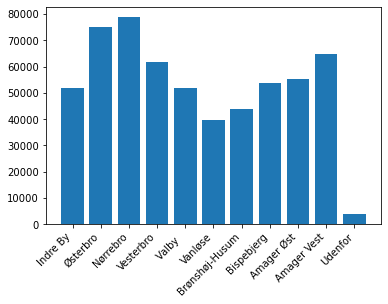

{1: 'Indre By', 2: 'Østerbro', 3: 'Nørrebro', 4: 'Vesterbro', 5: 'Valby  ', 6: 'Vanløse', 7: 'Brønshøj-Husum', 8: 'Bispebjerg', 9: 'Amager Øst', 10: 'Amager Vest', 99: 'Udenfor'}


In [42]:
# Ex 1.4 Make a bar plot to show the size of each city area from the smallest to the largest

import matplotlib.pyplot as plt

plotted = dict(population.items())
plt.bar(plotted.keys(), plotted.values())
plt.xticks(rotation=45, horizontalalignment='right', fontweight='light')
plt.show()
print(neighb)

In [55]:
# Ex 1.5 Create a boolean mask to find out how many people above 65 years lived in Copenhagen in 2015
senior_mask = ((dd[:,0] == 2015) & (dd[:,2] > 65))

print(senior_mask)

seniors = np.sum(dd[senior_mask][:,4])

print("Number of people above 65 years old in Copenhagen in 2015: \t", seniors)

[False False False ... False False False]
Number of people above 65 years old in Copenhagen in 2015: 	 55750


In [86]:
# Ex 1.6 How many of those were from the other nordic countries (not dk)

nordic_countries = [5104, 5110, 5120] # Finland, Norge, Sverige

people = 0

for country in nordic_countries:
    nordic_mask = dd[senior_mask][:,3] == country
    people += np.sum(dd[senior_mask][nordic_mask][:,4])
    
print(int(people), "number of people were from other nordic countries (not dk) above 65 in 2015 in Copenhagen.")

575 number of people were from other nordic countries (not dk) above 65 in 2015 in Copenhagen.


In [ ]:
# Ex 1.7 Make a line plot showing the changes of number of people in vesterbro and østerbro from 1992 to 2015


## Exercise 2